In [129]:
import sys
import shutil
import os
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import flopy

In [130]:
# Path to the MODFLOW 6 repository
mf6path = '../../../modflow6-fork.git'
assert os.path.isdir(mf6path)

In [131]:
swtexe = 'swt_v4'

In [132]:
def get_model(ws, name, nlay=52, ncol=106,
              constant_concentration=False, 
              general_head_boundary=False,
              mixelm=0):
    
    # model units are in cm/min

    lx = 53.
    lz = 26.

    nrow = 1
    delr = lx / ncol
    delc = 1.
    top = 26.
    delz = lz / nlay
    botm = list(top - np.arange(delz, nlay * delz + delz, delz))

    hk = 1050 # m/d
    hk = hk * 100. / 24. / 60. # cm/min

    perlen = [60, 80, 60] # time is in minutes
    nper = len(perlen)
    nstp = [k * 60 for k in perlen]
    tsmult = nper * [1.]
    steady = nper * [True]

    nouter, ninner = 100, 300
    hclose, rclose, relax = 1e-4, 1e-2, 0.97
    
    m = flopy.seawat.Seawat(model_ws=ws, exe_name=swtexe, modelname=name)
    dis = flopy.modflow.ModflowDis(m, nlay=nlay, nrow=nrow, ncol=ncol,
                                   delr=delr, delc=delc,
                                   top=top, botm=botm, nper=nper, 
                                   perlen=perlen, nstp=nstp, tsmult=tsmult)
    bas = flopy.modflow.ModflowBas(m, ibound=1, strt=26)
    lpf = flopy.modflow.ModflowLpf(m, hk=hk, vka=hk)
    
    drhodc = 0.7
    denseref = 1.0
    csalt = 0.0371
    vdf = flopy.seawat.SeawatVdf(m, denseref=denseref, drhodc=drhodc, 
                                 densemin=0., densemax=0.)
    
    itype = flopy.mt3d.Mt3dSsm.itype_dict()
    if constant_concentration:
        ssmitype = itype['CC']
    elif general_head_boundary:
        ssmitype = itype['GHB']
    else:
        ssmitype = itype['CHD']
    
    ssm_data = {}
    ssm_sp1 = []
    chdspd = {}
    chdlist_left = []
    cond = hk * delz * delc / (delr / 2.)
    seawater_density = 1. + drhodc * csalt
    freshwater_density = 1.0
    
    for k in range(nlay):
        if general_head_boundary:
            chdlist_left.append([k, 0, 0, 25.5, cond, seawater_density])
        else:
            chdlist_left.append([k, 0, 0, 25.5, 25.5, 1, seawater_density])
        ssm_sp1.append([k, 0, 0, csalt, ssmitype])
    ssm_data[0] = ssm_sp1
    
    for iper, chdvalue in enumerate([26.7, 26.2, 26.55]):
        chdlist_right = []
        for k in range(nlay):
            if general_head_boundary:
                chdlist_right.append([k, 0, ncol - 1, chdvalue, cond, freshwater_density])
            else:
                chdlist_right.append([k, 0, ncol - 1, chdvalue, chdvalue, 1, freshwater_density])
        chdspd[iper] = chdlist_left + chdlist_right

    if general_head_boundary:
        options = ['AUX', 'GHBDENS']
        dt = flopy.modflow.ModflowGhb.get_default_dtype()
        dt = flopy.pakbase.Package.add_to_dtype(dt, ['GHBDENS'], np.float32)
        ghb = flopy.modflow.ModflowGhb(m, stress_period_data=chdspd, 
                                       dtype=dt, options=options)
    else:
        options = ['AUX', 'CHDDENSOPT', 'AUX', 'CHDDEN']
        dt = flopy.modflow.ModflowChd.get_default_dtype()
        dt = flopy.pakbase.Package.add_to_dtype(dt, ['CHDDENSOPT', 'CHDDEN'], np.float32)
        chd = flopy.modflow.ModflowChd(m, stress_period_data=chdspd, 
                                       dtype=dt, options=options)
    
    pcg = flopy.modflow.ModflowPcg(m, hclose=1.e-8)
    oc = flopy.modflow.ModflowOc(m, 
                                 stress_period_data={(0, 0): ['save head', 'save budget']},
                                 compact=True)

    timprs = [[60], [5, 15, 55, 80], [10, 15, 25, 60]]
    simtime = 0
    printtimes = []
    for t in timprs:
        for t2 in t:
            printtimes.append(simtime + t2)
        simtime += t[-1]
    
    sconcmod = np.zeros((nlay, nrow, ncol))
    sconcmod[:, 0, 0] = csalt
    
    btn = flopy.mt3d.Mt3dBtn(m, prsity=0.385, sconc=sconcmod, ifmtcn=0,
                             chkmas=False, nprobs=10, nprmas=10, dt0=1/60.,
                             nprs=len(printtimes), timprs=printtimes)
    adv = flopy.mt3d.Mt3dAdv(m, mixelm=mixelm)
    #dsp = flopy.mt3d.Mt3dDsp(m, al=0., trpt=1., trpv=1., dmcoef=dmcoef)
    gcg = flopy.mt3d.Mt3dGcg(m, iter1=500, mxiter=1, isolve=1, cclose=1e-7)
    ssm = flopy.mt3d.Mt3dSsm(m, stress_period_data=ssm_data)
    
    return m
    

# SEAWAT Upstream-Weighted GHB

In [133]:
ws = 'temp/pxx_goswami_seawat_ghb_up'
name = 'gswt'
gfact = 1
swt = get_model(ws, name, nlay=gfact*52, ncol=gfact*106,
                general_head_boundary=True)
swt.write_input()
fname = os.path.join(ws, 'MT3D001.UCN')
if os.path.isfile(fname):
    os.remove(fname)
swt.run_model()

FloPy is using the following  executable to run the model: /Users/langevin/langevin/bin/mac/swt_v4

                                  SEAWAT Version 4
    U.S. GEOLOGICAL SURVEY MODULAR FINITE-DIFFERENCE GROUND-WATER FLOW MODEL
                             Version 4.00.05 10/19/2012                      

Incorporated MODFLOW Version: 1.18.01 06/20/2008                      
Incorporated MT3DMS  Version: 5.20    10/30/2006                      


 This program is public domain and is released on the
 condition that neither the U.S. Geological Survey nor
 the United States Government may be held liable for any
 damages resulting from their authorized or unauthorized
 use.


 Using NAME file: gswt.nam                                                                                                                                                                                                
 Run start date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:12:15


 STRESS PERIOD NO.    1

  ST


  STRESS PERIOD    1 TIME STEP   15 FROM TIME =  0.23333     TO   0.25000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.25000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4025E-01  [K,I,J]   52    1    4
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2538E-02  [K,I,J]   48    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2064E-03  [K,I,J]   49    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2204E-04  [K,I,J]   50    1    3
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2680E-05  [K,I,J]   50    1    3
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4488E-06  [K,I,J]   50    1    5
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.4059E-07  [K,I,J]   51    1    6

  STRESS PERIOD    1 TIME STEP   16 FROM TIME =  0.25000     TO   0.26667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.26667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3788E-01  [K,I,J]   52    1    4
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2575E-01  [K,I,J]   52    1    7
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1063E-02  [K,I,J]   42    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6583E-04  [K,I,J]   44    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5466E-05  [K,I,J]   39    1    2
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1314E-05  [K,I,J]   44    1    2
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1834E-06  [K,I,J]   35    1    2
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.2203E-07  [K,I,J]   35    1    1

  STRESS PERIOD    1 TIME STEP   34 FROM TIME =  0.55000     TO   0.56667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.56667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2541E-01  [K,I,J]   52    1    7
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1028E-02  [K,I,J]   42    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6206E-04  [K,I,J]   44    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2026E-01  [K,I,J]   52    1    9
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6255E-03  [K,I,J]   40    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4683E-04  [K,I,J]   36    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5207E-05  [K,I,J]   38    1    2
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6980E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1852E-06  [K,I,J]   35    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.1105E-07  [K,I,J]   33    1    2

  STRESS PERIOD    1 TIME STEP   53 FROM TIME =  0.86667     TO   0.88333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.88333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2003E-01  [K,I,J]   52    1    9
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6047E-03  [K,I,J]   40    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4622E-04  [K,I,J]   36    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   52    1   11
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4297E-03  [K,I,J]   37    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5688E-04  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3326E-05  [K,I,J]   37    1    3
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3621E-06  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9667E-07  [K,I,J]   28    1    1

  STRESS PERIOD    1 TIME STEP   72 FROM TIME =   1.1833     TO    1.2000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   52    1   11
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4089E-03  [K,I,J]   37    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5862E-04  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3301E-05  [K,I,J]   37    1    3
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-01  [K,I,J]   52    1   12
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8392E-05  [K,I,J]   38    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3402E-03  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2240E-05  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6979E-06  [K,I,J]   28    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3039E-07  [K,I,J]   27    1    1

  STRESS PERIOD    1 TIME STEP   92 FROM TIME =   1.5167     TO    1.5333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.5333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1501E-01  [K,I,J]   52    1   12
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1788E-03  [K,I,J]   36    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5145E-03  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2037E-05  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3375E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6382E-04  [K,I,J]   39    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2122E-05  [K,I,J]   36    1    3
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3785E-06  [K,I,J]   36    1    3
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1604E-07  [K,I,J]   33    1    1

  STRESS PERIOD    1 TIME STEP  112 FROM TIME =   1.8500     TO    1.8667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1414E-01  [K,I,J]   52    1   14
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3329E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6010E-04  [K,I,J]   39    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2104E-05  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3561E-06  [K,I,J]   36    1    3
 Outer Iter.  1  Inner Iter.  6:  Max. D


  STRESS PERIOD    1 TIME STEP  132 FROM TIME =   2.1833     TO    2.2000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.2000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1342E-01  [K,I,J]   52    1   15
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2750E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3253E-04  [K,I,J]   37    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2048E-05  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2070E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2336E-07  [K,I,J]   24    1    1

  STRESS PERIOD    1 TIME STEP  133 FROM TIME =   2.2000     TO    2.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1338E-01  [K,I,J]   52    1   15
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2724E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    1 TIME STEP  152 FROM TIME =   2.5167     TO    2.5333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.5333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1277E-01  [K,I,J]   52    1   16
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2303E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2221E-04  [K,I,J]   38    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2044E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1145E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2488E-07  [K,I,J]   24    1    1

  STRESS PERIOD    1 TIME STEP  153 FROM TIME =   2.5333     TO    2.5500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.5500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1272E-01  [K,I,J]   52    1   16
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2283E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1225E-01  [K,I,J]   52    1   17
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1938E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1681E-04  [K,I,J]   49    1   16
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2154E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9636E-07  [K,I,J]   24    1    1

  STRESS PERIOD    1 TIME STEP  173 FROM TIME =   2.8667     TO    2.8833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.8833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1222E-01  [K,I,J]   52    1   17
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1925E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1692E-04  [K,I,J]   49    1   16
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2165E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9632E-07  [K,I,J]   24    1    1

  STRESS PERIOD    1 TIME STEP  174 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1171E-01  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1709E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1453E-04  [K,I,J]   48    1   15
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2614E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1343E-06  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3035E-07  [K,I,J]   47    1   15

  STRESS PERIOD    1 TIME STEP  193 FROM TIME =   3.2000     TO    3.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1174E-01  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1699E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1434E-04  [K,I,J]   48    1   15
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2648E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1084E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1518E-03  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9879E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6007E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9969E-07  [K,I,J]   23    1    1

  STRESS PERIOD    1 TIME STEP  214 FROM TIME =   3.5500     TO    3.5667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.5667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1095E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1503E-03  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9334E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6558E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9963E-07  [K,I,J]   23    1    1

  STRESS PERIOD    1 TIME STEP  215 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1052E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1650E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2985E-04  [K,I,J]   51    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1390E-04  [K,I,J]   51    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9513E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  235 FROM TIME =   3.9000     TO    3.9167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.9167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1041E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1641E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2863E-04  [K,I,J]   51    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1255E-04  [K,I,J]   51    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9492E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  236 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1083E-01  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1722E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1642E-04  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3345E-05  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9277E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  257 FROM TIME =   4.2667     TO    4.2833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.2833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1078E-01  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1733E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1623E-04  [K,I,J]   49    1   18
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3194E-05  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9252E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  258 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9734E-02  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1523E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1906E-04  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2803E-05  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9157E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  277 FROM TIME =   4.6000     TO    4.6167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.6167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9842E-02  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1500E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1886E-04  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2735E-05  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9180E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  278 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1004E-01  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1820E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1517E-04  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1878E-05  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9186E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  298 FROM TIME =   4.9500     TO    4.9667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.9667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9968E-02  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1817E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1512E-04  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1866E-05  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9192E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  299 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9436E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1552E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1828E-04  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1677E-05  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4310E-06  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2028E-07  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  319 FROM TIME =   5.3000     TO    5.3167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.3167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9509E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1585E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1805E-04  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1597E-05  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9453E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1851E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1234E-04  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2449E-05  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1223E-05  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8672E-08  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  340 FROM TIME =   5.6500     TO    5.6667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.6667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9390E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1847E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1235E-04  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2286E-05  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7712E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1533E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1618E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1815E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1306E-06  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4245E-07  [K,I,J]   51    1   23

  STRESS PERIOD    1 TIME STEP  361 FROM TIME =   6.0000     TO    6.0167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.0167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7867E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1508E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1637E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1823E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9132E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1766E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1366E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1381E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8979E-07  [K,I,J]   51    1   23

  STRESS PERIOD    1 TIME STEP  382 FROM TIME =   6.3500     TO    6.3667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.3667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9103E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1770E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1335E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1341E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8769E-07  [K,I,J]   51    1   23

  STRESS PERIOD    1 TIME STEP  383 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7793E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1643E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1117E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1069E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7265E-07  [K,I,J]   50    1   22

  STRESS PERIOD    1 TIME STEP  404 FROM TIME =   6.7167     TO    6.7333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.7333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7708E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1630E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1145E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1102E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7255E-07  [K,I,J]   50    1   22

  STRESS PERIOD    1 TIME STEP  405 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7479E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1289E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1487E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1501E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8020E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  426 FROM TIME =   7.0833     TO    7.1000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7578E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1319E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1493E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1503E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7880E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  427 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8215E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1594E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1149E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1004E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4450E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  448 FROM TIME =   7.4500     TO    7.4667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.4667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8167E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1592E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1120E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9688E-06  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4259E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  449 FRO


  STRESS PERIOD    1 TIME STEP  470 FROM TIME =   7.8167     TO    7.8333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6778E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1450E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9384E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8275E-06  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5234E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  471 FROM TIME =   7.8333     TO    7.8500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6705E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1440E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9581E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5811E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1148E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1207E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1195E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7516E-07  [K,I,J]   51    1   25

  STRESS PERIOD    1 TIME STEP  493 FROM TIME =   8.2000     TO    8.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5873E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1131E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1213E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1202E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7552E-07  [K,I,J]   51    1   25

  STRESS PERIOD    1 TIME STEP  494 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1358E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1239E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1190E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6258E-07  [K,I,J]   51    1   25

  STRESS PERIOD    1 TIME STEP  515 FROM TIME =   8.5667     TO    8.5833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.5833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7182E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1371E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1237E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1183E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6141E-07  [K,I,J]   51    1   25

  STRESS PERIOD    1 TIME STEP  516 FROM TIME =   8.5833     TO    8.6000    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    1 TIME STEP  537 FROM TIME =   8.9333     TO    8.9500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.9500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6803E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1334E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8035E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6007E-06  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3031E-07  [K,I,J]   50    1   24

  STRESS PERIOD    1 TIME STEP  538 FROM TIME =   8.9500     TO    8.9667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.9667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6744E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1326E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7855E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5471E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1141E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7849E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6767E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4400E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  560 FROM TIME =   9.3167     TO    9.3333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5411E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1133E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7956E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6906E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4475E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  561 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4387E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9353E-04  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9288E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9043E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7152E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  583 FROM TIME =   9.7000     TO    9.7167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.7167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4419E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9249E-04  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9313E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9096E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7241E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  584 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5060E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9648E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9464E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9449E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7251E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  606 FROM TIME =   10.083     TO    10.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5089E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9731E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9458E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9431E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7178E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  607 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5816E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1103E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9089E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8529E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5206E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  629 FROM TIME =   10.467     TO    10.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5856E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1106E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9062E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8470E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5116E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  630 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5632E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1042E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6176E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4561E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3617E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  652 FROM TIME =   10.850     TO    10.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5579E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1035E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6036E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4366E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3668E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  653 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4479E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8899E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5663E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5112E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4609E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  675 FROM TIME =   11.233     TO    11.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4432E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8836E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5733E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5196E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4658E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  676 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3465E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7376E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6508E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6276E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4714E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  698 FROM TIME =   11.617     TO    11.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3425E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7306E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6519E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6298E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4794E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  699 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3096E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5762E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6527E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6429E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5159E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  721 FROM TIME =   12.000     TO    12.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3104E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5693E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6520E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6422E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5117E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  722 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5835E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6329E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6220E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5284E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  743 FROM TIME =   12.367     TO    12.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3275E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5865E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6319E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6211E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5272E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  744 FROM TIME =   12.383     TO    12.400    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3481E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6345E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6088E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5948E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4728E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  766 FROM TIME =   12.750     TO    12.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3492E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6360E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6076E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5929E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4686E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  767 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6588E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5786E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5460E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3795E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  789 FROM TIME =   13.133     TO    13.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3789E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6591E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5772E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5437E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3760E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  790 FROM TIME =   13.150     TO    13.167    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    1 TIME STEP  812 FROM TIME =   13.517     TO    13.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4218E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6424E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5378E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4846E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3248E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  813 FROM TIME =   13.533     TO    13.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4241E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6404E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5358E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4112E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5806E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3829E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3119E-06  [K,I,J]   50    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4020E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  835 FROM TIME =   13.900     TO    13.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4073E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5777E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3744E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3148E-06  [K,I,J]   50    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4111E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  836 FRO


  STRESS PERIOD    1 TIME STEP  858 FROM TIME =   14.283     TO    14.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3249E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5248E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3554E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3770E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5730E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  859 FROM TIME =   14.300     TO    14.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3217E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5228E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3592E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2579E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4759E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3952E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4592E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8099E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  882 FROM TIME =   14.683     TO    14.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2553E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4736E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3954E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4605E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8182E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  883 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2024E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4162E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3859E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4606E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8646E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  906 FROM TIME =   15.083     TO    15.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2004E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4135E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3852E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4596E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8615E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  907 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1631E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3507E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3643E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4261E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7191E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  930 FROM TIME =   15.483     TO    15.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1630E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3480E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3634E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4243E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7112E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  931 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1602E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2968E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3405E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3824E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5359E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  954 FROM TIME =   15.883     TO    15.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1601E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2974E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3395E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3806E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5290E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  955 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3087E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3174E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3416E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3943E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  978 FROM TIME =   16.283     TO    16.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3090E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3164E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3401E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3895E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  979 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1539E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3142E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2959E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3066E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2988E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1002 FROM TIME =   16.683     TO    16.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1537E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3143E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2951E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3052E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2957E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1003 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1513E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3132E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2765E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2763E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2265E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1026 FROM TIME =   17.083     TO    17.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1512E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3130E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2758E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2752E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2245E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1027 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1495E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3066E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2591E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2504E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1915E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1050 FROM TIME =   17.483     TO    17.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1494E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3062E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2584E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2494E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1908E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1051 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1485E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2961E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2434E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2278E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1760E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1074 FROM TIME =   17.883     TO    17.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1485E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2956E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2427E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2269E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1754E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1075 FRO


  STRESS PERIOD    1 TIME STEP 1096 FROM TIME =   18.250     TO    18.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1486E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2821E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2298E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2089E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1632E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1097 FROM TIME =   18.267     TO    18.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1487E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2814E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2292E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1497E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2647E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2181E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1928E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1521E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1119 FROM TIME =   18.633     TO    18.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1498E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2637E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2176E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1921E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1515E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1120 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2388E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2068E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1771E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1380E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1143 FROM TIME =   19.033     TO    19.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1525E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2377E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2063E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1765E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1375E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1144 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2102E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1964E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1634E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1246E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1168 FROM TIME =   19.450     TO    19.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2090E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1960E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1629E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1241E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1169 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1633E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1996E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1871E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1515E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1212E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1193 FROM TIME =   19.867     TO    19.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1636E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1994E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1868E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1510E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1213E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1194 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1945E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1785E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1408E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1251E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1218 FROM TIME =   20.283     TO    20.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1943E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1782E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1404E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1253E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1219 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1874E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1701E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1392E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1292E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1243 FROM TIME =   20.700     TO    20.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1871E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1698E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1395E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1294E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1244 FROM TIME =   20.717     TO    20.733    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2035E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1775E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1612E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1543E-06  [K,I,J]   50    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1329E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1268 FROM TIME =   21.117     TO    21.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2044E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1770E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1609E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1552E-06  [K,I,J]   50    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1331E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1269 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1958E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1613E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1514E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2098E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1194E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1289 FROM TIME =   21.467     TO    21.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1941E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1613E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1526E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2240E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1061E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP 1290 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1621E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1685E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1674E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3252E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1044E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1311 FROM TIME =   21.833     TO    21.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1687E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1692E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3282E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1025E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1312 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1340E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1630E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1737E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3012E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8975E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1334 FROM TIME =   22.217     TO    22.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1330E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1625E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1732E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2982E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8963E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1335 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1102E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1453E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1567E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2377E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8181E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1359 FROM TIME =   22.633     TO    22.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1094E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1445E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1560E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2356E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8137E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1360 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9108E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1253E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1378E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1928E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6973E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1385 FROM TIME =   23.067     TO    23.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9044E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1246E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1371E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1914E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6926E-08  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1386 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1094E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1226E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1642E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6836E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1408 FROM TIME =   23.450     TO    23.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7717E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1089E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1220E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1631E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6847E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1409 FROM TIME =   23.467     TO    23.483    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6552E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9790E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1076E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1393E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7087E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1434 FROM TIME =   23.883     TO    23.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6510E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9748E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1070E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1384E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7097E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1435 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5570E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8755E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9471E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1194E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7359E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1460 FROM TIME =   24.317     TO    24.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5536E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8717E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9426E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1187E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7371E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1461 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4768E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7829E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8380E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1027E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7733E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1486 FROM TIME =   24.750     TO    24.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4740E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7795E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8342E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1021E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7750E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1487 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4082E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6979E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7425E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8759E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1513 FROM TIME =   25.200     TO    25.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4059E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6949E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7393E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8707E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1514 FROM TIME =   25.217     TO    25.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.233    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3514E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6227E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6636E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7546E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1540 FROM TIME =   25.650     TO    25.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3495E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6201E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6609E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7504E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1541 FROM TIME =   25.667     TO    25.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.683    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3024E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5543E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5947E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6378E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1568 FROM TIME =   26.117     TO    26.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3009E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5521E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5924E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6337E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1569 FROM TIME =   26.133     TO    26.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2614E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4938E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5365E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5274E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1596 FROM TIME =   26.583     TO    26.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2600E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4918E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5346E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5236E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1597 FROM TIME =   26.600     TO    26.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.617    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2266E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4399E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4877E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4235E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1624 FROM TIME =   27.050     TO    27.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2254E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4381E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4861E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4198E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1625 FROM TIME =   27.067     TO    27.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2055E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3914E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4462E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3025E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1652 FROM TIME =   27.517     TO    27.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2049E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3898E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4448E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2970E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1653 FROM TIME =   27.533     TO    27.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1877E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3591E-05  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4105E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2466E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1680 FROM TIME =   27.983     TO    28.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1870E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3581E-05  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4092E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6033E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1681 FROM TIME =   28.000     TO    28.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.017    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3345E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3796E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1020E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6285E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1707 FROM TIME =   28.433     TO    28.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3341E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3784E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9627E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1708 FROM TIME =   28.450     TO    28.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.467    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1561E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3237E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3500E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5366E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1735 FROM TIME =   28.900     TO    28.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1556E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3232E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3490E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5306E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1736 FROM TIME =   28.917     TO    28.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3106E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3221E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4316E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1763 FROM TIME =   29.367     TO    29.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1413E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3101E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3211E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4289E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1764 FROM TIME =   29.383     TO    29.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1408E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1281E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2951E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2944E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3704E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1792 FROM TIME =   29.850     TO    29.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1276E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2946E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2934E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3687E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1793 FROM TIME =   29.867     TO    29.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.883    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3251E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1821 FROM TIME =   30.333     TO    30.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1150E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2777E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2671E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3238E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1822 FROM TIME =   30.350     TO    30.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1146E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2771E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2662E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP 1850 FROM TIME =   30.817     TO    30.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1035E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2601E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2421E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2865E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1851 FROM TIME =   30.833     TO    30.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1031E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2595E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2413E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2852E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1852 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9304E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2423E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2189E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2542E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1880 FROM TIME =   31.317     TO    31.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9269E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2416E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2181E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2531E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1881 FROM TIME =   31.333     TO    31.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8315E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2239E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1966E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2247E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1910 FROM TIME =   31.817     TO    31.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8283E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2233E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1958E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2238E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1911 FROM TIME =   31.833     TO    31.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7421E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2060E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1762E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1988E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1940 FROM TIME =   32.317     TO    32.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7394E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2055E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1756E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1980E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1941 FROM TIME =   32.333     TO    32.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6619E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1889E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1578E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1760E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1970 FROM TIME =   32.817     TO    32.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6591E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1883E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1572E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1752E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1971 FROM TIME =   32.833     TO    32.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2000 FROM TIME =   33.317     TO    33.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5872E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1720E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1405E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1552E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2001 FROM TIME =   33.333     TO    33.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5852E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1716E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1401E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1547E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2002 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5228E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1567E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1256E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1375E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2031 FROM TIME =   33.833     TO    33.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5204E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1561E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1250E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1368E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2032 FROM TIME =   33.850     TO    33.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4648E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1422E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1121E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1218E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2061 FROM TIME =   34.333     TO    34.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4627E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1416E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1116E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1212E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2062 FROM TIME =   34.350     TO    34.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.367    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2092 FROM TIME =   34.850     TO    34.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4097E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1278E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9913E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2093 FROM TIME =   34.867     TO    34.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4085E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1275E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9888E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2094 FROM TIME =   34.883     TO    34.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.900    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3613E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1147E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8773E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2125 FROM TIME =   35.400     TO    35.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3596E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1142E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8731E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2126 FROM TIME =   35.417     TO    35.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3584E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1139E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3186E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1028E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7761E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2157 FROM TIME =   35.933     TO    35.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3169E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1022E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7717E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2158 FROM TIME =   35.950     TO    35.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3157E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1019E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2804E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9161E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6846E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2189 FROM TIME =   36.467     TO    36.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2792E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9128E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6819E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2190 FROM TIME =   36.483     TO    36.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2781E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9096E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8160E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6043E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2221 FROM TIME =   37.000     TO    37.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2459E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8132E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6020E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2222 FROM TIME =   37.017     TO    37.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2449E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8103E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5997E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2223 FRO


  STRESS PERIOD    1 TIME STEP 2254 FROM TIME =   37.550     TO    37.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2159E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7213E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5298E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2255 FROM TIME =   37.567     TO    37.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2147E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7174E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5268E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2256 FROM TIME =   37.583     TO    37.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6406E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4676E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2287 FROM TIME =   38.100     TO    38.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1892E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6375E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4653E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2288 FROM TIME =   38.117     TO    38.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6370E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4648E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2289 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1661E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5639E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4092E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2321 FROM TIME =   38.667     TO    38.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1655E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5622E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4079E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2322 FROM TIME =   38.683     TO    38.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1646E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5591E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    1 TIME STEP 2354 FROM TIME =   39.217     TO    39.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1451E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4959E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3580E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2355 FROM TIME =   39.233     TO    39.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1448E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4952E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3574E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2356 FROM TIME =   39.250     TO    39.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.267    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1276E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4385E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3154E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2388 FROM TIME =   39.783     TO    39.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1268E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4357E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3134E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2389 FROM TIME =   39.800     TO    39.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1266E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4350E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1115E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3846E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2757E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2422 FROM TIME =   40.350     TO    40.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1111E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3834E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2748E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2423 FROM TIME =   40.367     TO    40.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1107E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3820E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9677E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3353E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2396E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2458 FROM TIME =   40.950     TO    40.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9662E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3348E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2394E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2459 FROM TIME =   40.967     TO    40.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9599E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3328E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

  STRESS PERIOD    1 TIME STEP 2494 FROM TIME =   41.550     TO    41.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8391E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2915E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2080E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2495 FROM TIME =   41.567     TO    41.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8362E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2905E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2073E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2496 FROM TIME =   41.583     TO    41.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7246E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2520E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1797E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2532 FROM TIME =   42.183     TO    42.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7227E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2514E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1793E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2533 FROM TIME =   42.200     TO    42.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7197E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2503E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    1 TIME STEP 2568 FROM TIME =   42.783     TO    42.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6310E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2194E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1567E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2569 FROM TIME =   42.800     TO    42.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6334E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2179E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1585E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2570 FROM TIME =   42.817     TO    42.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5467E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1878E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1368E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2607 FROM TIME =   43.433     TO    43.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5417E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1883E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1344E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2608 FROM TIME =   43.450     TO    43.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5438E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1866E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    1 TIME STEP 2646 FROM TIME =   44.083     TO    44.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4634E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1608E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1148E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2647 FROM TIME =   44.100     TO    44.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4659E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1598E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1164E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2648 FROM TIME =   44.117     TO    44.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4056E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1404E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1005E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2683 FROM TIME =   44.700     TO    44.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4071E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1391E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1018E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2684 FROM TIME =   44.717     TO    44.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4053E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1400E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3492E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1204E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8661E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2723 FROM TIME =   45.367     TO    45.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3499E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1190E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8762E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2724 FROM TIME =   45.383     TO    45.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3449E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1191E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2992E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1032E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7391E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2762 FROM TIME =   46.017     TO    46.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3000E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1021E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7475E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2763 FROM TIME =   46.033     TO    46.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2980E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1026E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2525E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8670E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2805 FROM TIME =   46.733     TO    46.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2534E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8600E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2806 FROM TIME =   46.750     TO    46.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2548E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8609E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2807 FROM TIME =   46.767     TO    46.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.783    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2135E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7295E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2852 FROM TIME =   47.517     TO    47.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2141E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7172E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2853 FROM TIME =   47.533     TO    47.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2139E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6996E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2854 FROM TIME =   47.550     TO    47.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1756E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5956E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2901 FROM TIME =   48.333     TO    48.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1764E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5873E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2902 FROM TIME =   48.350     TO    48.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1767E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5768E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2903 FROM TIME =   48.367     TO    48.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.383    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2951 FROM TIME =   49.167     TO    49.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1488E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4709E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2952 FROM TIME =   49.183     TO    49.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1492E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4657E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2953 FROM TIME =   49.200     TO    49.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1470E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4965E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2954 FRO


  STRESS PERIOD    1 TIME STEP 3000 FROM TIME =   49.983     TO    50.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1214E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3942E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3001 FROM TIME =   50.000     TO    50.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1217E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3879E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3002 FROM TIME =   50.017     TO    50.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1222E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3840E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3003 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1027E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3114E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3054 FROM TIME =   50.883     TO    50.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1030E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3079E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3055 FROM TIME =   50.900     TO    50.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1034E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3068E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3056 FROM TIME =   50.917     TO    50.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8719E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2792E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3107 FROM TIME =   51.767     TO    51.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8695E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2728E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3108 FROM TIME =   51.783     TO    51.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8683E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2675E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3109 FROM TIME =   51.800     TO    51.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3161 FROM TIME =   52.667     TO    52.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3162 FROM TIME =   52.683     TO    52.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3163 FROM TIME =   52.700     TO    52.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3164 FROM TIME =   52.717     TO    52.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3165 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6644E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2169E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3220 FROM TIME =   53.650     TO    53.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3221 FROM TIME =   53.667     TO    53.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3222 FROM TIME =   53.683     TO    53.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3223 FROM TIME =   53.700     TO    53.717    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    1 TIME STEP 3283 FROM TIME =   54.700     TO    54.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3284 FROM TIME =   54.717     TO    54.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3285 FROM TIME =   54.733     TO    54.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3286 FROM TIME =   54.750     TO    54.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3287 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3348 FROM TIME =   55.783     TO    55.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3349 FROM TIME =   55.800     TO    55.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3350 FROM TIME =   55.817     TO    55.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3351 FROM TIME =   55.833     TO    55.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3412 FROM TIME =   56.850     TO    56.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3413 FROM TIME =   56.867     TO    56.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3414 FROM TIME =   56.883     TO    56.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3415 FROM TIME =   56.900     TO    56.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.917    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3476 FROM TIME =   57.917     TO    57.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3477 FROM TIME =   57.933     TO    57.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3478 FROM TIME =   57.950     TO    57.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3479 FROM TIME =   57.967     TO    57.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3480 FRO


  STRESS PERIOD    1 TIME STEP 3541 FROM TIME =   59.000     TO    59.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3542 FROM TIME =   59.017     TO    59.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3543 FROM TIME =   59.033     TO    59.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3544 FROM TIME =   59.050     TO    59.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3545 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1
 Transport Step:    2   Step Size:  1.6667E-02 Total Elapsed Time:   60.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5066E-01  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2277E-02  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2576E-03  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3557E-04  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6404E-06  [K,I,J]   51    1   30
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1357E-06  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.1309E-07  [K,I,J]   22    1    1

  STRESS PERIOD    2 TIME STEP    2 FROM TIME =   60.017     TO    60.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4799E-01  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2272E-01  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7118E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1351E-03  [K,I,J]   24    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5781E-05  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4041E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5915E-07  [K,I,J]   21    1    1

  STRESS PERIOD    2 TIME STEP   21 FROM TIME =   60.333     TO    60.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2250E-01  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6659E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1373E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5381E-05  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3780E-04  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3940E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2515E-05  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2533E-06  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3262E-07  [K,I,J]   20    1    1

  STRESS PERIOD    2 TIME STEP   41 FROM TIME =   60.667     TO    60.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1768E-01  [K,I,J]   52    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5832E-04  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4913E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2374E-05  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2869E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1563E-01  [K,I,J]   52    1   32
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4257E-03  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1053E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2505E-05  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2538E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4818E-07  [K,I,J]   21    1    1

  STRESS PERIOD    2 TIME STEP   61 FROM TIME =   61.000     TO    61.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1554E-01  [K,I,J]   52    1   32
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4153E-03  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9685E-04  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2432E-05  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP   80 FROM TIME =   61.317     TO    61.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1437E-01  [K,I,J]   52    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3085E-03  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5053E-04  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2106E-05  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1649E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3899E-07  [K,I,J]   12    1    1

  STRESS PERIOD    2 TIME STEP   81 FROM TIME =   61.333     TO    61.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1429E-01  [K,I,J]   52    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3056E-03  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1357E-01  [K,I,J]   52    1   34
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2537E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2701E-04  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1813E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1569E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2653E-07  [K,I,J]   12    1    1

  STRESS PERIOD    2 TIME STEP  100 FROM TIME =   61.650     TO    61.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1353E-01  [K,I,J]   52    1   34
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2516E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2617E-04  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1812E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1293E-01  [K,I,J]   52    1   35
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2136E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1863E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1796E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9844E-07  [K,I,J]   12    1    1

  STRESS PERIOD    2 TIME STEP  120 FROM TIME =   61.983     TO    62.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1292E-01  [K,I,J]   52    1   35
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2119E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1885E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1797E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9784E-07  [K,I,J]   12    1    1

  STRESS PERIOD    2 TIME STEP  121 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1821E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9290E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  140 FROM TIME =   62.317     TO    62.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1241E-01  [K,I,J]   52    1   36
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1854E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1478E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1824E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9292E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  141 FROM TIME =   62.333     TO    62.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1240E-01  [K,I,J]   52    1   36
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1636E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1215E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1943E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9367E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  160 FROM TIME =   62.650     TO    62.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1191E-01  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1625E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1198E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1951E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9387E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  161 FROM TIME =   62.667     TO    62.683    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1134E-01  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1427E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1024E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2223E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9519E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  181 FROM TIME =   63.000     TO    63.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1141E-01  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1419E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1016E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2244E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9553E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  182 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1065E-01  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1285E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7508E-05  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3062E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9514E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  201 FROM TIME =   63.333     TO    63.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1071E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1278E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7456E-05  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3140E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9561E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  202 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1072E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1160E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1257E-04  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2163E-04  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4705E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  222 FROM TIME =   63.683     TO    63.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1062E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1154E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2099E-04  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2998E-04  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5497E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  223 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1075E-01  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1039E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1522E-04  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6895E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7608E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  243 FROM TIME =   64.033     TO    64.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1069E-01  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1034E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1502E-04  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6641E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7606E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  244 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1063E-01  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9449E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1061E-04  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2760E-05  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7615E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  264 FROM TIME =   64.383     TO    64.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1062E-01  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9407E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1036E-04  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2663E-05  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7614E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  265 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1023E-01  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8623E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9366E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1793E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7521E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  285 FROM TIME =   64.733     TO    64.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1028E-01  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8587E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9320E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1766E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7518E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  286 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9597E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7947E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8657E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1368E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7457E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  305 FROM TIME =   65.067     TO    65.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9502E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7918E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8568E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1352E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7447E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  306 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9911E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7374E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7736E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1016E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7391E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  326 FROM TIME =   65.417     TO    65.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9858E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7348E-04  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7825E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1020E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7401E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  327 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9853E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6829E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7057E-05  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9589E-06  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7183E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  347 FROM TIME =   65.767     TO    65.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9860E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6807E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6985E-05  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9530E-06  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7169E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  348 FRO

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7349E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  368 FROM TIME =   66.117     TO    66.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9226E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6344E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7145E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8229E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7379E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  369 FROM TIME =   66.133     TO    66.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9302E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6323E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9339E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6989E-04  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7170E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7903E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7218E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  389 FROM TIME =   66.467     TO    66.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9281E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6992E-04  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7226E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7988E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7215E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  390 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9387E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5735E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5727E-05  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6163E-06  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8077E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  410 FROM TIME =   66.817     TO    66.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9395E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5902E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5682E-05  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6110E-06  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8152E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  411 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6546E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6855E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6653E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8259E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  431 FROM TIME =   67.167     TO    67.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8564E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6437E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6785E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6594E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8257E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  432 FROM TIME =   67.183     TO    67.200    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6647E-04  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6210E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4760E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1294E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8110E-08  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  452 FROM TIME =   67.517     TO    67.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9013E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6723E-04  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6320E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4772E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1402E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8741E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5695E-04  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5968E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1432E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2021E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7611E-08  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  473 FROM TIME =   67.867     TO    67.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8785E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5542E-04  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5845E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1339E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8529E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6836E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6483E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1850E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1229E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7186E-08  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  494 FROM TIME =   68.217     TO    68.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8470E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6840E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6522E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1761E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8660E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5368E-04  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5190E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6058E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1141E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.6644E-08  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  515 FROM TIME =   68.567     TO    68.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8673E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5332E-04  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5057E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5871E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP  536 FROM TIME =   68.917     TO    68.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7965E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6677E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6358E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7191E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1208E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.6225E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  537 FROM TIME =   68.933     TO    68.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7895E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6632E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    2 TIME STEP  557 FROM TIME =   69.267     TO    69.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8437E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5585E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4755E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4851E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6390E-07  [K,I,J]   51    1   50

  STRESS PERIOD    2 TIME STEP  558 FROM TIME =   69.283     TO    69.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8429E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5722E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4903E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7578E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6508E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6108E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6246E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6547E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  579 FROM TIME =   69.633     TO    69.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7528E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6452E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6075E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6207E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6460E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  580 FRO


  STRESS PERIOD    2 TIME STEP  600 FROM TIME =   69.983     TO    70.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8168E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5733E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4850E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4534E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3972E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  601 FROM TIME =   70.000     TO    70.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8153E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5851E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4980E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7305E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6371E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5881E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5808E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5330E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  622 FROM TIME =   70.350     TO    70.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7377E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6314E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5842E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5769E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5290E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  623 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7918E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5483E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4523E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4050E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8523E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  644 FROM TIME =   70.717     TO    70.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7902E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5643E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4694E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4236E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1984E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7073E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6303E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5672E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5291E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2636E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  666 FROM TIME =   71.083     TO    71.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7141E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6252E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5633E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5247E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2617E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  667 FRO


  STRESS PERIOD    2 TIME STEP  687 FROM TIME =   71.433     TO    71.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7680E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5021E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4064E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3587E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1208E-07  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  688 FROM TIME =   71.450     TO    71.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7668E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5176E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4159E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6945E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6326E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5598E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5264E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2619E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  709 FROM TIME =   71.800     TO    71.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6890E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6294E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5581E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5253E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2608E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  710 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7445E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5001E-04  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4276E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3763E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1850E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  731 FROM TIME =   72.167     TO    72.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7446E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4963E-04  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4195E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3670E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1845E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  732 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6912E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6302E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5404E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4896E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2363E-07  [K,I,J]   51    1   55

  STRESS PERIOD    2 TIME STEP  753 FROM TIME =   72.533     TO    72.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6866E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6298E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5413E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4906E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2366E-07  [K,I,J]   51    1   55

  STRESS PERIOD    2 TIME STEP  754 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7146E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5270E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4528E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4012E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1963E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  775 FROM TIME =   72.900     TO    72.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7161E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5201E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4454E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3920E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1973E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  776 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6921E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5835E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4782E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4250E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2040E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  797 FROM TIME =   73.267     TO    73.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6888E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5932E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4893E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4372E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2114E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  798 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6691E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5686E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4872E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4429E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2235E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  819 FROM TIME =   73.633     TO    73.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6727E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5629E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4814E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4360E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2187E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  820 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6885E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4739E-04  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3407E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2743E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1893E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  841 FROM TIME =   74.000     TO    74.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6868E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4784E-04  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3479E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2859E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1888E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  842 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6189E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6054E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5082E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4586E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2238E-07  [K,I,J]   51    1   57

  STRESS PERIOD    2 TIME STEP  863 FROM TIME =   74.367     TO    74.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6144E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6024E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5065E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4577E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2246E-07  [K,I,J]   51    1   57

  STRESS PERIOD    2 TIME STEP  864 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6687E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4945E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4004E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3437E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1769E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  885 FROM TIME =   74.733     TO    74.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6693E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4890E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3938E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3355E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1771E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  886 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6464E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5038E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3855E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3239E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1788E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  905 FROM TIME =   75.067     TO    75.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6437E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5129E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3950E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3341E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1783E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  906 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6040E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5711E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4766E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4343E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2269E-07  [K,I,J]   51    1   58

  STRESS PERIOD    2 TIME STEP  927 FROM TIME =   75.433     TO    75.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6082E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5663E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4725E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4303E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2252E-07  [K,I,J]   51    1   58

  STRESS PERIOD    2 TIME STEP  928 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6450E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4582E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3514E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2892E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1627E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  949 FROM TIME =   75.800     TO    75.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6446E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4538E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3455E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2817E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1628E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  950 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6040E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5220E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4024E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3419E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1683E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  971 FROM TIME =   76.167     TO    76.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6009E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5287E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4098E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3503E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1677E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  972 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5975E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5397E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4416E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3953E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2053E-07  [K,I,J]   51    1   59

  STRESS PERIOD    2 TIME STEP  993 FROM TIME =   76.533     TO    76.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6004E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5344E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4364E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3899E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2024E-07  [K,I,J]   51    1   59

  STRESS PERIOD    2 TIME STEP  994 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6185E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4437E-04  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3169E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2495E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1519E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1015 FROM TIME =   76.900     TO    76.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6177E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4466E-04  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3117E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2428E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1518E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1016 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5734E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5032E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3833E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3262E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1566E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1037 FROM TIME =   77.267     TO    77.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5703E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5090E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3895E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3324E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1601E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1038 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5758E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5291E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4289E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3846E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2080E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1059 FROM TIME =   77.633     TO    77.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5783E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5235E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4236E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3794E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2054E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1060 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5945E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4351E-04  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3068E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2440E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1385E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1081 FROM TIME =   78.000     TO    78.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5937E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4377E-04  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3018E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2376E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1383E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1082 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5553E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4619E-04  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3387E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2866E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1442E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1103 FROM TIME =   78.367     TO    78.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5526E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4639E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3447E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2928E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1482E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1104 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5362E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5384E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4301E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3819E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2025E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1125 FROM TIME =   78.733     TO    78.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5437E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5398E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4323E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3847E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2050E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1126 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4335E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3188E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2629E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1324E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1147 FROM TIME =   79.100     TO    79.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5718E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4297E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3136E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2565E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1320E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1148 FROM TIME =   79.117     TO    79.133    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5465E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4448E-04  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2669E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2181E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1244E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1169 FROM TIME =   79.467     TO    79.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5444E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4453E-04  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2732E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2244E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1241E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1170 FRO


  STRESS PERIOD    2 TIME STEP 1190 FROM TIME =   79.817     TO    79.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4879E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4887E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3750E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3321E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1863E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1191 FROM TIME =   79.833     TO    79.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4848E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4913E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3781E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5437E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4757E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3685E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3212E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1737E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1212 FROM TIME =   80.183     TO    80.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5446E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4700E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3626E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3148E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1698E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1213 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5410E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4142E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2549E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1892E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1202E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1234 FROM TIME =   80.550     TO    80.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5399E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4158E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2509E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1841E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1197E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1235 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2439E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1294E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1256 FROM TIME =   80.917     TO    80.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4993E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4299E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2924E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2490E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1328E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1257 FROM TIME =   80.933     TO    80.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4969E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1576E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1278 FROM TIME =   81.283     TO    81.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4508E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4727E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3645E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3322E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1665E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1279 FROM TIME =   81.300     TO    81.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4563E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4741E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5250E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4335E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3240E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2804E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1586E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1300 FROM TIME =   81.650     TO    81.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5251E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4287E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3182E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2733E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1528E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1301 FRO

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2215E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1538E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1086E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1322 FROM TIME =   82.017     TO    82.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5090E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4001E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2181E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1493E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1083E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1323 FROM TIME =   82.033     TO    82.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.050    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4049E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2725E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2316E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1254E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1344 FROM TIME =   82.383     TO    82.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4667E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4045E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2764E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2359E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1279E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1345 FROM TIME =   82.400     TO    82.417    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4416E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3335E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3049E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2209E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1366 FROM TIME =   82.750     TO    82.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4194E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4428E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3351E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3069E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2223E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1367 FROM TIME =   82.767     TO    82.783    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1793E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1388 FROM TIME =   83.117     TO    83.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5031E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4232E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3155E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2804E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1733E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1389 FROM TIME =   83.133     TO    83.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5031E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4180E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3794E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2144E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1534E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9950E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1410 FROM TIME =   83.483     TO    83.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4875E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3801E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2110E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1490E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9915E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1411 FROM TIME =   83.500     TO    83.517    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4521E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3829E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2308E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1912E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1024E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1432 FROM TIME =   83.850     TO    83.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4500E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3825E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2345E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1950E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1051E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1433 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3997E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4041E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2943E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2635E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1906E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1455 FROM TIME =   84.233     TO    84.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3973E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4055E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2961E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2658E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1914E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1456 FRO


  STRESS PERIOD    2 TIME STEP 1477 FROM TIME =   84.600     TO    84.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4517E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4213E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3172E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2936E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2138E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1478 FROM TIME =   84.617     TO    84.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4561E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4216E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3173E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4734E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3629E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2338E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1898E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1063E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1500 FROM TIME =   84.983     TO    85.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4725E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3633E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2294E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1842E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1013E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1501 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4428E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3634E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1737E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1392E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8368E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1523 FROM TIME =   85.367     TO    85.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4411E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3631E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1776E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1429E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8344E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1524 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3983E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3538E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2461E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2163E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1562E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1546 FROM TIME =   85.750     TO    85.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3962E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3559E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2483E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2190E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1579E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1547 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3635E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3832E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2808E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2610E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2037E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1569 FROM TIME =   86.133     TO    86.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3669E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3839E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2816E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2620E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2048E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1570 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4458E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3909E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2868E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2659E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1991E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1592 FROM TIME =   86.517     TO    86.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4498E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3910E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2864E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2651E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1973E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1593 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4416E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3450E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1916E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1457E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7488E-08  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1615 FROM TIME =   86.900     TO    86.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4404E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3450E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1882E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1413E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7363E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1616 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4076E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3413E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1736E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1440E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7377E-08  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1638 FROM TIME =   87.283     TO    87.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4059E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3408E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1767E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1471E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7348E-08  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1639 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3645E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3307E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2283E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2037E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1501E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1661 FROM TIME =   87.667     TO    87.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3625E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3321E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2300E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2059E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1527E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1662 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3316E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3514E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2543E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2401E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2020E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1684 FROM TIME =   88.050     TO    88.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3343E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3519E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2549E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2410E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2033E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1685 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3983E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3582E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2593E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2447E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2006E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1707 FROM TIME =   88.433     TO    88.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4016E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3584E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2590E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2441E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1990E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1708 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4221E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3238E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1941E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1590E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1010E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1730 FROM TIME =   88.817     TO    88.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4209E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3236E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1902E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1540E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9693E-08  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1731 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3912E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3177E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1356E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1113E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4909E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1753 FROM TIME =   89.200     TO    89.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3897E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3173E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1387E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1142E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4592E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1754 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3530E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3053E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1919E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1689E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1238E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1776 FROM TIME =   89.583     TO    89.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3512E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3046E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1937E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1709E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1258E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1777 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3115E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3148E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2201E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2048E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1703E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1799 FROM TIME =   89.967     TO    89.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3097E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3154E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2209E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2058E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1720E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1800 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3228E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3232E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2313E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2225E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2019E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1822 FROM TIME =   90.350     TO    90.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3250E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3235E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2315E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2228E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2023E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1823 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3753E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3264E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2301E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2188E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1886E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1843 FROM TIME =   90.700     TO    90.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3782E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3265E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2298E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2181E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1870E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1844 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3940E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3020E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1705E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1396E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9196E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1866 FROM TIME =   91.083     TO    91.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3927E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3016E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1670E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1350E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8748E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1867 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3630E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2927E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1219E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1025E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7444E-08  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1889 FROM TIME =   91.467     TO    91.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3615E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2923E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1247E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1051E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7413E-08  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1890 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3274E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2812E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1701E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1530E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1198E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1912 FROM TIME =   91.850     TO    91.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3258E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2806E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1716E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1548E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1220E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1913 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2902E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2820E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1939E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1843E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1682E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1935 FROM TIME =   92.233     TO    92.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2886E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2826E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1946E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1853E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1701E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1936 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2745E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2899E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2037E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1994E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1986E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1958 FROM TIME =   92.617     TO    92.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2762E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2901E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2039E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1997E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1992E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1959 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3165E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2937E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2047E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1995E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1934E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1981 FROM TIME =   93.000     TO    93.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3185E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2938E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2046E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1991E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1924E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1982 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3701E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2941E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1969E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1853E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1589E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2004 FROM TIME =   93.383     TO    93.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3728E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2939E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1962E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1843E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1570E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2005 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3549E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2709E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1269E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9288E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2027 FROM TIME =   93.767     TO    93.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3536E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2705E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1246E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8979E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2028 FROM TIME =   93.783     TO    93.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.800    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3220E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2627E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1271E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1130E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8815E-08  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2051 FROM TIME =   94.167     TO    94.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3206E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2623E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1290E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1150E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9031E-08  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2052 FRO


  STRESS PERIOD    2 TIME STEP 2074 FROM TIME =   94.550     TO    94.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2873E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2517E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1597E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1514E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1398E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2075 FROM TIME =   94.567     TO    94.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2859E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2511E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1606E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2546E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2526E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1737E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1723E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1844E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2098 FROM TIME =   94.950     TO    94.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2533E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2529E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1741E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1730E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1860E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2099 FRO


  STRESS PERIOD    2 TIME STEP 2121 FROM TIME =   95.333     TO    95.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2444E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2570E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1795E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1828E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2124E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2122 FROM TIME =   95.350     TO    95.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2457E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2572E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1797E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2764E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2600E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1798E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1820E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2055E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2145 FROM TIME =   95.733     TO    95.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2779E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2601E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1797E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1817E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2044E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2146 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2616E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1743E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1702E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1694E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2168 FROM TIME =   96.117     TO    96.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3185E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2616E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1739E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1695E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1676E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2169 FROM TIME =   96.133     TO    96.150    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    2 TIME STEP 2191 FROM TIME =   96.500     TO    96.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3381E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2468E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1334E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1135E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9848E-08  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2192 FROM TIME =   96.517     TO    96.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3368E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2461E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1304E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3082E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2361E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9022E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8070E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2215 FROM TIME =   96.900     TO    96.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3069E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2358E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9234E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8229E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2216 FROM TIME =   96.917     TO    96.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2767E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2280E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1281E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1218E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1145E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2239 FROM TIME =   97.300     TO    97.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2754E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2276E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1291E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1231E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1166E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2240 FRO


  STRESS PERIOD    2 TIME STEP 2262 FROM TIME =   97.683     TO    97.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2459E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2173E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1455E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1459E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1629E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2263 FROM TIME =   97.700     TO    97.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2447E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2177E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1460E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2184E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2225E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1526E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1586E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2012E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2286 FROM TIME =   98.083     TO    98.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2173E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2226E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1528E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1590E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2025E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2287 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2126E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2245E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1554E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1645E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2212E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2310 FROM TIME =   98.483     TO    98.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2135E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2246E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1554E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1646E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2214E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2311 FRO


  STRESS PERIOD    2 TIME STEP 2333 FROM TIME =   98.867     TO    98.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2369E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2265E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1550E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1628E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2120E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2334 FROM TIME =   98.883     TO    98.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2380E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2266E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1550E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2657E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2283E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1514E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1537E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1781E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2357 FROM TIME =   99.267     TO    99.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2672E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2284E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1511E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1532E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1763E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2358 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3051E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2272E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1425E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1377E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1362E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2381 FROM TIME =   99.667     TO    99.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3071E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2270E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1420E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1370E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1345E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2382 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2955E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2127E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9266E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8453E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2405 FROM TIME =   100.07     TO    100.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2943E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2122E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9099E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8464E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2406 FROM TIME =   100.08     TO    100.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2660E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2035E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9448E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9173E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2429 FROM TIME =   100.47     TO    100.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2648E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2032E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9583E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9335E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2430 FROM TIME =   100.48     TO    100.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2376E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1966E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1171E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1214E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1542E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2453 FROM TIME =   100.87     TO    100.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2364E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1963E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1177E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1223E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1565E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2454 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2112E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1885E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1264E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1370E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2034E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2477 FROM TIME =   101.27     TO    101.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2102E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1886E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1267E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1374E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2052E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2478 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1876E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1906E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1301E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1455E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2396E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2501 FROM TIME =   101.67     TO    101.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1867E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1906E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1302E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1457E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2407E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2502 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1765E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1914E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1314E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1485E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2527E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2525 FROM TIME =   102.07     TO    102.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1914E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1314E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1485E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2526E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2526 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1925E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1924E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1310E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1462E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2377E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2549 FROM TIME =   102.47     TO    102.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1933E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1924E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1310E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1460E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2365E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2550 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2117E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1938E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1290E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1394E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2030E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2573 FROM TIME =   102.87     TO    102.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2126E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1938E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1289E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1390E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2013E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2574 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2358E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1948E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1248E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1288E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1617E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2597 FROM TIME =   103.27     TO    103.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2370E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1948E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1245E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1283E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1600E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2598 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2673E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1930E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1171E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1152E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1247E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2621 FROM TIME =   103.67     TO    103.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2688E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1928E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1166E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1146E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1245E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2622 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2672E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1802E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8038E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8847E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2645 FROM TIME =   104.07     TO    104.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2660E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1798E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7879E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8862E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2646 FROM TIME =   104.08     TO    104.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2669 FROM TIME =   104.47     TO    104.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2386E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1721E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7753E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9405E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2670 FROM TIME =   104.48     TO    104.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2375E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1718E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7873E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9416E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2671 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2141E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1712E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9680E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1115E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2020E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2693 FROM TIME =   104.87     TO    104.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2131E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1710E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9731E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1125E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2059E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2694 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1909E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1634E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1047E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1284E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2815E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2717 FROM TIME =   105.27     TO    105.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1900E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1630E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1049E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1288E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2842E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2718 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1705E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1075E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1361E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3274E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2741 FROM TIME =   105.67     TO    105.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1075E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1363E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3288E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2742 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1526E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1586E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1082E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1389E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3452E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2765 FROM TIME =   106.07     TO    106.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1519E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1586E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1082E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1389E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3454E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2766 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1443E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1582E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1080E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1374E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3328E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2789 FROM TIME =   106.47     TO    106.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1447E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1582E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1080E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1373E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3316E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2790 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1541E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1583E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1072E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1319E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2921E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2813 FROM TIME =   106.87     TO    106.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1546E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1583E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1071E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1317E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2900E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2814 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1656E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1057E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1242E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2400E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2837 FROM TIME =   107.27     TO    107.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1661E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1056E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1238E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2378E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2838 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1597E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1033E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1155E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1912E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2861 FROM TIME =   107.67     TO    107.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1801E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1597E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1032E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1152E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1893E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2862 FROM TIME =   107.68     TO    107.70    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1967E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1601E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9980E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1064E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1508E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2885 FROM TIME =   108.07     TO    108.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1975E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1601E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9962E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1060E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1493E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2886 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1587E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9445E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9642E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2909 FROM TIME =   108.47     TO    108.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2198E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1586E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9418E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9597E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2910 FROM TIME =   108.48     TO    108.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2209E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2456E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1505E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8302E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9013E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2934 FROM TIME =   108.88     TO    108.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2444E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1490E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8070E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8991E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2935 FROM TIME =   108.90     TO    108.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.92    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2958 FROM TIME =   109.28     TO    109.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2182E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1393E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7040E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1022E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1953E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2959 FROM TIME =   109.30     TO    109.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2172E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1391E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7049E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1958E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1426E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7353E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1858E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1043E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5224E-09  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 2982 FROM TIME =   109.68     TO    109.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1949E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1427E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7416E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2005E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1411E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8319E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7039E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3006 FROM TIME =   110.08     TO    110.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1740E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1409E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8341E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6542E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3007 FROM TIME =   110.10     TO    110.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1326E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8624E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4286E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3031 FROM TIME =   110.50     TO    110.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1551E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1321E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8629E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4364E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3032 FROM TIME =   110.52     TO    110.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.53    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3055 FROM TIME =   110.90     TO    110.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1395E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1279E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8675E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9642E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3056 FROM TIME =   110.92     TO    110.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1389E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1279E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8675E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1009E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP 3078 FROM TIME =   111.28     TO    111.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1265E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1267E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8639E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3950E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4827E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4843E-09  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 3079 FROM TIME =   111.30     TO    111.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1260E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1267E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1153E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1255E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8569E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5075E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4209E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4762E-09  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 3102 FROM TIME =   111.68     TO    111.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1148E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1255E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8565E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4721E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP 3125 FROM TIME =   112.07     TO    112.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1137E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1245E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8474E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2067E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1216E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4686E-09  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 3126 FROM TIME =   112.08     TO    112.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1140E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1245E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1189E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1239E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8367E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1489E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6565E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3149 FROM TIME =   112.47     TO    112.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1191E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1239E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8362E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1474E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6422E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3150 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1249E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1236E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8236E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1221E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4102E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3173 FROM TIME =   112.87     TO    112.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1252E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1236E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8230E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1213E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4032E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3174 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1321E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1237E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8074E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1045E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2639E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3197 FROM TIME =   113.27     TO    113.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1324E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1237E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8061E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1025E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2471E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3198 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1408E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1238E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7809E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8661E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3222 FROM TIME =   113.68     TO    113.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1412E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1238E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7800E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8640E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3223 FROM TIME =   113.70     TO    113.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8470E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3247 FROM TIME =   114.10     TO    114.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1517E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1239E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7586E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8475E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3248 FROM TIME =   114.12     TO    114.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1522E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1239E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7578E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1235E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7302E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7959E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3272 FROM TIME =   114.52     TO    114.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1235E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7286E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7918E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3273 FROM TIME =   114.53     TO    114.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1659E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    2 TIME STEP 3297 FROM TIME =   114.93     TO    114.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1826E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1211E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6833E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7682E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3298 FROM TIME =   114.95     TO    114.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1834E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1209E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6812E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7710E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3299 FRO


  STRESS PERIOD    2 TIME STEP 3321 FROM TIME =   115.33     TO    115.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2040E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1152E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6234E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8471E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3322 FROM TIME =   115.35     TO    115.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2050E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1149E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6204E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8508E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3323 FRO


  STRESS PERIOD    2 TIME STEP 3346 FROM TIME =   115.75     TO    115.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1847E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1060E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7011E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2747E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2663E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4113E-09  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 3347 FROM TIME =   115.77     TO    115.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1838E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1062E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1638E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1112E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6653E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7521E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3372 FROM TIME =   116.18     TO    116.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1631E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1113E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6619E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7514E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3373 FROM TIME =   116.20     TO    116.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1450E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1112E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6525E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6583E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3398 FROM TIME =   116.62     TO    116.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1443E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1110E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6538E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6592E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3399 FROM TIME =   116.63     TO    116.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6674E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6520E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3423 FROM TIME =   117.03     TO    117.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1290E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1053E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6675E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6510E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3424 FROM TIME =   117.05     TO    117.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1284E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1050E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1166E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9816E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6645E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6184E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3448 FROM TIME =   117.45     TO    117.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1162E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9811E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6642E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6167E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3449 FROM TIME =   117.47     TO    117.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.48    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1058E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9673E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6559E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5735E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3473 FROM TIME =   117.87     TO    117.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1054E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9667E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6555E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5715E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3474 FROM TIME =   117.88     TO    117.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9650E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9516E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6454E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5198E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3498 FROM TIME =   118.28     TO    118.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9616E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9510E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6450E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5174E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3499 FROM TIME =   118.30     TO    118.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8848E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9367E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6342E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4528E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3523 FROM TIME =   118.70     TO    118.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8818E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9361E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6338E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4497E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3524 FROM TIME =   118.72     TO    118.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8143E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9231E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6230E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3621E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3548 FROM TIME =   119.12     TO    119.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8110E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9226E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6226E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3534E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3549 FROM TIME =   119.13     TO    119.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8169E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8983E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5928E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6751E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3573 FROM TIME =   119.53     TO    119.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8176E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8971E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5915E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6665E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3574 FROM TIME =   119.55     TO    119.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8301E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8691E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5659E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5692E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3598 FROM TIME =   119.95     TO    119.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8305E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8680E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5649E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5670E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3599 FROM TIME =   119.97     TO    119.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8432E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5433E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5282E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3623 FROM TIME =   120.37     TO    120.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8400E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8423E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5425E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5270E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3624 FROM TIME =   120.38     TO    120.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8404E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8514E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8240E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5247E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5059E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3648 FROM TIME =   120.78     TO    120.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8520E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8234E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5240E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5053E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3649 FROM TIME =   120.80     TO    120.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.82    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8693E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8270E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5103E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4956E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3673 FROM TIME =   121.20     TO    121.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8701E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8272E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5098E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4954E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3674 FROM TIME =   121.22     TO    121.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8270E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5000E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4950E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3698 FROM TIME =   121.62     TO    121.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8966E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8268E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4996E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4951E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3699 FROM TIME =   121.63     TO    121.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8978E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9310E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8195E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4931E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5047E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3723 FROM TIME =   122.03     TO    122.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9326E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8191E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4929E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5053E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3724 FROM TIME =   122.05     TO    122.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3748 FROM TIME =   122.45     TO    122.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9797E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8143E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4891E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5301E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3749 FROM TIME =   122.47     TO    122.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9819E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8145E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4889E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5316E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3750 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1037E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8206E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4874E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5856E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3773 FROM TIME =   122.87     TO    122.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1040E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8209E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4873E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5895E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3774 FROM TIME =   122.88     TO    122.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3798 FROM TIME =   123.28     TO    123.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1115E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8266E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4872E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9751E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3799 FROM TIME =   123.30     TO    123.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1119E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8268E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4872E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1050E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1210E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8279E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4878E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3384E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3824 FROM TIME =   123.72     TO    123.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1215E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8278E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4878E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3524E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3825 FROM TIME =   123.73     TO    123.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1335E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8178E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4660E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3481E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3850 FROM TIME =   124.15     TO    124.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1340E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8170E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4649E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4955E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3851 FROM TIME =   124.17     TO    124.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1481E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7874E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5138E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1471E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8351E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3875 FROM TIME =   124.57     TO    124.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1487E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7857E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5175E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1436E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7973E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3876 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1530E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7141E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6183E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6086E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3900 FROM TIME =   124.98     TO    125.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7153E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6226E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6490E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3901 FROM TIME =   125.00     TO    125.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7546E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6606E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1033E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2247E-08  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3926 FROM TIME =   125.42     TO    125.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1348E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7571E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6592E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1038E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2197E-08  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3927 FROM TIME =   125.43     TO    125.45    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1201E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7975E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5784E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9605E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3952 FROM TIME =   125.85     TO    125.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1196E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7980E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5742E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9525E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3953 FROM TIME =   125.87     TO    125.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7867E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5051E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7429E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3978 FROM TIME =   126.28     TO    126.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1066E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7854E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5049E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7352E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3979 FROM TIME =   126.30     TO    126.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1062E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9578E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7430E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4949E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6572E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4005 FROM TIME =   126.73     TO    126.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9540E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7410E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4943E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6548E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4006 FROM TIME =   126.75     TO    126.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8646E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6887E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4794E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5957E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4032 FROM TIME =   127.18     TO    127.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8615E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6866E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4788E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5936E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4033 FROM TIME =   127.20     TO    127.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7872E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6611E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4636E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5446E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4059 FROM TIME =   127.63     TO    127.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7846E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6604E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4631E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5429E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4060 FROM TIME =   127.65     TO    127.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.67    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7221E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6437E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4488E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5020E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4086 FROM TIME =   128.08     TO    128.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7199E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6431E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4482E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5006E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4087 FROM TIME =   128.10     TO    128.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4112 FROM TIME =   128.52     TO    128.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6665E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6281E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4351E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4661E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4113 FROM TIME =   128.53     TO    128.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6646E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6276E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4346E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4649E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4114 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5468E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6013E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4023E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5812E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4138 FROM TIME =   128.95     TO    128.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5402E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5998E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4008E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5433E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4139 FROM TIME =   128.97     TO    128.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4842E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5640E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3727E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3711E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4164 FROM TIME =   129.38     TO    129.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4838E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5626E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3717E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3687E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4165 FROM TIME =   129.40     TO    129.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4722E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5288E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3491E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3272E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4190 FROM TIME =   129.82     TO    129.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4716E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5275E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3482E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3260E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4191 FROM TIME =   129.83     TO    129.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.85    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4585E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4990E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3290E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3011E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4216 FROM TIME =   130.25     TO    130.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4580E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4980E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3283E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3003E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4217 FROM TIME =   130.27     TO    130.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4465E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4869E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3126E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2839E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4242 FROM TIME =   130.68     TO    130.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4461E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4867E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3120E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2834E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4243 FROM TIME =   130.70     TO    130.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4373E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4804E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2994E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2722E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4268 FROM TIME =   131.12     TO    131.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4370E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4801E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2990E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2718E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4269 FROM TIME =   131.13     TO    131.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4310E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4727E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2890E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2640E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4294 FROM TIME =   131.55     TO    131.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4308E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4724E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2886E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2638E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4295 FROM TIME =   131.57     TO    131.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4272E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4653E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2804E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2583E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4321 FROM TIME =   132.00     TO    132.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4271E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4650E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2801E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2582E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4322 FROM TIME =   132.02     TO    132.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4258E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4589E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2736E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2546E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4348 FROM TIME =   132.45     TO    132.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4258E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4586E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2734E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2545E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4349 FROM TIME =   132.47     TO    132.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.48    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4265E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4535E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2682E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2525E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4375 FROM TIME =   132.90     TO    132.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4266E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4534E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2680E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2525E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4376 FROM TIME =   132.92     TO    132.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4290E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4492E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2639E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2519E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4402 FROM TIME =   133.35     TO    133.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4291E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4491E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2637E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2519E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4403 FROM TIME =   133.37     TO    133.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.38    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4331E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4456E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2605E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2525E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4429 FROM TIME =   133.80     TO    133.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4333E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4455E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2604E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2526E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4430 FROM TIME =   133.82     TO    133.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4388E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4424E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2579E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2547E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4456 FROM TIME =   134.25     TO    134.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4391E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4423E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2578E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2549E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4457 FROM TIME =   134.27     TO    134.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4461E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4392E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2560E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2587E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4483 FROM TIME =   134.70     TO    134.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4463E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4390E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2559E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2588E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4484 FROM TIME =   134.72     TO    134.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4509 FROM TIME =   135.13     TO    135.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4549E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4356E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2548E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2649E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4510 FROM TIME =   135.15     TO    135.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4553E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4355E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2548E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2652E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4511 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4651E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4316E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2543E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2742E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4536 FROM TIME =   135.58     TO    135.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4656E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4314E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2543E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2747E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4537 FROM TIME =   135.60     TO    135.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.62    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4772E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4265E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2544E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2892E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4562 FROM TIME =   136.02     TO    136.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4777E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4263E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2544E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2900E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4563 FROM TIME =   136.03     TO    136.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4918E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4197E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2552E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3188E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4589 FROM TIME =   136.47     TO    136.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4923E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4198E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2552E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3204E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4590 FROM TIME =   136.48     TO    136.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5088E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4236E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2567E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4111E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4616 FROM TIME =   136.92     TO    136.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5095E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4238E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2567E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4190E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4617 FROM TIME =   136.93     TO    136.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5288E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4281E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2590E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2549E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4643 FROM TIME =   137.37     TO    137.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5296E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4282E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2591E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1795E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4644 FROM TIME =   137.38     TO    137.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5520E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4328E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2623E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1892E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4670 FROM TIME =   137.82     TO    137.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5530E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4329E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2624E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1926E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4671 FROM TIME =   137.83     TO    137.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.85    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4696 FROM TIME =   138.25     TO    138.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5793E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4375E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2667E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2510E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4697 FROM TIME =   138.27     TO    138.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5804E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4376E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2669E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2527E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4698 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6100E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4417E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2722E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2914E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4723 FROM TIME =   138.70     TO    138.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6113E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4418E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2725E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2929E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4724 FROM TIME =   138.72     TO    138.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6475E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4452E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2798E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3445E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4750 FROM TIME =   139.15     TO    139.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6490E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4453E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2801E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3471E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4751 FROM TIME =   139.17     TO    139.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6921E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4475E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2902E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4296E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4777 FROM TIME =   139.60     TO    139.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6939E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4476E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2906E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4336E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4778 FROM TIME =   139.62     TO    139.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1903E-01  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1118E-02  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1364E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4175E-04  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3778E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1996E-06  [K,I,J]    6    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.3650E-08  [K,I,J]   51    1   72

  STRESS PERIOD    3 TIME STEP    2 FROM TIME =   140.02     TO    140.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1844E-01  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1092E-02  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1444E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    3 TIME STEP   21 FROM TIME =   140.33     TO    140.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1670E-01  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6406E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5079E-04  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1179E-04  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2908E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1070E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.2807E-08  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP   22 FROM TIME =   140.35     TO    140.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1649E-01  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP   40 FROM TIME =   140.65     TO    140.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1363E-01  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5482E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3713E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1071E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2280E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.6841E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   41 FROM TIME =   140.67     TO    140.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1360E-01  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5365E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1171E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4200E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1511E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1366E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1853E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4829E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   60 FROM TIME =   140.98     TO    141.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1175E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4176E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1375E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1457E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1077E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3309E-03  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1318E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1081E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1535E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3666E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   80 FROM TIME =   141.32     TO    141.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1064E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3318E-03  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9510E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7200E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  100 FROM TIME =   141.65     TO    141.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1018E-01  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2789E-03  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2761E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8715E-05  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1297E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2958E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  101 FROM TIME =   141.67     TO    141.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1009E-01  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2773E-03  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9765E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2599E-03  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1974E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4159E-05  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1137E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2495E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  121 FROM TIME =   142.00     TO    142.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9713E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2566E-03  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1960E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4087E-05  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9363E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2404E-03  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1553E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2502E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1030E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2126E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  142 FROM TIME =   142.35     TO    142.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9332E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2383E-03  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1553E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2495E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2255E-03  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1275E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1933E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9504E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  162 FROM TIME =   142.68     TO    142.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9022E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2244E-03  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1279E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1890E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9468E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  163 FROM TIME =   142.70     TO    142.72    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8715E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2114E-03  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1163E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1547E-05  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8831E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  183 FROM TIME =   143.03     TO    143.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8719E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2109E-03  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1145E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1523E-05  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8802E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  184 FRO

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8284E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  204 FROM TIME =   143.38     TO    143.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8435E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1992E-03  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1059E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1267E-05  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8261E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  205 FROM TIME =   143.40     TO    143.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8447E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1991E-03  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP  225 FROM TIME =   143.73     TO    143.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8159E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1885E-03  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9836E-05  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1074E-05  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7865E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  226 FROM TIME =   143.75     TO    143.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8181E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1889E-03  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9758E-05  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7891E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1783E-03  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9158E-05  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9185E-06  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7622E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  247 FROM TIME =   144.10     TO    144.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7911E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1791E-03  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9120E-05  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9187E-06  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7611E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  248 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7840E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1696E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8512E-05  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7910E-06  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7424E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  269 FROM TIME =   144.47     TO    144.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7800E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1706E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8500E-05  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7945E-06  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7416E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  270 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7813E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1678E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7910E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6943E-06  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7286E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  290 FROM TIME =   144.82     TO    144.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7787E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1665E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7929E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6837E-06  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7281E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  291 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7749E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1666E-03  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7289E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6569E-06  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7198E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  311 FROM TIME =   145.17     TO    145.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7738E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1658E-03  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7337E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6488E-06  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7195E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  312 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7640E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1644E-03  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6894E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6181E-06  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7160E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  332 FROM TIME =   145.52     TO    145.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7643E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1641E-03  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6812E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6131E-06  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7160E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  333 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1611E-03  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6830E-05  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5754E-06  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7226E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  353 FROM TIME =   145.87     TO    145.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7494E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1612E-03  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6774E-05  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5734E-06  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7233E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  354 FROM TIME =   145.88     TO    145.90    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    3 TIME STEP  374 FROM TIME =   146.22     TO    146.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7281E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1568E-03  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6671E-05  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5275E-06  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7404E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  375 FROM TIME =   146.23     TO    146.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7308E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1572E-03  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6637E-05  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7293E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1506E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6478E-05  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4734E-06  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7636E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  396 FROM TIME =   146.58     TO    146.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7263E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1515E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6474E-05  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4766E-06  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7649E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  397 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1509E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6169E-05  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4523E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7941E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  417 FROM TIME =   146.93     TO    146.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7312E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1500E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6195E-05  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4511E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7957E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  418 FROM TIME =   146.95     TO    146.97    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8329E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  438 FROM TIME =   147.28     TO    147.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7264E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1523E-03  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5776E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4272E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8350E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  439 FROM TIME =   147.30     TO    147.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7266E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1518E-03  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1519E-03  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5808E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4018E-06  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9147E-07  [K,I,J]   51    1   58

  STRESS PERIOD    3 TIME STEP  459 FROM TIME =   147.63     TO    147.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7101E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1520E-03  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5759E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4000E-06  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9289E-07  [K,I,J]   51    1   58

  STRESS PERIOD    3 TIME STEP  460 FROM TIME =   147.65     TO    147.67    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2359E-09  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  480 FROM TIME =   147.98     TO    148.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6984E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1485E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5829E-05  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3721E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1066E-06  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2815E-09  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  481 FROM TIME =   148.00     TO    148.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6950E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9070E-09  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  501 FROM TIME =   148.33     TO    148.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7093E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1438E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5721E-05  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3728E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1324E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9286E-09  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  502 FROM TIME =   148.35     TO    148.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7079E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1494E-03  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5329E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3402E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1624E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1237E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  522 FROM TIME =   148.68     TO    148.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7034E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1490E-03  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5379E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3416E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1643E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6753E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1494E-03  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5415E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2753E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1799E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1394E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  543 FROM TIME =   149.03     TO    149.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6783E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1496E-03  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5371E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2758E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  564 FROM TIME =   149.38     TO    149.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6921E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1446E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5522E-05  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2677E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2296E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1453E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  565 FROM TIME =   149.40     TO    149.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6901E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1454E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP  585 FROM TIME =   149.73     TO    149.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6917E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1467E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5363E-05  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2279E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2970E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1459E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  586 FROM TIME =   149.75     TO    149.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6923E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1460E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6656E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1498E-03  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5209E-05  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1557E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3068E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1446E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  604 FROM TIME =   150.05     TO    150.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6617E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1500E-03  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5163E-05  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1544E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4211E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1406E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  625 FROM TIME =   150.40     TO    150.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6849E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1436E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5412E-05  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9865E-07  [K,I,J]   51    1   53

  STRESS PERIOD    3 TIME STEP  626 FROM TIME =   150.42     TO    150.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6838E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1446E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6724E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1495E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5214E-05  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3945E-08  [K,I,J]   51    1   52

  STRESS PERIOD    3 TIME STEP  647 FROM TIME =   150.77     TO    150.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6742E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1490E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5251E-05  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9697E-08  [K,I,J]   51    1   52

  STRESS PERIOD    3 TIME STEP  648 FROM TIME =   150.78     TO    150.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1509E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5118E-05  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1369E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6081E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1358E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  668 FROM TIME =   151.12     TO    151.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6607E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1513E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5081E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1420E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6105E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6745E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1437E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5382E-05  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3843E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9437E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1361E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  689 FROM TIME =   151.47     TO    151.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6749E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1426E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5383E-05  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3974E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6352E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1536E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5425E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7943E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1333E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1400E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  710 FROM TIME =   151.82     TO    151.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6369E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1535E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5439E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8331E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1474E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5308E-05  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1866E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2415E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1455E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  731 FROM TIME =   152.17     TO    152.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6681E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1483E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5281E-05  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1951E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2494E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6358E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1540E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5647E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1361E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1420E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1534E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  752 FROM TIME =   152.52     TO    152.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6388E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1535E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5636E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1698E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6606E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1521E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5148E-05  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4198E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3663E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1633E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  773 FROM TIME =   152.87     TO    152.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6595E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1529E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5227E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3885E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6292E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1541E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5835E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2443E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1829E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1733E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  794 FROM TIME =   153.22     TO    153.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6322E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1534E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5812E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2415E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  815 FROM TIME =   153.57     TO    153.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6530E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1555E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5478E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1454E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9289E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1848E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  816 FROM TIME =   153.58     TO    153.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6517E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1562E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6156E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1551E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6061E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1469E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8309E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1943E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  837 FROM TIME =   153.93     TO    153.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6187E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1542E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6034E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1467E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  858 FROM TIME =   154.28     TO    154.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6475E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1567E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5586E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1062E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5249E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2038E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  859 FROM TIME =   154.30     TO    154.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6468E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1574E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5868E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1583E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6377E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1168E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5120E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2110E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  880 FROM TIME =   154.65     TO    154.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5906E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1575E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6360E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1173E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  901 FROM TIME =   155.00     TO    155.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6363E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1534E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5237E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1078E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5009E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2200E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  902 FROM TIME =   155.02     TO    155.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6397E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP  922 FROM TIME =   155.35     TO    155.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6060E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1628E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6674E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9896E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3377E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2218E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP  923 FROM TIME =   155.37     TO    155.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6022E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1625E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6106E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1426E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5951E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9950E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3377E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2269E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP  944 FROM TIME =   155.72     TO    155.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6131E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1440E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5871E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9832E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  965 FROM TIME =   156.07     TO    156.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6249E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1640E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6554E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7791E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2041E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2295E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP  966 FROM TIME =   156.08     TO    156.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6233E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1644E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP  986 FROM TIME =   156.42     TO    156.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5514E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1569E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6890E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9922E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2781E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2325E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP  987 FROM TIME =   156.43     TO    156.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5460E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1559E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6075E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1513E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5377E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8221E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2173E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2332E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1008 FROM TIME =   156.78     TO    156.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6092E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1525E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5322E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8063E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1658E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7055E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8025E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1647E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2334E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1029 FROM TIME =   157.13     TO    157.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6062E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1658E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7102E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8160E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1682E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5224E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1525E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7066E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9689E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2306E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2344E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1051 FROM TIME =   157.50     TO    157.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5167E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1512E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7016E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9681E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5856E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1496E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5276E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7576E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1682E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2306E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1073 FROM TIME =   157.87     TO    157.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5878E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1507E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5349E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7418E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5978E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1648E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7230E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7627E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1241E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2293E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1095 FROM TIME =   158.23     TO    158.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5964E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1649E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7283E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7757E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5269E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1543E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7500E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9539E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1895E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2299E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1117 FROM TIME =   158.60     TO    158.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5219E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1532E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7466E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9567E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5247E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1327E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5987E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8358E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1792E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2219E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1139 FROM TIME =   158.97     TO    158.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5281E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1341E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5890E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8219E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5791E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1560E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6406E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5678E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1055E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2154E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1161 FROM TIME =   159.33     TO    159.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5802E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1566E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6495E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5829E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1600E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7742E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8386E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1206E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2213E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1183 FROM TIME =   159.70     TO    159.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5636E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1597E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7768E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8477E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1231E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4791E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1429E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7502E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9552E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1788E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2127E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1205 FROM TIME =   160.07     TO    160.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4737E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1417E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7452E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9552E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1201E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5796E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7988E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1635E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1942E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1227 FROM TIME =   160.43     TO    160.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4651E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1214E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5698E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7844E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1592E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5366E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1432E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5698E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5074E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9135E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1250 FROM TIME =   160.82     TO    160.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5389E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1438E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5787E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5125E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9174E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1251 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5576E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1503E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7348E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7192E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1024E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2200E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1273 FROM TIME =   161.20     TO    161.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5569E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1503E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7398E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7285E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5041E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1443E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7889E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8762E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1168E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2100E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1296 FROM TIME =   161.58     TO    161.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5002E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1438E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7880E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8801E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP 1318 FROM TIME =   161.95     TO    161.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3938E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1225E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6962E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8909E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1595E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1751E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1319 FROM TIME =   161.97     TO    161.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3884E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1211E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3602E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1015E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5073E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7056E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1453E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1390E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1341 FROM TIME =   162.33     TO    162.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3643E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1027E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4980E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6918E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4527E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1207E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4230E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4314E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7219E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1364 FROM TIME =   162.72     TO    162.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4564E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1211E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4301E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4375E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7247E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1365 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5198E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1242E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5848E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5645E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8096E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1388 FROM TIME =   163.12     TO    163.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5214E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1242E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5912E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5691E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8139E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1389 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5242E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1223E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7151E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6802E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8777E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1412 FROM TIME =   163.52     TO    163.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5228E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1223E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7190E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6847E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8777E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1413 FRO


  STRESS PERIOD    3 TIME STEP 1435 FROM TIME =   163.90     TO    163.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4610E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1198E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7539E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7240E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7930E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1436 FROM TIME =   163.92     TO    163.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4572E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1196E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7527E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3599E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1115E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6728E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6584E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6000E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1459 FROM TIME =   164.30     TO    164.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3551E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1108E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6670E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6540E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5911E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1460 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2512E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9117E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5104E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5437E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4515E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1482 FROM TIME =   164.68     TO    164.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2468E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9002E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5025E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5383E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4475E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1483 FRO


  STRESS PERIOD    3 TIME STEP 1504 FROM TIME =   165.05     TO    165.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6159E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3349E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4105E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4567E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1505 FROM TIME =   165.07     TO    165.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1556E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6022E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3280E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2334E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7863E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2620E-05  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2586E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3497E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1528 FROM TIME =   165.45     TO    165.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2381E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7949E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2624E-05  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2523E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3567E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1529 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3463E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8671E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2384E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3140E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4753E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1552 FROM TIME =   165.85     TO    165.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3508E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8654E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2430E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3210E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4795E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1553 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4434E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7728E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3466E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4878E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6171E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1576 FROM TIME =   166.25     TO    166.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4467E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7676E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3506E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4951E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6281E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1577 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5026E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6543E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4434E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6424E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8925E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1600 FROM TIME =   166.65     TO    166.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5040E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6502E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4500E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6472E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9017E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1601 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5080E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6548E-04  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5901E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6782E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9118E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1624 FROM TIME =   167.05     TO    167.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5050E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6568E-04  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5930E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6739E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9012E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1625 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4167E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6311E-04  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6061E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5443E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7032E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1648 FROM TIME =   167.45     TO    167.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4123E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6283E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6044E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5415E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6946E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1649 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3116E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6526E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5301E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4614E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5041E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1672 FROM TIME =   167.85     TO    167.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3075E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6523E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5258E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4577E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4964E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1673 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2244E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6107E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4255E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3873E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3557E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1696 FROM TIME =   168.25     TO    168.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2213E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6075E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4216E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3862E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3535E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1697 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1641E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5216E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3366E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3368E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2742E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1720 FROM TIME =   168.65     TO    168.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1621E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5178E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3334E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3344E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2710E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1721 FRO

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2722E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2847E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2128E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1744 FROM TIME =   169.05     TO    169.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1251E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4352E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2701E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2828E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2109E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1745 FROM TIME =   169.07     TO    169.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1746E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1768 FROM TIME =   169.45     TO    169.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1011E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3718E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2272E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2444E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1733E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1769 FROM TIME =   169.47     TO    169.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1002E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3695E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 1792 FROM TIME =   169.85     TO    169.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8417E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3226E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1958E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2147E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1453E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1793 FROM TIME =   169.87     TO    169.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8357E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3208E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1947E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7149E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2828E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1713E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1905E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1217E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1817 FROM TIME =   170.27     TO    170.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7103E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2813E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1703E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1895E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1208E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1818 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1701E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9947E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1841 FROM TIME =   170.67     TO    170.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6119E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2489E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1504E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1693E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9849E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1842 FROM TIME =   170.68     TO    170.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6082E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 1865 FROM TIME =   171.07     TO    171.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4836E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2026E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1186E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1366E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1924E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1866 FROM TIME =   171.08     TO    171.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4714E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1978E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1152E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4381E-03  [K,I,J]   50    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1819E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7394E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7317E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1890 FROM TIME =   171.48     TO    171.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4507E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1889E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7635E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7158E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1891 FROM TIME =   171.50     TO    171.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.52    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9275E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3064E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9601E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1007E-06  [K,I,J]   50    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1030E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1915 FROM TIME =   171.90     TO    171.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9485E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3085E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9545E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1023E-06  [K,I,J]   50    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1050E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1916 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1469E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2979E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1179E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1403E-06  [K,I,J]   50    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2052E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1940 FROM TIME =   172.32     TO    172.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1492E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2956E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1203E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1419E-06  [K,I,J]   50    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2063E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1941 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2034E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2251E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1803E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2161E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2847E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1965 FROM TIME =   172.73     TO    172.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2057E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2220E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1829E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2198E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2891E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1966 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2594E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2183E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2474E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3216E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4291E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1990 FROM TIME =   173.15     TO    173.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2615E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2201E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2501E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3263E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4367E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1991 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2965E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2411E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2954E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4327E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7963E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2015 FROM TIME =   173.57     TO    173.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2974E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2412E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2965E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4370E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8178E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2016 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3078E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2293E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3030E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5117E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1295E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1817E-08  [K,I,J]   50    1   35

  STRESS PERIOD    3 TIME STEP 2040 FROM TIME =   173.98     TO    174.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3077E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2314E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3024E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5120E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP 2064 FROM TIME =   174.38     TO    174.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2934E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2741E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2683E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4393E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9270E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2065 FROM TIME =   174.40     TO    174.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2923E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2754E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2661E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    3 TIME STEP 2089 FROM TIME =   174.80     TO    174.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2588E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2921E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2734E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3278E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5371E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2090 FROM TIME =   174.82     TO    174.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2572E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2922E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2730E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2145E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2791E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2527E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2441E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3641E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2115 FROM TIME =   175.23     TO    175.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2127E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2780E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2515E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2413E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3592E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2116 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2418E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2169E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1815E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2606E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2141 FROM TIME =   175.67     TO    175.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1672E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2401E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2154E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1794E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2574E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2142 FRO


  STRESS PERIOD    3 TIME STEP 2166 FROM TIME =   176.08     TO    176.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1302E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1956E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1801E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1359E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1883E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2167 FROM TIME =   176.10     TO    176.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1288E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1938E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1787E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1013E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1538E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1491E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1155E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1377E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2192 FROM TIME =   176.52     TO    176.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1003E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1522E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1480E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1148E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1360E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2193 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7898E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1340E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1228E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9903E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2218 FROM TIME =   176.95     TO    176.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7825E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1338E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1219E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9847E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2219 FROM TIME =   176.97     TO    176.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6229E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1257E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1012E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8548E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2245 FROM TIME =   177.40     TO    177.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6178E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1253E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1005E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8503E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2246 FROM TIME =   177.42     TO    177.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2271 FROM TIME =   177.83     TO    177.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5028E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1142E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8433E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7451E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2272 FROM TIME =   177.85     TO    177.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4990E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1137E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8378E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7415E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2273 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4176E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1026E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7141E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6577E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2298 FROM TIME =   178.28     TO    178.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4147E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1021E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7097E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6547E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2299 FROM TIME =   178.30     TO    178.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3508E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9104E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6060E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5809E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2325 FROM TIME =   178.73     TO    178.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3487E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9063E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6024E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5783E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2326 FROM TIME =   178.75     TO    178.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2995E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8053E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5178E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5142E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2352 FROM TIME =   179.18     TO    179.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2978E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8017E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5149E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5119E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2353 FROM TIME =   179.20     TO    179.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2379 FROM TIME =   179.63     TO    179.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2579E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7096E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4429E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4527E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2380 FROM TIME =   179.65     TO    179.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2566E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7065E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4404E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4506E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2381 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2258E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6302E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3836E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3983E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2407 FROM TIME =   180.10     TO    180.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2247E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6275E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3816E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3964E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2408 FROM TIME =   180.12     TO    180.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.13    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1995E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5624E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3352E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3477E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2434 FROM TIME =   180.55     TO    180.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1987E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5601E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3336E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3459E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2435 FROM TIME =   180.57     TO    180.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1777E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5048E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2964E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3014E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2461 FROM TIME =   181.00     TO    181.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1769E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5029E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2951E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2998E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2462 FROM TIME =   181.02     TO    181.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2488 FROM TIME =   181.45     TO    181.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4541E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2645E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2602E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2489 FROM TIME =   181.47     TO    181.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4524E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2635E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2589E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2490 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1427E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4120E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2404E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2294E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2516 FROM TIME =   181.92     TO    181.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1422E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4106E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2396E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2284E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2517 FROM TIME =   181.93     TO    181.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1285E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3741E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2206E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2069E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2544 FROM TIME =   182.38     TO    182.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1281E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3729E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2200E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2062E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2545 FROM TIME =   182.40     TO    182.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1162E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3406E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2046E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1919E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2572 FROM TIME =   182.85     TO    182.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1157E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3394E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2041E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1915E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2573 FROM TIME =   182.87     TO    182.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1049E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3094E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1906E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1813E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2601 FROM TIME =   183.33     TO    183.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1045E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3084E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1901E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1810E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2602 FROM TIME =   183.35     TO    183.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.37    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9483E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2811E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1782E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1730E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2630 FROM TIME =   183.82     TO    183.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9450E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2802E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1778E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1728E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2631 FROM TIME =   183.83     TO    183.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.85    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8692E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2552E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1667E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1653E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2659 FROM TIME =   184.30     TO    184.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8674E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2543E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1663E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1650E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2660 FROM TIME =   184.32     TO    184.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2688 FROM TIME =   184.78     TO    184.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8150E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2319E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1552E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1567E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2689 FROM TIME =   184.80     TO    184.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8133E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2314E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1548E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1564E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2690 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7643E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2161E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1444E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1477E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2718 FROM TIME =   185.28     TO    185.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7626E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2155E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1440E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1474E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2719 FROM TIME =   185.30     TO    185.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2001E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1337E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1381E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2747 FROM TIME =   185.77     TO    185.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7138E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1996E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1334E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1377E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2748 FROM TIME =   185.78     TO    185.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7122E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6666E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1838E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1229E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1277E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2777 FROM TIME =   186.27     TO    186.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6651E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1833E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1226E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1273E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2778 FROM TIME =   186.28     TO    186.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.30    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2806 FROM TIME =   186.75     TO    186.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6205E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1681E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1124E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1172E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2807 FROM TIME =   186.77     TO    186.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6190E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1676E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1121E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1168E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2808 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5781E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1536E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1027E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1073E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2836 FROM TIME =   187.25     TO    187.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5767E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1532E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1024E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1070E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2837 FROM TIME =   187.27     TO    187.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5366E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1396E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9318E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2866 FROM TIME =   187.75     TO    187.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5352E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1392E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9288E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2867 FROM TIME =   187.77     TO    187.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5339E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1387E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4962E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1262E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8402E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2897 FROM TIME =   188.27     TO    188.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4950E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1258E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8374E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2898 FROM TIME =   188.28     TO    188.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4937E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1254E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4583E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1141E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7554E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2928 FROM TIME =   188.78     TO    188.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4569E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1136E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7533E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2929 FROM TIME =   188.80     TO    188.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4560E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1133E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4227E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1030E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6785E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2959 FROM TIME =   189.30     TO    189.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4218E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1027E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6757E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2960 FROM TIME =   189.32     TO    189.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4205E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1023E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3894E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9295E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6090E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2990 FROM TIME =   189.82     TO    189.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3889E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9278E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6057E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2991 FROM TIME =   189.83     TO    189.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3877E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9242E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3578E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8379E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5431E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3022 FROM TIME =   190.35     TO    190.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3571E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8358E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5406E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3023 FROM TIME =   190.37     TO    190.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3559E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8325E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3289E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7570E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4834E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3054 FROM TIME =   190.88     TO    190.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3277E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7536E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4825E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3055 FROM TIME =   190.90     TO    190.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3270E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7517E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 3086 FROM TIME =   191.42     TO    191.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3006E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6805E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4301E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3087 FROM TIME =   191.43     TO    191.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3000E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6788E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4281E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3088 FROM TIME =   191.45     TO    191.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2757E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6151E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3832E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3119 FROM TIME =   191.97     TO    191.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2749E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6131E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3819E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3120 FROM TIME =   191.98     TO    192.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2741E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6112E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2519E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5547E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3402E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3152 FROM TIME =   192.52     TO    192.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2510E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5525E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3395E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3153 FROM TIME =   192.53     TO    192.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2505E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5512E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 3185 FROM TIME =   193.07     TO    193.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2294E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4991E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3009E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3186 FROM TIME =   193.08     TO    193.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2286E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4973E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3001E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3187 FROM TIME =   193.10     TO    193.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2093E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4505E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2673E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3219 FROM TIME =   193.63     TO    193.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2087E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4492E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2663E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3220 FROM TIME =   193.65     TO    193.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2081E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4477E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1904E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4058E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2363E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3253 FROM TIME =   194.20     TO    194.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1898E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4046E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2355E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3254 FROM TIME =   194.22     TO    194.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1893E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4034E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3658E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2087E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3287 FROM TIME =   194.77     TO    194.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3647E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2080E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3288 FROM TIME =   194.78     TO    194.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3636E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1573E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3296E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1848E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3321 FROM TIME =   195.33     TO    195.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3286E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1841E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3322 FROM TIME =   195.35     TO    195.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1564E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3276E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1631E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3355 FROM TIME =   195.90     TO    195.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1425E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2963E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1625E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3356 FROM TIME =   195.92     TO    195.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1421E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2954E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1619E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3357 FROM TIME =   195.93     TO    195.95    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2679E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1440E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3389 FROM TIME =   196.47     TO    196.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1295E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2672E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1432E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3390 FROM TIME =   196.48     TO    196.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1291E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2663E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1429E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3391 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1175E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2409E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1265E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3424 FROM TIME =   197.05     TO    197.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1172E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2403E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1257E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3425 FROM TIME =   197.07     TO    197.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1169E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2394E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1063E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2166E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1132E-07  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3459 FROM TIME =   197.63     TO    197.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1060E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2159E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1129E-07  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3460 FROM TIME =   197.65     TO    197.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1057E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2153E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9613E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1947E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1026E-07  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3494 FROM TIME =   198.22     TO    198.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9589E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1941E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1024E-07  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3495 FROM TIME =   198.23     TO    198.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9563E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1935E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8702E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1748E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9293E-08  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3529 FROM TIME =   198.80     TO    198.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8667E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1744E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9281E-08  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3530 FROM TIME =   198.82     TO    198.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8646E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1738E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7850E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1566E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8390E-08  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3565 FROM TIME =   199.40     TO    199.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7805E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1562E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8379E-08  [K,I,J]   50    1   33

  STRESS PERIOD    3 TIME STEP 3566 FROM TIME =   199.42     TO    199.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7786E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1558E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Transport Step:    2   Step Size:  5.1301E-11 Total Elapsed Time:   200.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1
 Run end date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:13:50
 Elapsed run time:  1 Minutes, 35.206 Seconds

 Normal termination of SEAWAT


(True, [])

In [134]:
levels = [.5]
plot_grid = False
plot_title = True
xlabel = 'DISTANCE, IN CENTIMETERS'
ylabel = 'ELEVATION, IN CENTIMETERS'

In [135]:
timprs = [[60], [5, 15, 55, 80], [10, 15, 25, 60]]
simtime = 0
printtimes = []
for t in timprs:
    for t2 in t:
        printtimes.append(simtime + t2)
    simtime += t[-1]
printtimes

[60, 65, 75, 115, 140, 150, 155, 165, 200]

In [136]:
fname = os.path.join(ws, 'MT3D001.UCN')
concobj = flopy.utils.UcnFile(fname)
conc = concobj.get_alldata()
concobj.get_times()

[60.0, 65.0, 75.0, 115.0, 140.0, 150.0, 155.0, 165.0, 200.0]

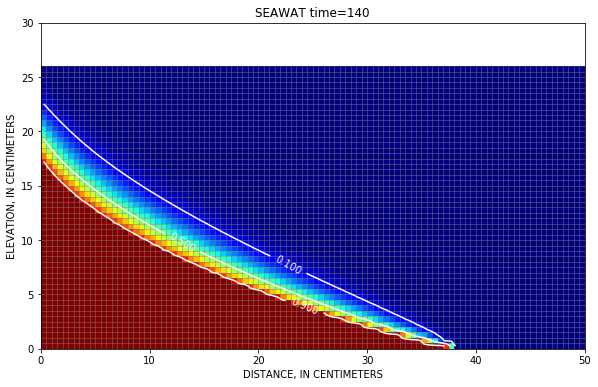

In [137]:
itime = 4
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
xs.plot_grid(linewidths=0.5, alpha=0.5)
xs.plot_array(conc[itime], cmap='jet', vmin=0, vmax=0.0371)
#xs.plot_specific_discharge(splist[0], color='white')
cs = xs.contour_array(conc[itime] / 0.0371, levels=[0.1, .5, .9], colors='white')
ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)
if plot_title:
    ax.set_title('SEAWAT time={}'.format(printtimes[itime]))

In [138]:
# table A1 from Goswami and Clement (2007)
ss1x = [0, .2, 1, 1.9, 2.8, 4, 5, 6.3, 7.5, 8.7, 10.1, 11.6, 13.1, 15.1]
ss1z = [13.2, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
ss2x = [0, 0.4, 1.1, 1.9, 3., 4.3, 5.7, 7.4, 9., 10.7, 12.6, 14.4, 16.2, 18.1, 
        19.9, 21.9, 23.9, 26., 28.3, 30.5, 32.9, 35.2, 37.6]
ss2z = [22., 21.5, 20.5, 19.5, 18.5, 17.5, 16.5, 15.5, 14.5, 13.5, 
        12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
ss3x = [0, 0.6, 1.5, 2.3, 3.3, 4.4, 5.5, 6.6, 7.7, 8.8, 10.1, 11.6, 13.1, 14.7, 16.2, 18.2]
ss3z = [15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]

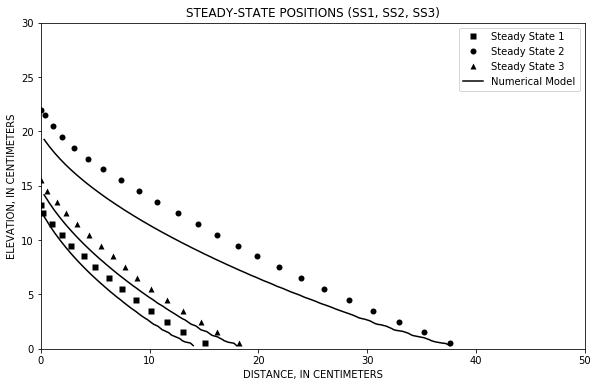

In [139]:
# Figure 5 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[0] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[4] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[8] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ss1x, ss1z, marker='s', mfc='k', mec='none', linestyle='none', label='Steady State 1')[0]
h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
h3 = plt.plot(ss3x, ss3z, marker='^', mfc='k', mec='none', linestyle='none', label='Steady State 3')[0]

black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('STEADY-STATE POSITIONS (SS1, SS2, SS3)')

fname = '../Figures/pxx_goswami5.pdf'
plt.savefig(fname)

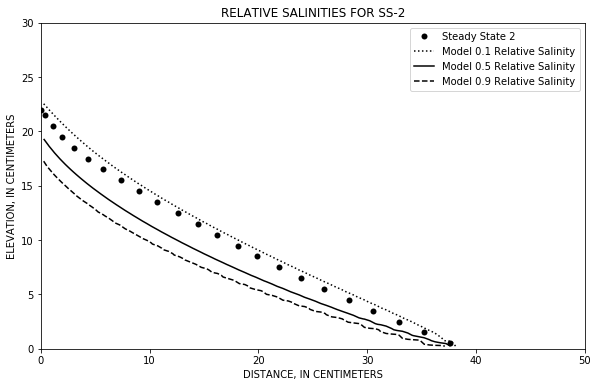

In [140]:
# Figure 6 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[4] / 0.0371, levels=[0.1, .5, .9], linestyles = [':', '-', '--'], colors='k')

h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
dot_line = mlines.Line2D([], [], linestyle=':', color='black', label='Model 0.1 Relative Salinity')
black_line = mlines.Line2D([], [], color='black', label='Model 0.5 Relative Salinity')
dash_line = mlines.Line2D([], [], linestyle='--', color='black', label='Model 0.9 Relative Salinity')

handles = [h2, dot_line, black_line, dash_line]
labels = [h2.get_label(), dot_line.get_label(), black_line.get_label(), dash_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('RELATIVE SALINITIES FOR SS-2')

fname = '../Figures/pxx_goswami6.pdf'
plt.savefig(fname)

In [141]:
# transient advancing (Table A2, Figure 7, Goswami) at 5, 15, and 55 min
ta5x = [0, .3, .9, 1.5, 2.2, 3, 4.1, 5.1, 6.2, 7.4, 8.6, 9.7, 11, 12.3, 13.7, 15.2, 16.8, 18.4, 20.1, 21.5]
ta5z = [19.3, 18.5, 17.5, 16.5, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
ta15x = [0, 0.6, 1.4, 2.2, 3.2, 4.4, 5.6, 6.9, 8.2, 9.4, 10.7, 12.2, 13.7, 15.3, 17., 18.7, 20.6, 22.6, 24.8, 27, 29]
ta15z = [20.6, 19.5, 18.5, 17.5, 16.5, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
ta55x = [0, 0.6, 1.4, 2.4, 3.7, 5.3, 7, 8.5, 10.1, 11.7, 13.4, 15.2, 17.2, 19.1, 21.2, 23.3, 25.4, 27.5, 29.7, 32, 34.5, 35.9]
ta55z = [21.6, 20.5, 19.5, 18.5, 17.5, 16.5, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 1.]

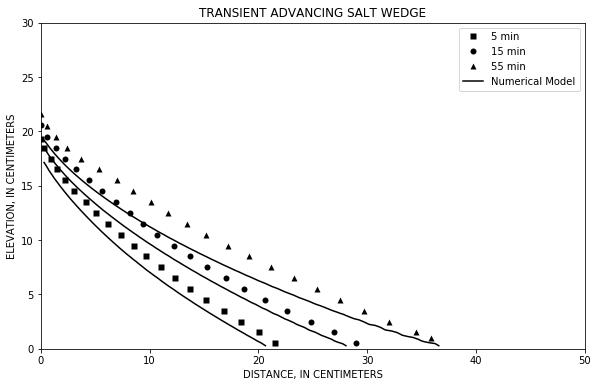

In [142]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[1] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[2] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[3] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ta5x, ta5z, marker='s', mfc='k', mec='none', linestyle='none', label='5 min')[0]
h2 = plt.plot(ta15x, ta15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(ta55x, ta55z, marker='^', mfc='k', mec='none', linestyle='none', label='55 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT ADVANCING SALT WEDGE')

fname = '../Figures/pxx_goswami7.pdf'
plt.savefig(fname)

In [143]:
# transient receding (Table A3, Figure 8, Goswami) at 10, 15, and 25 min
tr10x = [0, 0.7, 1.6, 2.5, 3.6, 4.8, 6, 7.5, 9, 10.5, 12.1, 13.8, 15.4, 17.1, 18.9, 20.7, 22.1, 24.7, 26.6]
tr10z = [18.8, 17.5, 16.5, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
tr15x = [0, 0.2, 0.7, 1.6, 2.6, 3.7, 4.8, 6, 7.35, 8.65, 10, 11.4, 12.9, 14.4, 15.9, 17.45, 19.15, 21, 23.1]
tr15z = [18.3, 17.5, 16.5, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]
tr25x = [0, 0.6, 1.5, 2.5, 3.6, 4.7, 5.8, 6.9, 8, 9.1, 10.2, 11.5, 13, 14.5, 16, 17.7, 19.4]
tr25z = [16.7, 15.5, 14.5, 13.5, 12.5, 11.5, 10.5, 9.5, 8.5, 7.5, 6.5, 5.5, 4.5, 3.5, 2.5, 1.5, 0.5]

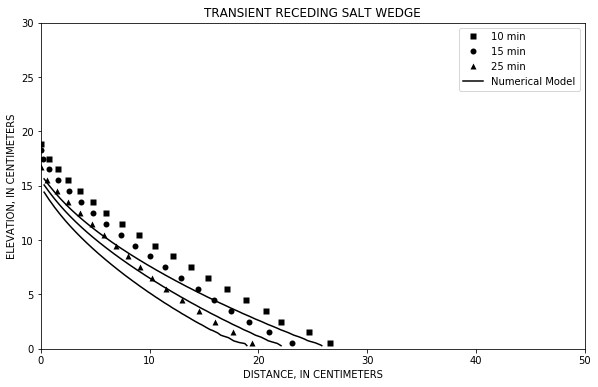

In [144]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[5] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[6] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[7] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(tr10x, tr10z, marker='s', mfc='k', mec='none', linestyle='none', label='10 min')[0]
h2 = plt.plot(tr15x, tr15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(tr25x, tr25z, marker='^', mfc='k', mec='none', linestyle='none', label='25 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT RECEDING SALT WEDGE')

fname = '../Figures/pxx_goswami8.pdf'
plt.savefig(fname)

In [145]:
# laboratory measured and simulated flows from the freshwater boundary for SS-1, SS-2, and SS-3
qss1 = 1.42 #cm^3/s
qss2 = 0.59 #cm^3/s
qss3 = 1.19 #cm^3/s

qss1mf6 = 0. #cm^3/cm/min
qss2mf6 = 0. #cm^3/cm/min
qss3mf6 = 0. #cm^3/cm/min

fact = 2.7 / 60
print('SS-1: ', qss1, '{:.2f}'.format(qss1mf6 * fact))
print('SS-2: ', qss2, '{:.2f}'.format(qss2mf6 * fact))
print('SS-3: ', qss3, '{:.2f}'.format(qss3mf6 * fact))

SS-1:  1.42 0.00
SS-2:  0.59 0.00
SS-3:  1.19 0.00


# SEAWAT Upstream-Weighted CHD

In [146]:
ws = 'temp/pxx_goswami_seawat_chd_up'
name = 'gswt'
gfact = 1
swt = get_model(ws, name, nlay=gfact*52, ncol=gfact*106,
                general_head_boundary=False)
swt.write_input()
fname = os.path.join(ws, 'MT3D001.UCN')
if os.path.isfile(fname):
    os.remove(fname)
swt.run_model()

FloPy is using the following  executable to run the model: /Users/langevin/langevin/bin/mac/swt_v4

                                  SEAWAT Version 4
    U.S. GEOLOGICAL SURVEY MODULAR FINITE-DIFFERENCE GROUND-WATER FLOW MODEL
                             Version 4.00.05 10/19/2012                      

Incorporated MODFLOW Version: 1.18.01 06/20/2008                      
Incorporated MT3DMS  Version: 5.20    10/30/2006                      


 This program is public domain and is released on the
 condition that neither the U.S. Geological Survey nor
 the United States Government may be held liable for any
 damages resulting from their authorized or unauthorized
 use.


 Using NAME file: gswt.nam                                                                                                                                                                                                
 Run start date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:13:55


 STRESS PERIOD NO.    1

  ST


  STRESS PERIOD    1 TIME STEP   10 FROM TIME =  0.15000     TO   0.16667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.16667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5042E-01  [K,I,J]   51    1    3
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4157E-02  [K,I,J]   50    1    4
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5392E-03  [K,I,J]   50    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6111E-04  [K,I,J]   51    1    4
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8578E-05  [K,I,J]   52    1    4
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2200E-05  [K,I,J]   52    1    5
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.2814E-06  [K,I,J]   52    1    5
 Outer Iter.  1  Inner Iter.  8:  Max. DC =  0.5266E-07  [K,I,J]   52    1    7

  STRESS PERIOD    1 TIME STEP   11 FROM TIME =  0.16667     TO   0.18333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.18333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2702E-01  [K,I,J]   52    1    7
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1271E-02  [K,I,J]   43    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8082E-04  [K,I,J]   44    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8040E-05  [K,I,J]   36    1    2
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1709E-05  [K,I,J]   37    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2938E-06  [K,I,J]   35    1    2
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.3448E-07  [K,I,J]   34    1    2

  STRESS PERIOD    1 TIME STEP   30 FROM TIME =  0.48333     TO   0.50000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.50000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2700E-01  [K,I,J]   52    1    7
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1213E-02  [K,I,J]   43    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7660E-04  [K,I,J]   44    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP   49 FROM TIME =  0.80000     TO   0.81667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.81667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2100E-01  [K,I,J]   52    1    9
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7105E-03  [K,I,J]   39    1    2
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6087E-04  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7716E-05  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1420E-05  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2901E-06  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.1866E-07  [K,I,J]   31    1    1

  STRESS PERIOD    1 TIME STEP   50 FROM TIME =  0.81667     TO   0.83333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.83333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2079E-01  [K,I,J]   52    1    9
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1766E-01  [K,I,J]   52    1   11
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4798E-03  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7977E-04  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6059E-05  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5073E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1668E-06  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.5142E-07  [K,I,J]   30    1    1

  STRESS PERIOD    1 TIME STEP   69 FROM TIME =   1.1333     TO    1.1500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.1500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1764E-01  [K,I,J]   52    1   11
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4644E-03  [K,I,J]   34    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8072E-04  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1547E-01  [K,I,J]   52    1   12
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4623E-04  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4557E-03  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6199E-05  [K,I,J]   36    1    3
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3445E-05  [K,I,J]   36    1    3
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1186E-06  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.1122E-07  [K,I,J]   26    1    1

  STRESS PERIOD    1 TIME STEP   89 FROM TIME =   1.4667     TO    1.4833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.4833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-01  [K,I,J]   52    1   12
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2974E-03  [K,I,J]   33    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6972E-03  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1442E-01  [K,I,J]   52    1   14
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4018E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6918E-04  [K,I,J]   37    1    2
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3078E-05  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5366E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2624E-07  [K,I,J]   31    1    1

  STRESS PERIOD    1 TIME STEP  110 FROM TIME =   1.8167     TO    1.8333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1441E-01  [K,I,J]   52    1   14
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3955E-03  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6574E-04  [K,I,J]   35    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2979E-05  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1356E-01  [K,I,J]   52    1   15
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3087E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3521E-04  [K,I,J]   38    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2363E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2013E-06  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2367E-07  [K,I,J]   32    1    1

  STRESS PERIOD    1 TIME STEP  130 FROM TIME =   2.1500     TO    2.1667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.1667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1349E-01  [K,I,J]   52    1   15
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3059E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3390E-04  [K,I,J]   38    1    3
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2361E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1282E-01  [K,I,J]   52    1   16
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2637E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2415E-04  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2391E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1761E-06  [K,I,J]   31    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3839E-07  [K,I,J]   30    1    1

  STRESS PERIOD    1 TIME STEP  150 FROM TIME =   2.4833     TO    2.5000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.5000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1274E-01  [K,I,J]   52    1   16
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2613E-03  [K,I,J]   30    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2348E-04  [K,I,J]   32    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2395E-05  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1224E-01  [K,I,J]   52    1   17
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2205E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1804E-04  [K,I,J]   49    1   16
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2591E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1198E-06  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3038E-07  [K,I,J]   23    1    1

  STRESS PERIOD    1 TIME STEP  171 FROM TIME =   2.8333     TO    2.8500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.8500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1216E-01  [K,I,J]   52    1   17
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2186E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1767E-04  [K,I,J]   49    1   16
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2609E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1181E-01  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1820E-03  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1489E-04  [K,I,J]   50    1   18
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3093E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1205E-06  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1279E-07  [K,I,J]   22    1    1

  STRESS PERIOD    1 TIME STEP  193 FROM TIME =   3.2000     TO    3.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1175E-01  [K,I,J]   52    1   18
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1805E-03  [K,I,J]   28    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1476E-04  [K,I,J]   50    1   18
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3138E-05  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1145E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1579E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4548E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1201E-04  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1150E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1358E-07  [K,I,J]   21    1    1

  STRESS PERIOD    1 TIME STEP  215 FROM TIME =   3.5667     TO    3.5833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.5833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1145E-01  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1602E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2340E-05  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1396E-04  [K,I,J]   49    1   17
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1064E-01  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1512E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2396E-04  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7165E-05  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1107E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1460E-07  [K,I,J]   21    1    1

  STRESS PERIOD    1 TIME STEP  237 FROM TIME =   3.9333     TO    3.9500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.9500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1074E-01  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1489E-03  [K,I,J]   52    1   19
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2330E-04  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6669E-05  [K,I,J]   50    1   19
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1010E-01  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1738E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2030E-04  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3731E-05  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1036E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1402E-07  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  259 FROM TIME =   4.3000     TO    4.3167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.3167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9986E-02  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1725E-03  [K,I,J]   52    1   20
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2044E-04  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3707E-05  [K,I,J]   51    1   21
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1050E-01  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1840E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1669E-04  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2315E-05  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1027E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1252E-07  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  281 FROM TIME =   4.6667     TO    4.6833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.6833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1048E-01  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1851E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1666E-04  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2298E-05  [K,I,J]   50    1   20
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8997E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1653E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1966E-04  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2262E-05  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1867E-06  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1157E-07  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  303 FROM TIME =   5.0333     TO    5.0500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9144E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1630E-03  [K,I,J]   52    1   21
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1965E-04  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2240E-05  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9804E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1881E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1343E-04  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8806E-06  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6065E-06  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1021E-07  [K,I,J]   20    1    1

  STRESS PERIOD    1 TIME STEP  325 FROM TIME =   5.4000     TO    5.4167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.4167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9758E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1881E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1337E-04  [K,I,J]   50    1   21
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7768E-06  [K,I,J]   51    1   22
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7939E-02  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1610E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1677E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2087E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3242E-06  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2795E-08  [K,I,J]   51    1   23

  STRESS PERIOD    1 TIME STEP  347 FROM TIME =   5.7667     TO    5.7833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7842E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1585E-03  [K,I,J]   52    1   22
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1701E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2079E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    1 TIME STEP  368 FROM TIME =   6.1167     TO    6.1333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.1333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9294E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1805E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1426E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1534E-05  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8675E-07  [K,I,J]   51    1   23

  STRESS PERIOD    1 TIME STEP  369 FROM TIME =   6.1333     TO    6.1500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.1500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9265E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1810E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1393E-04  [K,I,J]   51    1   23
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7905E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1689E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1222E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1238E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8485E-07  [K,I,J]   50    1   22

  STRESS PERIOD    1 TIME STEP  391 FROM TIME =   6.5000     TO    6.5167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.5167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7816E-02  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1674E-03  [K,I,J]   52    1   23
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1250E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1275E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8532E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  392 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8053E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1447E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1599E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1649E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8366E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  414 FROM TIME =   6.8833     TO    6.9000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.9000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8160E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1480E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1603E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1648E-05  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8207E-07  [K,I,J]   51    1   24

  STRESS PERIOD    1 TIME STEP  415 FRO


  STRESS PERIOD    1 TIME STEP  436 FROM TIME =   7.2500     TO    7.2667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.2667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8151E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1676E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1073E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9338E-06  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4076E-07  [K,I,J]   49    1   23

  STRESS PERIOD    1 TIME STEP  437 FROM TIME =   7.2667     TO    7.2833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.2833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8094E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1672E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1048E-04  [K,I,J]   51    1   24
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP  459 FROM TIME =   7.6333     TO    7.6500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.6500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6540E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1473E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1119E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1077E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6208E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  460 FROM TIME =   7.6500     TO    7.6667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.6667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6461E-02  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1459E-03  [K,I,J]   52    1   24
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1136E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP  482 FROM TIME =   8.0167     TO    8.0333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.0333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6577E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1218E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1325E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1357E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7897E-07  [K,I,J]   51    1   25

  STRESS PERIOD    1 TIME STEP  483 FROM TIME =   8.0333     TO    8.0500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.0500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6642E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1238E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1327E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP  505 FROM TIME =   8.4000     TO    8.4167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.4167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7664E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1505E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1166E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1076E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5154E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  506 FROM TIME =   8.4167     TO    8.4333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.4333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7613E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1498E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1133E-04  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1311E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7004E-05  [K,I,J]   51    1   25
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5606E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3859E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  528 FROM TIME =   8.7833     TO    8.8000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.8000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6312E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1305E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6922E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5803E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3980E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  529 FROM TIME =   8.8000     TO    8.8167    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4933E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1113E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9611E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9296E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6575E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  551 FROM TIME =   9.1667     TO    9.1833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.1833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4872E-02  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1102E-03  [K,I,J]   52    1   25
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9675E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9404E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6729E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  552 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9517E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1031E-04  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1058E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8087E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  574 FROM TIME =   9.5500     TO    9.5667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.5667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5116E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9626E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1032E-04  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1058E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8066E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  575 FROM TIME =   9.5667     TO    9.5833    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5875E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1146E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1011E-04  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9988E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6428E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  597 FROM TIME =   9.9333     TO    9.9500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.9500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5914E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1152E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1009E-04  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9930E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6319E-07  [K,I,J]   51    1   26

  STRESS PERIOD    1 TIME STEP  598 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6119E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1143E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7622E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6364E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3510E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  620 FROM TIME =   10.317     TO    10.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6065E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1135E-03  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7421E-05  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6092E-06  [K,I,J]   51    1   26
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3556E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  621 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4843E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9704E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5891E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5317E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4527E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  644 FROM TIME =   10.717     TO    10.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4792E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9633E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5985E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5424E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4548E-07  [K,I,J]   50    1   25

  STRESS PERIOD    1 TIME STEP  645 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3698E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7900E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7097E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6898E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7114E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  668 FROM TIME =   11.117     TO    11.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3654E-02  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7821E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7113E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6928E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7543E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  669 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3353E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6036E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7168E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7183E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7196E-08  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  692 FROM TIME =   11.517     TO    11.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3363E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5968E-04  [K,I,J]   52    1   26
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7162E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7194E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4292E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  693 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3607E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6620E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6975E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7122E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8021E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  716 FROM TIME =   11.917     TO    11.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3619E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6652E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6965E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7111E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7189E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  717 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3919E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7265E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6678E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6670E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5132E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  740 FROM TIME =   12.317     TO    12.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3934E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7281E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6663E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6643E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5079E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  741 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4357E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7389E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6259E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5924E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3869E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  764 FROM TIME =   12.717     TO    12.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4380E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7381E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6238E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5890E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3824E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  765 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4571E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6797E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4844E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4023E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3917E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  788 FROM TIME =   13.117     TO    13.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4526E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6758E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4712E-05  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3844E-06  [K,I,J]   51    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3976E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  789 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6001E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3752E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3807E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5069E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  812 FROM TIME =   13.517     TO    13.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3569E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5971E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3809E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3886E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5122E-07  [K,I,J]   50    1   26

  STRESS PERIOD    1 TIME STEP  813 FROM TIME =   13.533     TO    13.550    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4869E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6466E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  836 FROM TIME =   13.917     TO    13.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2789E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5297E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4418E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4886E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6539E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  837 FROM TIME =   13.933     TO    13.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2761E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2172E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4567E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4353E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4958E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7196E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  861 FROM TIME =   14.333     TO    14.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2149E-02  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4535E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4345E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4951E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7183E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  862 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1839E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3764E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4117E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4657E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6265E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  886 FROM TIME =   14.750     TO    14.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1839E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3732E-04  [K,I,J]   52    1   27
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4107E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4641E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6211E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  887 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1823E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3490E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3851E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4230E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4851E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  911 FROM TIME =   15.167     TO    15.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1822E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3498E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3840E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4212E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4797E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  912 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1804E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3639E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3592E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3801E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3666E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  936 FROM TIME =   15.583     TO    15.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1804E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3642E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3582E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3785E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3628E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  937 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1792E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3674E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3353E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3416E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2765E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  961 FROM TIME =   16.000     TO    16.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1792E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3673E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3344E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3402E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2738E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP  962 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1791E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3603E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3139E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3086E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2270E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  986 FROM TIME =   16.417     TO    16.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1791E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3598E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3131E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3074E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2262E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP  987 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1806E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3447E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2948E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2802E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2094E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1011 FROM TIME =   16.833     TO    16.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1807E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3437E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2941E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2792E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2087E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1012 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1842E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3173E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2779E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2557E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1897E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1036 FROM TIME =   17.250     TO    17.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1844E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3161E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2773E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2548E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1890E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1037 FRO

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2627E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2343E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1715E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1061 FROM TIME =   17.667     TO    17.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1906E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2846E-04  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2622E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2335E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1709E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1062 FROM TIME =   17.683     TO    17.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.700    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2148E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1547E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1086 FROM TIME =   18.083     TO    18.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2000E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2533E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2480E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2141E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1540E-07  [K,I,J]   51    1   27

  STRESS PERIOD    1 TIME STEP 1087 FROM TIME =   18.100     TO    18.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2004E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    1 TIME STEP 1111 FROM TIME =   18.500     TO    18.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2135E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2481E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2343E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1959E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1621E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1112 FROM TIME =   18.517     TO    18.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2141E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2478E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2337E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP 1136 FROM TIME =   18.917     TO    18.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2330E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2389E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2204E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1788E-06  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1732E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1137 FROM TIME =   18.933     TO    18.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2340E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2384E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2198E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    1 TIME STEP 1161 FROM TIME =   19.333     TO    19.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2407E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2147E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1787E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2215E-06  [K,I,J]   50    1   27
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1981E-07  [K,I,J]   50    1   27

  STRESS PERIOD    1 TIME STEP 1162 FROM TIME =   19.350     TO    19.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2384E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2135E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1752E-05  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1921E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2148E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1874E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2485E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1361E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1187 FROM TIME =   19.767     TO    19.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1904E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2148E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1896E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2529E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1361E-07  [K,I,J]   51    1   28

  STRESS PERIOD    1 TIME STEP 1188 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1534E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2028E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2040E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2645E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1395E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1213 FROM TIME =   20.200     TO    20.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1521E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2019E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2037E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2631E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1408E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1214 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1239E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1765E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1883E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2248E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1664E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1239 FROM TIME =   20.633     TO    20.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1229E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1754E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1876E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2233E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1672E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1240 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1498E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1688E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1897E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1847E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1265 FROM TIME =   21.067     TO    21.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1007E-02  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1488E-04  [K,I,J]   51    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1681E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1885E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1854E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1266 FROM TIME =   21.083     TO    21.100    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1607E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2042E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1291 FROM TIME =   21.500     TO    21.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8335E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1294E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1495E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1597E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2050E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1292 FROM TIME =   21.517     TO    21.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8276E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6963E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1152E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1328E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1345E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2343E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1318 FROM TIME =   21.950     TO    21.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6916E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1147E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1322E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1335E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2358E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1319 FRO


  STRESS PERIOD    1 TIME STEP 1344 FROM TIME =   22.383     TO    22.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5820E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1019E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1176E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1093E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2904E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1345 FROM TIME =   22.400     TO    22.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5783E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1015E-04  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1171E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4926E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9068E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1049E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8048E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1371 FROM TIME =   22.833     TO    22.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4895E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9027E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1044E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7911E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1372 FROM TIME =   22.850     TO    22.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8040E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9345E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1542E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1398 FROM TIME =   23.283     TO    23.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4135E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8005E-05  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9306E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1019E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1399 FROM TIME =   23.300     TO    23.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4109E-03  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3795E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7149E-05  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8367E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3047E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2115E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7260E-10  [K,I,J]   50    1   28

  STRESS PERIOD    1 TIME STEP 1425 FROM TIME =   23.733     TO    23.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3783E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7121E-05  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8333E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2797E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3485E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6416E-05  [K,I,J]   52    1   28
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7535E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1256E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4433E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1452 FROM TIME =   24.183     TO    24.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3474E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6394E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7506E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1239E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4298E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1453 FRO


  STRESS PERIOD    1 TIME STEP 1478 FROM TIME =   24.617     TO    24.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3198E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6310E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6832E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9493E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1479 FROM TIME =   24.633     TO    24.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3188E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6306E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6808E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9411E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1480 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2923E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6199E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6218E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7802E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1507 FROM TIME =   25.100     TO    25.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2913E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6195E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6198E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7755E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1508 FROM TIME =   25.117     TO    25.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1535 FROM TIME =   25.567     TO    25.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2660E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6037E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5679E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6675E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1536 FROM TIME =   25.583     TO    25.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2651E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6031E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5662E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6644E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1537 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2426E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5835E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5228E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5917E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1564 FROM TIME =   26.050     TO    26.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2418E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5827E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5213E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5894E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1565 FROM TIME =   26.067     TO    26.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2210E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5594E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4821E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5338E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1592 FROM TIME =   26.517     TO    26.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2203E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5585E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4807E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5319E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1593 FROM TIME =   26.533     TO    26.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1620 FROM TIME =   26.983     TO    27.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2004E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5312E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4430E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4838E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1621 FROM TIME =   27.000     TO    27.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1998E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5302E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4417E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4823E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1622 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1822E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5015E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4073E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4408E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1649 FROM TIME =   27.467     TO    27.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1815E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5003E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4059E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4392E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1650 FROM TIME =   27.483     TO    27.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.500    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1648E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4691E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3719E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3994E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1678 FROM TIME =   27.950     TO    27.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1642E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4680E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3707E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3980E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1679 FROM TIME =   27.967     TO    27.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1489E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4371E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3384E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3619E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1707 FROM TIME =   28.433     TO    28.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1484E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4361E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3374E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3608E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1708 FROM TIME =   28.450     TO    28.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.467    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1736 FROM TIME =   28.917     TO    28.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1341E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4058E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3061E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3265E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1737 FROM TIME =   28.933     TO    28.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1336E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4047E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3050E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3252E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1738 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1210E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3760E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2768E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2942E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1766 FROM TIME =   29.417     TO    29.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1206E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3750E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2759E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2931E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1767 FROM TIME =   29.433     TO    29.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.450    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1092E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3470E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2499E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2645E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1795 FROM TIME =   29.900     TO    29.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1088E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3460E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2490E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2635E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1796 FROM TIME =   29.917     TO    29.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9800E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3180E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2243E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2365E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1825 FROM TIME =   30.400     TO    30.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9764E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3171E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2235E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2357E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1826 FROM TIME =   30.417     TO    30.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.433    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1854 FROM TIME =   30.883     TO    30.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8786E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2905E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2010E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2113E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1855 FROM TIME =   30.900     TO    30.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8753E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2896E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2003E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2105E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1856 FRO

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1827E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1915E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1881 FROM TIME =   31.333     TO    31.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7954E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2671E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1819E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1907E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1882 FROM TIME =   31.350     TO    31.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7928E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2664E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7145E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2436E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1634E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1708E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1911 FROM TIME =   31.833     TO    31.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7116E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2428E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1627E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1702E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1912 FROM TIME =   31.850     TO    31.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1941 FROM TIME =   32.333     TO    32.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6361E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2202E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1454E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1518E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1942 FROM TIME =   32.350     TO    32.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6342E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2196E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1450E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1513E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1943 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5705E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2000E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1305E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1359E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1971 FROM TIME =   32.833     TO    32.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5680E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1992E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1299E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1353E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 1972 FROM TIME =   32.850     TO    32.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5069E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1801E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1160E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1207E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2002 FROM TIME =   33.350     TO    33.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5050E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1795E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1156E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1202E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2003 FROM TIME =   33.367     TO    33.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.383    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4482E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1613E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1027E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1067E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2034 FROM TIME =   33.883     TO    33.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4464E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1607E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1022E-06  [K,I,J]   51    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1063E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2035 FROM TIME =   33.900     TO    33.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.917    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3944E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1437E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9046E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2067 FROM TIME =   34.433     TO    34.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3931E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1433E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9019E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2068 FROM TIME =   34.450     TO    34.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3916E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1428E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3469E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1279E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7975E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2100 FROM TIME =   34.983     TO    35.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3456E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1274E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7944E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2101 FROM TIME =   35.000     TO    35.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3443E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1270E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3047E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1136E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7021E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2133 FROM TIME =   35.533     TO    35.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3035E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1132E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6993E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2134 FROM TIME =   35.550     TO    35.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3023E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1128E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2673E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1006E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6174E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2166 FROM TIME =   36.083     TO    36.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2665E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1004E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6157E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2167 FROM TIME =   36.100     TO    36.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2654E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9999E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8907E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5426E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2199 FROM TIME =   36.633     TO    36.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2334E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8874E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5405E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2200 FROM TIME =   36.650     TO    36.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2324E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8841E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5384E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2201 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2044E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7844E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4747E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2233 FROM TIME =   37.200     TO    37.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2035E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7814E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4727E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2234 FROM TIME =   37.217     TO    37.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2027E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7785E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4144E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2267 FROM TIME =   37.767     TO    37.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6864E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4128E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2268 FROM TIME =   37.783     TO    37.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1765E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6838E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4111E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2269 FROM TIME =   37.800     TO    37.817    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1552E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6057E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3625E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2301 FROM TIME =   38.333     TO    38.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1540E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6016E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3595E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2302 FROM TIME =   38.350     TO    38.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1537E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6005E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1339E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5275E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3135E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2336 FROM TIME =   38.917     TO    38.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1334E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5255E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3123E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2337 FROM TIME =   38.933     TO    38.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1328E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5233E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1150E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4569E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2699E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2372 FROM TIME =   39.517     TO    39.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1148E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4558E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2694E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2373 FROM TIME =   39.533     TO    39.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1141E-04  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4533E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9829E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3936E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2309E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2409 FROM TIME =   40.133     TO    40.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9834E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3933E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2314E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2410 FROM TIME =   40.150     TO    40.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9770E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3913E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8402E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3387E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1980E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2447 FROM TIME =   40.767     TO    40.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8367E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3373E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1972E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2448 FROM TIME =   40.783     TO    40.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8336E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3361E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7178E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2914E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1695E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2485 FROM TIME =   41.400     TO    41.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7104E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2888E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1675E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2486 FROM TIME =   41.417     TO    41.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7164E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2872E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6102E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2462E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1457E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2524 FROM TIME =   42.050     TO    42.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6002E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2454E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1418E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2525 FROM TIME =   42.067     TO    42.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6053E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2445E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5166E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2097E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1235E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2563 FROM TIME =   42.700     TO    42.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5075E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2088E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1200E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2564 FROM TIME =   42.717     TO    42.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5116E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2079E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4322E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1783E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1027E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2603 FROM TIME =   43.367     TO    43.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4257E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1764E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1007E-07  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2604 FROM TIME =   43.383     TO    43.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4292E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1754E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3629E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1491E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8695E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2644 FROM TIME =   44.050     TO    44.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3562E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1484E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8436E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2645 FROM TIME =   44.067     TO    44.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3589E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1476E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3023E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1243E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7264E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2687 FROM TIME =   44.767     TO    44.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3038E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1226E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7408E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2688 FROM TIME =   44.783     TO    44.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2942E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1233E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2508E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1031E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6041E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2733 FROM TIME =   45.533     TO    45.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2515E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1013E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6156E-08  [K,I,J]   51    1   29

  STRESS PERIOD    1 TIME STEP 2734 FROM TIME =   45.550     TO    45.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2383E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1005E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2026E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8081E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2782 FROM TIME =   46.350     TO    46.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1950E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8266E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2783 FROM TIME =   46.367     TO    46.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1961E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8150E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2784 FROM TIME =   46.383     TO    46.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.400    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2834 FROM TIME =   47.217     TO    47.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1559E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6638E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2835 FROM TIME =   47.233     TO    47.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1566E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6533E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2836 FROM TIME =   47.250     TO    47.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1574E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6439E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2837 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1272E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5296E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2888 FROM TIME =   48.117     TO    48.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1275E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5204E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2889 FROM TIME =   48.133     TO    48.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1280E-05  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5152E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2890 FROM TIME =   48.150     TO    48.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9625E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4161E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2942 FROM TIME =   49.017     TO    49.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9659E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4091E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2943 FROM TIME =   49.033     TO    49.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9718E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4054E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2944 FROM TIME =   49.050     TO    49.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.067    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7956E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3328E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2998 FROM TIME =   49.950     TO    49.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7946E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3263E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 2999 FROM TIME =   49.967     TO    49.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7949E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3219E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3000 FROM TIME =   49.983     TO    50.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6614E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2853E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3060 FROM TIME =   50.983     TO    51.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3061 FROM TIME =   51.000     TO    51.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3062 FROM TIME =   51.017     TO    51.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3063 FROM TIME =   51.033     TO    51.050    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3125 FROM TIME =   52.067     TO    52.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3126 FROM TIME =   52.083     TO    52.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3127 FROM TIME =   52.100     TO    52.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3128 FROM TIME =   52.117     TO    52.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3190 FROM TIME =   53.150     TO    53.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3191 FROM TIME =   53.167     TO    53.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5732E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2486E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3192 FROM TIME =   53.183     TO    53.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5835E-06  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2479E-07  [K,I,J]   52    1   29

  STRESS PERIOD    1 TIME STEP 3193 FROM TIME =   53.200     TO    53.217    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3255 FROM TIME =   54.233     TO    54.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3256 FROM TIME =   54.250     TO    54.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3257 FROM TIME =   54.267     TO    54.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3258 FROM TIME =   54.283     TO    54.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.300    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3320 FROM TIME =   55.317     TO    55.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3321 FROM TIME =   55.333     TO    55.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3322 FROM TIME =   55.350     TO    55.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3323 FROM TIME =   55.367     TO    55.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3324 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3386 FROM TIME =   56.417     TO    56.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3387 FROM TIME =   56.433     TO    56.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3388 FROM TIME =   56.450     TO    56.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3389 FROM TIME =   56.467     TO    56.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3451 FROM TIME =   57.500     TO    57.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3452 FROM TIME =   57.517     TO    57.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3453 FROM TIME =   57.533     TO    57.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3454 FROM TIME =   57.550     TO    57.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3455 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3517 FROM TIME =   58.600     TO    58.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3518 FROM TIME =   58.617     TO    58.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3519 FROM TIME =   58.633     TO    58.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3520 FROM TIME =   58.650     TO    58.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3582 FROM TIME =   59.683     TO    59.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3583 FROM TIME =   59.700     TO    59.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3584 FROM TIME =   59.717     TO    59.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3585 FROM TIME =   59.733     TO    59.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.750    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2123E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8601E-05  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7499E-06  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9967E-07  [K,I,J]   21    1    1

  STRESS PERIOD    2 TIME STEP   14 FROM TIME =   60.217     TO    60.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2371E-01  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9568E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1935E-03  [K,I,J]   52    1   29
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8270E-05  [K,I,J]   52    1   30
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8106E-06  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1099E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. D


  STRESS PERIOD    2 TIME STEP   34 FROM TIME =   60.550     TO    60.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1832E-01  [K,I,J]   52    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1822E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3858E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5338E-05  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6262E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8394E-07  [K,I,J]   20    1    1

  STRESS PERIOD    2 TIME STEP   35 FROM TIME =   60.567     TO    60.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1835E-01  [K,I,J]   52    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1020E-03  [K,I,J]   23    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1601E-01  [K,I,J]   52    1   32
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6093E-03  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1817E-03  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3563E-05  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3968E-06  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5932E-07  [K,I,J]   19    1    1

  STRESS PERIOD    2 TIME STEP   54 FROM TIME =   60.883     TO    60.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1604E-01  [K,I,J]   52    1   32
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5889E-03  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1693E-03  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3653E-05  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3747E-03  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5531E-04  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2503E-05  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2581E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7100E-07  [K,I,J]   12    1    1

  STRESS PERIOD    2 TIME STEP   74 FROM TIME =   61.217     TO    61.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1469E-01  [K,I,J]   52    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3690E-03  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5264E-04  [K,I,J]   22    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2425E-05  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2578E-06  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1378E-01  [K,I,J]   52    1   34
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2983E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3898E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2331E-05  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2191E-06  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2960E-07  [K,I,J]   19    1    1

  STRESS PERIOD    2 TIME STEP   95 FROM TIME =   61.567     TO    61.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1377E-01  [K,I,J]   52    1   34
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2959E-03  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3801E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2302E-05  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

  STRESS PERIOD    2 TIME STEP  115 FROM TIME =   61.900     TO    61.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1309E-01  [K,I,J]   52    1   35
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2452E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2137E-04  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2126E-05  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1521E-06  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2656E-07  [K,I,J]   11    1    1

  STRESS PERIOD    2 TIME STEP  116 FROM TIME =   61.917     TO    61.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1308E-01  [K,I,J]   52    1   35
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2432E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1252E-01  [K,I,J]   52    1   36
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2086E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1702E-04  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2173E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1227E-06  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2035E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  136 FROM TIME =   62.250     TO    62.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1254E-01  [K,I,J]   52    1   36
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2073E-03  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1722E-04  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2175E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1203E-01  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1824E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1340E-04  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2323E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1186E-06  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1700E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  157 FROM TIME =   62.600     TO    62.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1206E-01  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1814E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1312E-04  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2336E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1152E-01  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1600E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1039E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2799E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1161E-06  [K,I,J]   10    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1412E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  178 FROM TIME =   62.950     TO    62.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1158E-01  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1590E-03  [K,I,J]   17    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1024E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2838E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1094E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1391E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6906E-05  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4312E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1245E-06  [K,I,J]   10    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1062E-07  [K,I,J]   19    1    1

  STRESS PERIOD    2 TIME STEP  199 FROM TIME =   63.300     TO    63.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1103E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1384E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6754E-05  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4421E-05  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1056E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1257E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3290E-04  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4230E-04  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7623E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  220 FROM TIME =   63.650     TO    63.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1045E-01  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1252E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6750E-04  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7703E-04  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7734E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  221 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1065E-01  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1149E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1411E-04  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5256E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8745E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  241 FROM TIME =   64.000     TO    64.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1057E-01  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1144E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1379E-04  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4957E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8763E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  242 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1065E-01  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1036E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1009E-04  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2384E-05  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8969E-07  [K,I,J]   10    1    1

  STRESS PERIOD    2 TIME STEP  262 FROM TIME =   64.350     TO    64.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1061E-01  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1031E-03  [K,I,J]   16    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1023E-04  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2296E-05  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8969E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  263 FRO


  STRESS PERIOD    2 TIME STEP  283 FROM TIME =   64.700     TO    64.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1043E-01  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9289E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9373E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1653E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9024E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  284 FROM TIME =   64.717     TO    64.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1044E-01  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9249E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9233E-05  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    2 TIME STEP  303 FROM TIME =   65.033     TO    65.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9796E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8551E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8529E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1376E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8789E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  304 FROM TIME =   65.050     TO    65.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9875E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8517E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8480E-05  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9693E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7880E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8463E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1131E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8797E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  325 FROM TIME =   65.400     TO    65.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9615E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7850E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8472E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1135E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8789E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  326 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7362E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7222E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9728E-06  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8591E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  346 FROM TIME =   65.750     TO    65.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9862E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7341E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7368E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9507E-06  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8600E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  347 FROM TIME =   65.767     TO    65.783    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    2 TIME STEP  367 FROM TIME =   66.100     TO    66.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9587E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6873E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6760E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7989E-06  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9078E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  368 FROM TIME =   66.117     TO    66.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9623E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6850E-04  [K,I,J]   15    1    1
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6706E-05  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8976E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6827E-04  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7527E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8255E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9049E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  389 FROM TIME =   66.467     TO    66.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8893E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6735E-04  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7470E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8154E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9108E-07  [K,I,J]    9    1    1

  STRESS PERIOD    2 TIME STEP  390 FRO


  STRESS PERIOD    2 TIME STEP  410 FROM TIME =   66.817     TO    66.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9362E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6777E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6680E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6095E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1078E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1152E-07  [K,I,J]    8    1    1

  STRESS PERIOD    2 TIME STEP  411 FROM TIME =   66.833     TO    66.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9326E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6856E-04  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9068E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5707E-04  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6327E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5934E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1120E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1092E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  432 FROM TIME =   67.183     TO    67.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9111E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5695E-04  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6206E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5792E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7063E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4960E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2289E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1027E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  453 FROM TIME =   67.533     TO    67.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8650E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6937E-04  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7076E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4801E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2470E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1024E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  454 FRO


  STRESS PERIOD    2 TIME STEP  474 FROM TIME =   67.883     TO    67.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8988E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5903E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5401E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2578E-06  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2903E-06  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9782E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  475 FROM TIME =   67.900     TO    67.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8981E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6047E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8127E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6531E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6722E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1449E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7676E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9145E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  496 FROM TIME =   68.250     TO    68.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8209E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6439E-04  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6659E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1385E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP  517 FROM TIME =   68.600     TO    68.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8632E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6490E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6009E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6775E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1137E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8209E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  518 FROM TIME =   68.617     TO    68.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8599E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6571E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8230E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6018E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6153E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7350E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1294E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8017E-08  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  539 FROM TIME =   68.967     TO    68.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8279E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5906E-04  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6058E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7214E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8232E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6648E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6167E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6408E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6918E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  561 FROM TIME =   69.333     TO    69.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8188E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6688E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6234E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6498E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7023E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  562 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8147E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5591E-04  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5574E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5775E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5676E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  583 FROM TIME =   69.700     TO    69.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8174E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5543E-04  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5473E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5669E-06  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5591E-07  [K,I,J]   51    1   51

  STRESS PERIOD    2 TIME STEP  584 FRO


  STRESS PERIOD    2 TIME STEP  604 FROM TIME =   70.050     TO    70.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7846E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6638E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6146E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6258E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5885E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  605 FROM TIME =   70.067     TO    70.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7797E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6652E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6182E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7923E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5497E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5325E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5339E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4739E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  626 FROM TIME =   70.417     TO    70.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7945E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5453E-04  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5228E-05  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5211E-06  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4578E-07  [K,I,J]   51    1   52

  STRESS PERIOD    2 TIME STEP  627 FRO


  STRESS PERIOD    2 TIME STEP  647 FROM TIME =   70.767     TO    70.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7603E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6538E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5916E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5736E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4382E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  648 FROM TIME =   70.783     TO    70.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7557E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6557E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5952E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7641E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5585E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5254E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5151E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4939E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  669 FROM TIME =   71.133     TO    71.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7666E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5497E-04  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5170E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5054E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4793E-07  [K,I,J]   51    1   53

  STRESS PERIOD    2 TIME STEP  670 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7450E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6351E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5615E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5399E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1985E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  691 FROM TIME =   71.500     TO    71.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7411E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6389E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5671E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5471E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1977E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  692 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7317E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5737E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5245E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5011E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2308E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  713 FROM TIME =   71.867     TO    71.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7349E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5661E-04  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5171E-05  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4928E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2251E-07  [K,I,J]   51    1   54

  STRESS PERIOD    2 TIME STEP  714 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7318E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5834E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4926E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4537E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2324E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  735 FROM TIME =   72.233     TO    72.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7288E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5954E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5061E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4683E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2364E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  736 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6879E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5960E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5374E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5206E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2568E-07  [K,I,J]   51    1   55

  STRESS PERIOD    2 TIME STEP  757 FROM TIME =   72.600     TO    72.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6925E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5901E-04  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5320E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5147E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2529E-07  [K,I,J]   51    1   55

  STRESS PERIOD    2 TIME STEP  758 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4965E-04  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3776E-05  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3282E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2128E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  779 FROM TIME =   72.967     TO    72.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7175E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5018E-04  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3874E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3424E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2138E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  780 FROM TIME =   72.983     TO    73.000    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6445E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6186E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5461E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5260E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2687E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  801 FROM TIME =   73.333     TO    73.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6396E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6154E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5439E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5238E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2679E-07  [K,I,J]   51    1   56

  STRESS PERIOD    2 TIME STEP  802 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6981E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4972E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4224E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3779E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2195E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  823 FROM TIME =   73.700     TO    73.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6984E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4911E-04  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4151E-05  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3684E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2204E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  824 FRO


  STRESS PERIOD    2 TIME STEP  844 FROM TIME =   74.050     TO    74.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6598E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5850E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4881E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4477E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2230E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  845 FROM TIME =   74.067     TO    74.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6562E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5931E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4976E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6516E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5592E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4861E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4603E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2374E-07  [K,I,J]   51    1   57

  STRESS PERIOD    2 TIME STEP  866 FROM TIME =   74.417     TO    74.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6547E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5535E-04  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4803E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4536E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2333E-07  [K,I,J]   51    1   57

  STRESS PERIOD    2 TIME STEP  867 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6673E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4832E-04  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3426E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2837E-06  [K,I,J]   50    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2069E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  888 FROM TIME =   74.783     TO    74.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6658E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4863E-04  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3365E-05  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2834E-06  [K,I,J]   50    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2076E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  889 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6071E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5997E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5096E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4812E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2477E-07  [K,I,J]   51    1   58

  STRESS PERIOD    2 TIME STEP  909 FROM TIME =   75.133     TO    75.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6031E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6047E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5162E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4892E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2531E-07  [K,I,J]   51    1   58

  STRESS PERIOD    2 TIME STEP  910 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5099E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4268E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3913E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1970E-07  [K,I,J]   51    1   58

  STRESS PERIOD    2 TIME STEP  931 FROM TIME =   75.500     TO    75.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6444E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5045E-04  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4204E-05  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3834E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1915E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  932 FROM TIME =   75.517     TO    75.533    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6316E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4854E-04  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3383E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2874E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1969E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  953 FROM TIME =   75.867     TO    75.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6293E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4871E-04  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3475E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2967E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1971E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  954 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5622E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5908E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4982E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4662E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2383E-07  [K,I,J]   51    1   59

  STRESS PERIOD    2 TIME STEP  975 FROM TIME =   76.233     TO    76.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5682E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5883E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4970E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4657E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2390E-07  [K,I,J]   51    1   59

  STRESS PERIOD    2 TIME STEP  976 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6225E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4784E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3858E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3457E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1764E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  997 FROM TIME =   76.600     TO    76.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6230E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4737E-04  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3797E-05  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3381E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1758E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP  998 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6007E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4812E-04  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3294E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2841E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1745E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1019 FROM TIME =   76.967     TO    76.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5983E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4821E-04  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3375E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2924E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1747E-07  [K,I,J]    7    1    1

  STRESS PERIOD    2 TIME STEP 1020 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5617E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4646E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4342E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2280E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1041 FROM TIME =   77.333     TO    77.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5401E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5644E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4685E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4393E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2323E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1042 FROM TIME =   77.350     TO    77.367    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3717E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3345E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1715E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1063 FROM TIME =   77.700     TO    77.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5982E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4635E-04  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3657E-05  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3271E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1662E-07  [K,I,J]   51    1   60

  STRESS PERIOD    2 TIME STEP 1064 FROM TIME =   77.717     TO    77.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.733    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4667E-04  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2845E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2425E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1572E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1085 FROM TIME =   78.067     TO    78.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5771E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4677E-04  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2921E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2501E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1569E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1086 FROM TIME =   78.083     TO    78.100    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5207E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4148E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3805E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1990E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1107 FROM TIME =   78.433     TO    78.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5145E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5238E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4186E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3848E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2018E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1108 FROM TIME =   78.450     TO    78.467    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4820E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3849E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3506E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1863E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1129 FROM TIME =   78.800     TO    78.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5708E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4767E-04  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3789E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3437E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1818E-07  [K,I,J]   51    1   61

  STRESS PERIOD    2 TIME STEP 1130 FROM TIME =   78.817     TO    78.833    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    2 TIME STEP 1151 FROM TIME =   79.167     TO    79.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5630E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4442E-04  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2650E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2003E-06  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1475E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1152 FROM TIME =   79.183     TO    79.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5615E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4456E-04  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2610E-05  [K,I,J]   51    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    2 TIME STEP 1173 FROM TIME =   79.533     TO    79.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5141E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4624E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3520E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3189E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1667E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1174 FROM TIME =   79.550     TO    79.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5112E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4666E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3566E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5270E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5162E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4172E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3920E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2214E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1196 FROM TIME =   79.917     TO    79.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5336E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5171E-04  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4183E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3928E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2215E-07  [K,I,J]   51    1   62

  STRESS PERIOD    2 TIME STEP 1197 FRO


  STRESS PERIOD    2 TIME STEP 1218 FROM TIME =   80.283     TO    80.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5481E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4114E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2941E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2462E-06  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1413E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1219 FROM TIME =   80.300     TO    80.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5475E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4135E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2892E-05  [K,I,J]   51    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5175E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4383E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2604E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2246E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1271E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1241 FROM TIME =   80.667     TO    80.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5154E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4385E-04  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2661E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2305E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1261E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1242 FRO

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8970E-09  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1263 FROM TIME =   81.033     TO    81.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4584E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4634E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3590E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3378E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8329E-08  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1264 FROM TIME =   81.050     TO    81.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4555E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4656E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5245E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4714E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3727E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3506E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2065E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1286 FROM TIME =   81.417     TO    81.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5251E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4653E-04  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3662E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3426E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2007E-07  [K,I,J]   51    1   63

  STRESS PERIOD    2 TIME STEP 1287 FRO


  STRESS PERIOD    2 TIME STEP 1308 FROM TIME =   81.783     TO    81.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5175E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4031E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2476E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1934E-06  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1278E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1309 FROM TIME =   81.800     TO    81.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5164E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4040E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2436E-05  [K,I,J]   51    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4805E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4133E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2585E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2246E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1163E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1331 FROM TIME =   82.167     TO    82.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4783E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4132E-04  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2630E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2295E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1185E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1332 FRO


  STRESS PERIOD    2 TIME STEP 1353 FROM TIME =   82.533     TO    82.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4233E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4379E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3347E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3160E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2628E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1354 FROM TIME =   82.550     TO    82.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4205E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4395E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3368E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5010E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4561E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3573E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3418E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1730E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1376 FROM TIME =   82.917     TO    82.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5042E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4536E-04  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3546E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3381E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1882E-07  [K,I,J]   51    1   64

  STRESS PERIOD    2 TIME STEP 1377 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4935E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3845E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2345E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1845E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1174E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1399 FROM TIME =   83.300     TO    83.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4923E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3848E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2304E-05  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1790E-06  [K,I,J]   51    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1174E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1400 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4590E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3903E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2227E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1906E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1074E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1421 FROM TIME =   83.667     TO    83.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4570E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3901E-04  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2269E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1949E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1067E-07  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1422 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4078E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3995E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2951E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2742E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2217E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1444 FROM TIME =   84.050     TO    84.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4054E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4012E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2972E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2770E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2186E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1445 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4339E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4213E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3246E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3154E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2446E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1467 FROM TIME =   84.433     TO    84.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4381E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4217E-04  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3250E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3158E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2447E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1468 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4767E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3689E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2563E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2258E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1214E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1490 FROM TIME =   84.817     TO    84.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4759E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3693E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2513E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2193E-06  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1184E-07  [K,I,J]   51    1   65

  STRESS PERIOD    2 TIME STEP 1491 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4479E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3704E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1740E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1374E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9740E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1513 FROM TIME =   85.200     TO    85.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4462E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3702E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1718E-05  [K,I,J]   51    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1414E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9715E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1514 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4043E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3614E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2444E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2222E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1865E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1536 FROM TIME =   85.583     TO    85.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4022E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3606E-04  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2469E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2253E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1821E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1537 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3537E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3814E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2845E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2744E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2170E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1559 FROM TIME =   85.967     TO    85.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3534E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3822E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2855E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2757E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2185E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1560 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4289E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3912E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2948E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2865E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2249E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1582 FROM TIME =   86.350     TO    86.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4327E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3914E-04  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2947E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2860E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2237E-07  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1583 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4462E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3510E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2132E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1792E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8513E-08  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1605 FROM TIME =   86.733     TO    86.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4451E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3510E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2091E-05  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1738E-06  [K,I,J]   51    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8367E-08  [K,I,J]   51    1   66

  STRESS PERIOD    2 TIME STEP 1606 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4138E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3475E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1635E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1402E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7629E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1628 FROM TIME =   87.117     TO    87.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4121E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3472E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1670E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1436E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7509E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1629 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3716E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3328E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2257E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2068E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1592E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1651 FROM TIME =   87.500     TO    87.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3696E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3321E-04  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2276E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2093E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1602E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1652 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3255E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3490E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2566E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2505E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2090E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1674 FROM TIME =   87.883     TO    87.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3235E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3496E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2574E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2517E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2108E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1675 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3801E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3574E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2655E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2622E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2216E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1697 FROM TIME =   88.267     TO    88.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3831E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3576E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2654E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2620E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2207E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1698 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4278E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3301E-04  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2241E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2036E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1482E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1720 FROM TIME =   88.650     TO    88.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4267E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3291E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2192E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1973E-06  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1428E-07  [K,I,J]   51    1   67

  STRESS PERIOD    2 TIME STEP 1721 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3983E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3229E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1468E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1011E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5627E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1743 FROM TIME =   89.033     TO    89.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3968E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3225E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1448E-05  [K,I,J]   51    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1044E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5496E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 1744 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3611E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3115E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1850E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1677E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1290E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1766 FROM TIME =   89.417     TO    89.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3594E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3109E-04  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1871E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1701E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1304E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1767 FRO


  STRESS PERIOD    2 TIME STEP 1788 FROM TIME =   89.783     TO    89.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3200E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3101E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2195E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2107E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1736E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1789 FROM TIME =   89.800     TO    89.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3182E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3108E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2204E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    2 TIME STEP 1811 FROM TIME =   90.167     TO    90.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3058E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3209E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2341E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2335E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2115E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1812 FROM TIME =   90.183     TO    90.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3079E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3212E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2344E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3564E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3251E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2361E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2359E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2116E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1834 FROM TIME =   90.550     TO    90.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3590E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3252E-04  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2359E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2354E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2105E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1835 FRO


  STRESS PERIOD    2 TIME STEP 1857 FROM TIME =   90.933     TO    90.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3995E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3078E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1967E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1796E-06  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1343E-07  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 1858 FROM TIME =   90.950     TO    90.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3983E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3074E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1924E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3691E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2978E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1286E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9384E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1881 FROM TIME =   91.333     TO    91.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3677E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2973E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1269E-05  [K,I,J]   51    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9681E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1882 FROM TIME =   91.350     TO    91.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.367    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1904 FROM TIME =   91.717     TO    91.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3325E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2863E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1661E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1547E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1223E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1905 FROM TIME =   91.733     TO    91.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3309E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2858E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1678E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2970E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2769E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1933E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1898E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1701E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1927 FROM TIME =   92.100     TO    92.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2954E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2776E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1941E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1909E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1721E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1928 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2622E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2868E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2060E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2093E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2065E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1951 FROM TIME =   92.500     TO    92.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2638E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2871E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2063E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2098E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2074E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1952 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3029E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2911E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2089E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2130E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2099E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1975 FROM TIME =   92.900     TO    92.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3048E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2912E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2088E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2128E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2092E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1976 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3541E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2928E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2028E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2009E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1790E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 1999 FROM TIME =   93.300     TO    93.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3565E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2928E-04  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2023E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2001E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1772E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2000 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3583E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2761E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1402E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1148E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9573E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 2023 FROM TIME =   93.700     TO    93.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3569E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2757E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1375E-05  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1110E-06  [K,I,J]   51    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9491E-08  [K,I,J]   51    1   68

  STRESS PERIOD    2 TIME STEP 2024 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3254E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2666E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1207E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1111E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8717E-08  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2047 FROM TIME =   94.100     TO    94.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3240E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2663E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1229E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1134E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8943E-08  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2048 FRO


  STRESS PERIOD    2 TIME STEP 2070 FROM TIME =   94.483     TO    94.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2908E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2557E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1581E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1550E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1399E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2071 FROM TIME =   94.500     TO    94.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2894E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2551E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1591E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2580E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2489E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1743E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1788E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1848E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2094 FROM TIME =   94.883     TO    94.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2566E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2492E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1748E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1795E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1865E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2095 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2334E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2539E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1812E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1912E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2163E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2118 FROM TIME =   95.283     TO    95.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2346E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2540E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1814E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1916E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2172E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2119 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2641E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2569E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1825E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1930E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2177E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2142 FROM TIME =   95.683     TO    95.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2655E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2570E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1825E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1928E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2170E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2143 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3021E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2592E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1781E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1828E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1859E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2166 FROM TIME =   96.083     TO    96.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3039E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2593E-04  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1778E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1821E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1841E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2167 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3436E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2506E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1569E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1501E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1283E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2190 FROM TIME =   96.483     TO    96.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3423E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2499E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1529E-05  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1447E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1217E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2191 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3118E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2372E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9705E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8576E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2214 FROM TIME =   96.883     TO    96.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3104E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2368E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9573E-06  [K,I,J]   51    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8594E-07  [K,I,J]   51    1   69

  STRESS PERIOD    2 TIME STEP 2215 FROM TIME =   96.900     TO    96.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.917    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2801E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2289E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1234E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1215E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1119E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2238 FROM TIME =   97.283     TO    97.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2788E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2285E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1247E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1230E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1141E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2239 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2492E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2189E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1441E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1492E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1605E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2262 FROM TIME =   97.683     TO    97.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2479E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2184E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1447E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1501E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1623E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2263 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2203E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2188E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1527E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1639E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1996E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2286 FROM TIME =   98.083     TO    98.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2192E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2189E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1529E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1644E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2010E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2287 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2024E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2208E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1560E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1712E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2240E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2310 FROM TIME =   98.483     TO    98.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2033E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2209E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1561E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1713E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2245E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2311 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2243E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2226E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1563E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1713E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2224E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2334 FROM TIME =   98.883     TO    98.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2253E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2226E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1563E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1711E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2216E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2335 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2510E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2246E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1536E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1638E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1939E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2358 FROM TIME =   99.283     TO    99.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2522E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2247E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1534E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1634E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1924E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2359 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2854E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2251E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1466E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1499E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1550E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2382 FROM TIME =   99.683     TO    99.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2871E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2250E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1462E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1492E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1534E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2383 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3031E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2146E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1121E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1010E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1119E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2406 FROM TIME =   100.08     TO    100.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3018E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2141E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1095E-05  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9741E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2407 FROM TIME =   100.10     TO    100.12    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2729E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2038E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8117E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9313E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2430 FROM TIME =   100.48     TO    100.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2716E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2035E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8293E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9325E-07  [K,I,J]   51    1   70

  STRESS PERIOD    2 TIME STEP 2431 FROM TIME =   100.50     TO    100.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.52    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2440E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1960E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1115E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1186E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1417E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2454 FROM TIME =   100.88     TO    100.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2429E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1958E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1123E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1197E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1442E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2455 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2171E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1880E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1243E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1384E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1939E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2478 FROM TIME =   101.28     TO    101.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2160E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1874E-04  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1246E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1389E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1957E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2479 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1927E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1864E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1292E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1482E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2298E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2502 FROM TIME =   101.68     TO    101.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1918E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1865E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1294E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1485E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2309E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2503 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1871E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1310E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1526E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2481E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2526 FROM TIME =   102.08     TO    102.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1704E-02  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1871E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1311E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1527E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2484E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2527 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1784E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1876E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1312E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1524E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2443E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2550 FROM TIME =   102.48     TO    102.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1790E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1876E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1312E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1523E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2437E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2551 FRO


  STRESS PERIOD    2 TIME STEP 2573 FROM TIME =   102.87     TO    102.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1944E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1886E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1301E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1480E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2209E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2574 FROM TIME =   102.88     TO    102.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1952E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1886E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1300E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2140E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1900E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1272E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1399E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1861E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2598 FROM TIME =   103.28     TO    103.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2149E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1901E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1271E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1394E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1846E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2599 FRO


  STRESS PERIOD    2 TIME STEP 2621 FROM TIME =   103.67     TO    103.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2389E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1905E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1220E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1287E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1500E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2622 FROM TIME =   103.68     TO    103.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2401E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1904E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1217E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2717E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1869E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1130E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1143E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1293E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2646 FROM TIME =   104.08     TO    104.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2733E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1866E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1126E-05  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1136E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1293E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2647 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2550E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1736E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7144E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9603E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2670 FROM TIME =   104.48     TO    104.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2538E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1732E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7032E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9634E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2671 FROM TIME =   104.50     TO    104.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.52    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2694 FROM TIME =   104.88     TO    104.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2270E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1677E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8436E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1012E-06  [K,I,J]   51    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1623E-07  [K,I,J]   51    1   71

  STRESS PERIOD    2 TIME STEP 2695 FROM TIME =   104.90     TO    104.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2260E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1678E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8533E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2024E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1666E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9975E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1230E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2391E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2719 FROM TIME =   105.30     TO    105.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2014E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1663E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1001E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1238E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2424E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2720 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1804E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1568E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1052E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1352E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2978E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2743 FROM TIME =   105.70     TO    105.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1796E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1562E-04  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1054E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1356E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2995E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2744 FRO


  STRESS PERIOD    2 TIME STEP 2767 FROM TIME =   106.10     TO    106.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1604E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1545E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1069E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1397E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3221E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2768 FROM TIME =   106.12     TO    106.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1597E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1544E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1070E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1438E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1538E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1071E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1405E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3265E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2792 FROM TIME =   106.52     TO    106.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1432E-02  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1538E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1071E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1404E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3262E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2793 FRO


  STRESS PERIOD    2 TIME STEP 2816 FROM TIME =   106.92     TO    106.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1400E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1533E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1066E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1376E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3061E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2817 FROM TIME =   106.93     TO    106.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1404E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1533E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1065E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. D


  STRESS PERIOD    2 TIME STEP 2840 FROM TIME =   107.32     TO    107.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1490E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1532E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1055E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1320E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2680E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2841 FROM TIME =   107.33     TO    107.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1494E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1533E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1054E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1039E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1252E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2265E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2864 FROM TIME =   107.72     TO    107.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1595E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1536E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1038E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1248E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2247E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2865 FROM TIME =   107.73     TO    107.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1543E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1015E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1170E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1844E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2889 FROM TIME =   108.13     TO    108.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1543E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1014E-05  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1166E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1829E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2890 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1885E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1547E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9797E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1083E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1491E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2914 FROM TIME =   108.55     TO    108.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1893E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1547E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9780E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1079E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1478E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2915 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2087E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1535E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9302E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9898E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2938 FROM TIME =   108.95     TO    108.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2096E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1534E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9277E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9857E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 2939 FROM TIME =   108.97     TO    108.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2362E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1482E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8516E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9326E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2963 FROM TIME =   109.37     TO    109.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2375E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1478E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8477E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9374E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2964 FROM TIME =   109.38     TO    109.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2168E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1352E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7187E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1054E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1837E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2988 FROM TIME =   109.78     TO    109.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2157E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1350E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7205E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1064E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1913E-07  [K,I,J]   51    1   72

  STRESS PERIOD    2 TIME STEP 2989 FRO


  STRESS PERIOD    2 TIME STEP 3012 FROM TIME =   110.18     TO    110.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1924E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1379E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7106E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2118E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1242E-06  [K,I,J]   51    1   72
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.6288E-09  [K,I,J]    5    1    1

  STRESS PERIOD    2 TIME STEP 3013 FROM TIME =   110.20     TO    110.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1915E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1380E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1374E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8142E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4466E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3037 FROM TIME =   110.60     TO    110.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1372E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8165E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4179E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3038 FROM TIME =   110.62     TO    110.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1528E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1298E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8457E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5072E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3062 FROM TIME =   111.02     TO    111.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1521E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1294E-04  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8462E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5273E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3063 FROM TIME =   111.03     TO    111.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3086 FROM TIME =   111.42     TO    111.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1367E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1227E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8497E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1723E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2630E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5950E-09  [K,I,J]    5    1    1

  STRESS PERIOD    2 TIME STEP 3087 FROM TIME =   111.43     TO    111.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1362E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1227E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1241E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1214E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8451E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6115E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6025E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5837E-09  [K,I,J]    5    1    1

  STRESS PERIOD    2 TIME STEP 3110 FROM TIME =   111.82     TO    111.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1236E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1213E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8448E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2898E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1126E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1199E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8367E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2856E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1973E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5728E-09  [K,I,J]    5    1    1

  STRESS PERIOD    2 TIME STEP 3134 FROM TIME =   112.22     TO    112.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1122E-02  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1199E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8364E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2773E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1055E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1187E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8266E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1800E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9329E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3158 FROM TIME =   112.62     TO    112.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1057E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1186E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8261E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1777E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9112E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3159 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1100E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1177E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8146E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1413E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5664E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3183 FROM TIME =   113.03     TO    113.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1102E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1177E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8141E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1403E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5568E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3184 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1151E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1172E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8015E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1204E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3803E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3208 FROM TIME =   113.45     TO    113.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1153E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1171E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8009E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1198E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3754E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3209 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1209E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1166E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7770E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9103E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3233 FROM TIME =   113.87     TO    113.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1212E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1166E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7759E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9039E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3234 FROM TIME =   113.88     TO    113.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1274E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1162E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7527E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8261E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3258 FROM TIME =   114.28     TO    114.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1277E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1162E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7518E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8245E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3259 FROM TIME =   114.30     TO    114.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7326E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8041E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3283 FROM TIME =   114.70     TO    114.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1354E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1161E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7319E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8040E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3284 FROM TIME =   114.72     TO    114.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1357E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1161E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    2 TIME STEP 3307 FROM TIME =   115.10     TO    115.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1448E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1162E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7156E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8159E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3308 FROM TIME =   115.12     TO    115.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1452E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1162E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7149E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8172E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3309 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1159E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6931E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7977E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3332 FROM TIME =   115.52     TO    115.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1575E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1159E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6915E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7924E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3333 FROM TIME =   115.53     TO    115.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1739E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1136E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6492E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7915E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3358 FROM TIME =   115.95     TO    115.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1746E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1135E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6473E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7945E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3359 FROM TIME =   115.97     TO    115.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1959E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1075E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6268E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8815E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3384 FROM TIME =   116.38     TO    116.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1969E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1072E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6322E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8856E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3385 FROM TIME =   116.40     TO    116.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1760E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1000E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7113E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1738E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3409 FROM TIME =   116.80     TO    116.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1752E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1002E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7120E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3714E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3410 FROM TIME =   116.82     TO    116.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1553E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1056E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6645E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8074E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3435 FROM TIME =   117.23     TO    117.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1546E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1057E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6607E-06  [K,I,J]   51    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8050E-07  [K,I,J]   51    1   73

  STRESS PERIOD    2 TIME STEP 3436 FROM TIME =   117.25     TO    117.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1375E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1053E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6366E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6822E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3461 FROM TIME =   117.67     TO    117.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1368E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1051E-04  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6376E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6823E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3462 FROM TIME =   117.68     TO    117.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1224E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9964E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6461E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6576E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3487 FROM TIME =   118.10     TO    118.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1219E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9936E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6460E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6561E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3488 FROM TIME =   118.12     TO    118.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.13    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1099E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9250E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6402E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6133E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3513 FROM TIME =   118.53     TO    118.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1095E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9244E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6398E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6113E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3514 FROM TIME =   118.55     TO    118.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3538 FROM TIME =   118.95     TO    118.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9950E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9091E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6296E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5563E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3539 FROM TIME =   118.97     TO    118.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9913E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9085E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6291E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5539E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3540 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9098E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8929E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6180E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4891E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3564 FROM TIME =   119.38     TO    119.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9067E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8922E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6175E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4861E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3565 FROM TIME =   119.40     TO    119.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8361E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8769E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6062E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4031E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3589 FROM TIME =   119.80     TO    119.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8334E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8763E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6057E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3991E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3590 FROM TIME =   119.82     TO    119.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7687E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8613E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5941E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2721E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3615 FROM TIME =   120.23     TO    120.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7664E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8608E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5937E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2667E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3616 FROM TIME =   120.25     TO    120.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7383E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8279E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5569E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6164E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3641 FROM TIME =   120.67     TO    120.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7386E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8265E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5558E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6116E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3642 FROM TIME =   120.68     TO    120.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7425E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7947E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5305E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5426E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3666 FROM TIME =   121.08     TO    121.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7426E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7934E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5295E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5407E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3667 FROM TIME =   121.10     TO    121.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3691 FROM TIME =   121.50     TO    121.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7434E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7643E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5069E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5045E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3692 FROM TIME =   121.52     TO    121.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7435E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7633E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5060E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5034E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3693 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7463E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7511E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4883E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4830E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3717 FROM TIME =   121.93     TO    121.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7465E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7517E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4876E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4824E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3718 FROM TIME =   121.95     TO    121.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.97    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7545E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7616E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4734E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4709E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3743 FROM TIME =   122.37     TO    122.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7549E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7618E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4729E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4706E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3744 FROM TIME =   122.38     TO    122.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3769 FROM TIME =   122.80     TO    122.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7699E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7632E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4623E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4668E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3770 FROM TIME =   122.82     TO    122.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7706E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7632E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4620E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4668E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3771 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7922E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7595E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4552E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4705E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3796 FROM TIME =   123.25     TO    123.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7932E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7593E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4550E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4708E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3797 FROM TIME =   123.27     TO    123.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8224E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7509E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4509E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4824E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3822 FROM TIME =   123.68     TO    123.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8238E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7505E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4508E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4831E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3823 FROM TIME =   123.70     TO    123.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8615E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7372E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4491E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5066E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3848 FROM TIME =   124.12     TO    124.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8632E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7365E-05  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4491E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5079E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3849 FROM TIME =   124.13     TO    124.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9108E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7349E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4494E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5582E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3874 FROM TIME =   124.55     TO    124.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9129E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7352E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4494E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5614E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3875 FROM TIME =   124.57     TO    124.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9721E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7428E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4511E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7655E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3900 FROM TIME =   124.98     TO    125.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9748E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7431E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4512E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7900E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3901 FROM TIME =   125.00     TO    125.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1048E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7484E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4541E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1997E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3926 FROM TIME =   125.42     TO    125.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1052E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7485E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4543E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2241E-07  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 3927 FROM TIME =   125.43     TO    125.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.45    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3952 FROM TIME =   125.85     TO    125.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1148E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7480E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4533E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4461E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3953 FROM TIME =   125.87     TO    125.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1152E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7477E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4521E-06  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4389E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3954 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1265E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7343E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4458E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1355E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3979 FROM TIME =   126.30     TO    126.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1270E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7335E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4487E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1123E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 3980 FROM TIME =   126.32     TO    126.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1408E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6998E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5302E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7900E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8574E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3016E-09  [K,I,J]    5    1    1

  STRESS PERIOD    2 TIME STEP 4005 FROM TIME =   126.73     TO    126.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1414E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6979E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5337E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1577E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    2 TIME STEP 4030 FROM TIME =   127.15     TO    127.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1404E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7222E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6458E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8495E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 4031 FROM TIME =   127.17     TO    127.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1397E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7230E-05  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6500E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8739E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 4032 FRO


  STRESS PERIOD    2 TIME STEP 4056 FROM TIME =   127.58     TO    127.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1243E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6955E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6763E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1271E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1897E-08  [K,I,J]    6    1    1

  STRESS PERIOD    2 TIME STEP 4057 FROM TIME =   127.60     TO    127.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1237E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6979E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6741E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1107E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7302E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5805E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1113E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1945E-08  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4082 FROM TIME =   128.02     TO    128.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1102E-02  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7305E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5759E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1101E-06  [K,I,J]   51    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1949E-08  [K,I,J]   51    1   75

  STRESS PERIOD    2 TIME STEP 4083 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9876E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7177E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4919E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8236E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 4108 FROM TIME =   128.45     TO    128.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9834E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7165E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4914E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8141E-07  [K,I,J]   51    1   74

  STRESS PERIOD    2 TIME STEP 4109 FROM TIME =   128.47     TO    128.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.48    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8843E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6776E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4749E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7000E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4135 FROM TIME =   128.90     TO    128.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8809E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6758E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4741E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6967E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4136 FROM TIME =   128.92     TO    128.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7993E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6292E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4556E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6206E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4162 FROM TIME =   129.35     TO    129.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7965E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6274E-05  [K,I,J]   51    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4549E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6181E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4163 FROM TIME =   129.37     TO    129.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.38    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7287E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6022E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4374E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5590E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4189 FROM TIME =   129.80     TO    129.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7263E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6015E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4367E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5569E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4190 FROM TIME =   129.82     TO    129.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6693E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5841E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4209E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5101E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4216 FROM TIME =   130.25     TO    130.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6673E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5834E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4203E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5085E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4217 FROM TIME =   130.27     TO    130.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6185E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5671E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4059E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4704E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4243 FROM TIME =   130.70     TO    130.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6168E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5666E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4054E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4690E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4244 FROM TIME =   130.72     TO    130.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4890E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5355E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3665E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4842E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4270 FROM TIME =   131.15     TO    131.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4828E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5341E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3651E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4672E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4271 FROM TIME =   131.17     TO    131.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4170E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4956E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3360E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3428E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4297 FROM TIME =   131.60     TO    131.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4165E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4941E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3350E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3408E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4298 FROM TIME =   131.62     TO    131.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4019E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4588E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3117E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3013E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4324 FROM TIME =   132.05     TO    132.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4013E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4576E-05  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3109E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3001E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4325 FROM TIME =   132.07     TO    132.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3858E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4300E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2914E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2760E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4351 FROM TIME =   132.50     TO    132.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3852E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4299E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2908E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2752E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4352 FROM TIME =   132.52     TO    132.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.53    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3716E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4243E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2750E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2589E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4378 FROM TIME =   132.95     TO    132.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3712E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4240E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2745E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2584E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4379 FROM TIME =   132.97     TO    132.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3604E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4149E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2619E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2470E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4405 FROM TIME =   133.40     TO    133.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3600E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4145E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2615E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2466E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4406 FROM TIME =   133.42     TO    133.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4427 FROM TIME =   133.77     TO    133.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3528E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4065E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2528E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2393E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4428 FROM TIME =   133.78     TO    133.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3526E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4062E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2524E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2391E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4429 FRO


  STRESS PERIOD    2 TIME STEP 4455 FROM TIME =   134.23     TO    134.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3460E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3971E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2437E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2322E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4456 FROM TIME =   134.25     TO    134.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3458E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3968E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2434E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2320E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4457 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3413E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3892E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2365E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2270E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4483 FROM TIME =   134.70     TO    134.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3412E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3889E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2363E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2268E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4484 FROM TIME =   134.72     TO    134.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3381E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3825E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2305E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2229E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4510 FROM TIME =   135.15     TO    135.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3380E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3823E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2303E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2227E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4511 FROM TIME =   135.17     TO    135.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3771E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2254E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2197E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4537 FROM TIME =   135.60     TO    135.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3360E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3769E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2252E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2196E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4538 FROM TIME =   135.62     TO    135.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3360E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3350E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3725E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2210E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2173E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4564 FROM TIME =   136.05     TO    136.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3350E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3724E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2209E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2172E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4565 FROM TIME =   136.07     TO    136.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3348E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3688E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2173E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2156E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4591 FROM TIME =   136.50     TO    136.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3348E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3686E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2171E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2156E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4592 FROM TIME =   136.52     TO    136.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.53    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3354E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3656E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2140E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2147E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4618 FROM TIME =   136.95     TO    136.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3354E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3655E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2139E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2147E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4619 FROM TIME =   136.97     TO    136.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3366E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3628E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2113E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2145E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4645 FROM TIME =   137.40     TO    137.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3367E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3627E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2112E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2145E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4646 FROM TIME =   137.42     TO    137.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3385E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3604E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2090E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2151E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4671 FROM TIME =   137.83     TO    137.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3386E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3603E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2090E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2151E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4672 FROM TIME =   137.85     TO    137.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.87    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3580E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2071E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2166E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4698 FROM TIME =   138.28     TO    138.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3412E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3579E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2071E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2167E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4699 FROM TIME =   138.30     TO    138.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3413E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3554E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2056E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2193E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4725 FROM TIME =   138.73     TO    138.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3445E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3553E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2056E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2194E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4726 FROM TIME =   138.75     TO    138.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3447E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3486E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3524E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2045E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2236E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4753 FROM TIME =   139.20     TO    139.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3488E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3523E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2044E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2238E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4754 FROM TIME =   139.22     TO    139.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3536E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3490E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2038E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2297E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4780 FROM TIME =   139.65     TO    139.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3538E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3489E-05  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2037E-06  [K,I,J]   51    1   76
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2299E-07  [K,I,J]   51    1   76

  STRESS PERIOD    2 TIME STEP 4781 FROM TIME =   139.67     TO    139.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.68    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7957E-03  [K,I,J]   52    1   76
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2284E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2201E-02  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3213E-06  [K,I,J]    6    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3764E-06  [K,I,J]    6    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.5018E-08  [K,I,J]   52    1   72

  STRESS PERIOD    3 TIME STEP    4 FROM TIME =   140.05     TO    140.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2072E-01  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7748E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1645E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2441E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7722E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5035E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1739E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3211E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1532E-06  [K,I,J]    6    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.4151E-08  [K,I,J]   51    1   73

  STRESS PERIOD    3 TIME STEP   24 FROM TIME =   140.38     TO    140.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1544E-01  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7613E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5038E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1367E-01  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4747E-03  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3094E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1498E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2635E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.8627E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   44 FROM TIME =   140.72     TO    140.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1352E-01  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4678E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2939E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1505E-04  [K,I,J]   52    1   75
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP   63 FROM TIME =   141.03     TO    141.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1210E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4105E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1533E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4759E-04  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2104E-06  [K,I,J]    7    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.6070E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   64 FROM TIME =   141.05     TO    141.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1205E-01  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4028E-03  [K,I,J]   52    1   74
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1101E-01  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3466E-03  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3880E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1608E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1741E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4682E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP   84 FROM TIME =   141.38     TO    141.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1100E-01  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3434E-03  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3786E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1512E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1021E-01  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2977E-03  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2337E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5876E-05  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1497E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3737E-07  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP  105 FROM TIME =   141.73     TO    141.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1021E-01  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2965E-03  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2269E-04  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5622E-05  [K,I,J]   52    1   73
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9591E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2630E-03  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1873E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3506E-05  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1319E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3071E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  126 FROM TIME =   142.08     TO    142.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9610E-02  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2629E-03  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1838E-04  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3415E-05  [K,I,J]   52    1   72
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9091E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2369E-03  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1583E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2427E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1185E-06  [K,I,J]    8    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2622E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  147 FROM TIME =   142.43     TO    142.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9120E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2374E-03  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1563E-04  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2390E-05  [K,I,J]   52    1   71
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8735E-02  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2164E-03  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1375E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1813E-05  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1093E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2268E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  168 FROM TIME =   142.78     TO    142.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8703E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2174E-03  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1365E-04  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1800E-05  [K,I,J]   52    1   70
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8585E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2020E-03  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1215E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1416E-05  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1029E-06  [K,I,J]    9    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1987E-07  [K,I,J]    8    1    1

  STRESS PERIOD    3 TIME STEP  189 FROM TIME =   143.13     TO    143.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8535E-02  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2008E-03  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1211E-04  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1415E-05  [K,I,J]   52    1   69
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  210 FROM TIME =   143.48     TO    143.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8409E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1940E-03  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1086E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1141E-05  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9756E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  211 FROM TIME =   143.50     TO    143.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8370E-02  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1922E-03  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1085E-04  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8284E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1889E-03  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9786E-05  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9867E-06  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9349E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  232 FROM TIME =   143.85     TO    143.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8259E-02  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1876E-03  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9817E-05  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9694E-06  [K,I,J]   52    1   68
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9332E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  233 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8138E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1832E-03  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8891E-05  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8826E-06  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9018E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  254 FROM TIME =   144.22     TO    144.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8123E-02  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1822E-03  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8943E-05  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8701E-06  [K,I,J]   52    1   67
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9005E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  255 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7997E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1781E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8106E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7986E-06  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8856E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  276 FROM TIME =   144.58     TO    144.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7991E-02  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1775E-03  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8176E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7897E-06  [K,I,J]   52    1   66
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8853E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  277 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7851E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1735E-03  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7827E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7274E-06  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8836E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  298 FROM TIME =   144.95     TO    144.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7855E-02  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1732E-03  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7735E-05  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7216E-06  [K,I,J]   52    1   65
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8837E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  299 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7691E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1690E-03  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7581E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6638E-06  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8897E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  320 FROM TIME =   145.32     TO    145.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7704E-02  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1690E-03  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7512E-05  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6607E-06  [K,I,J]   52    1   64
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8902E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  321 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7507E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1643E-03  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7348E-05  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6039E-06  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9049E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  342 FROM TIME =   145.68     TO    145.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7530E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1646E-03  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7301E-05  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6032E-06  [K,I,J]   52    1   63
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9058E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  343 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7357E-02  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1591E-03  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7107E-05  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5445E-06  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9307E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  364 FROM TIME =   146.05     TO    146.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7323E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1597E-03  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7083E-05  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5460E-06  [K,I,J]   52    1   62
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9322E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  365 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7398E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1531E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6837E-05  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4828E-06  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9698E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  386 FROM TIME =   146.42     TO    146.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7370E-02  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1540E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6837E-05  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4863E-06  [K,I,J]   52    1   61
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9726E-07  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  387 FRO

 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1036E-06  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1405E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  407 FROM TIME =   146.77     TO    146.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7397E-02  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1541E-03  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6516E-05  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4540E-06  [K,I,J]   51    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1040E-06  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1416E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  408 FROM TIME =   146.78     TO    146.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7328E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1563E-03  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6005E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4235E-06  [K,I,J]   52    1   60
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1123E-06  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1773E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  428 FROM TIME =   147.12     TO    147.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7334E-02  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1559E-03  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6064E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4195E-06  [K,I,J]   51    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7143E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1551E-03  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6124E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3874E-06  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1359E-06  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2944E-07  [K,I,J]    9    1    1

  STRESS PERIOD    3 TIME STEP  449 FROM TIME =   147.47     TO    147.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7165E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1552E-03  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6074E-05  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3851E-06  [K,I,J]   52    1   59
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7086E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1509E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6149E-05  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3427E-06  [K,I,J]   51    1   58
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1658E-06  [K,I,J]   52    1   58
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3519E-06  [K,I,J]   10    1    1
 Outer Iter.  1  Inner Iter.  7:  Max. DC =  0.3455E-06  [K,I,J]   10    1    1
 Outer Iter.  1  Inner Iter.  8:  Max. DC =  0.4479E-10  [K,I,J]    7    1    1

  STRESS PERIOD    3 TIME STEP  470 FROM TIME =   147.82     TO    147.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7054E-02  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1515E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7168E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1477E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6000E-05  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3104E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2231E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2729E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  491 FROM TIME =   148.17     TO    148.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7157E-02  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1466E-03  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6014E-05  [K,I,J]   52    1   57
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3066E-06  [K,I,J]   51    1   57
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7093E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1522E-03  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5624E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2364E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2947E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1226E-07  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  512 FROM TIME =   148.52     TO    148.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7103E-02  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1518E-03  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5674E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2343E-06  [K,I,J]   51    1   56
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6835E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1525E-03  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5649E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1217E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3614E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7897E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  533 FROM TIME =   148.87     TO    148.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6864E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1527E-03  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5601E-05  [K,I,J]   52    1   56
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1187E-06  [K,I,J]   51    1   55
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6966E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1482E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5776E-05  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2843E-07  [K,I,J]   51    1   55

  STRESS PERIOD    3 TIME STEP  555 FROM TIME =   149.23     TO    149.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6943E-02  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1490E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5758E-05  [K,I,J]   52    1   55
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3777E-07  [K,I,J]   51    1   55

  STRESS PERIOD    3 TIME STEP  556 FROM TIME =   149.25     TO    149.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  576 FROM TIME =   149.58     TO    149.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6989E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1479E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5677E-05  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3362E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8895E-06  [K,I,J]   51    1   54
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.5306E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  577 FROM TIME =   149.60     TO    149.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6990E-02  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1470E-03  [K,I,J]   52    1   54
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6757E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1532E-03  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5203E-05  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9121E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1444E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4884E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  598 FROM TIME =   149.95     TO    149.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6783E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1531E-03  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5265E-05  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9704E-06  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1496E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5601E-05  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2537E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3064E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4679E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  618 FROM TIME =   150.28     TO    150.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6837E-02  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1504E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5575E-05  [K,I,J]   52    1   53
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2693E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3213E-05  [K,I,J]   51    1   53
 Outer Iter.  1  Inner Iter.  6:  Max. D


  STRESS PERIOD    3 TIME STEP  639 FROM TIME =   150.63     TO    150.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6849E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1490E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5598E-05  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2143E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2085E-04  [K,I,J]   51    1   52
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4478E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  640 FROM TIME =   150.65     TO    150.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6858E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1481E-03  [K,I,J]   52    1   52
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6518E-02  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1551E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5368E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3097E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2559E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4055E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  661 FROM TIME =   151.00     TO    151.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6494E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1551E-03  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5390E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3058E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP  682 FROM TIME =   151.35     TO    151.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6792E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1495E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5556E-05  [K,I,J]   52    1   51
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2104E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1542E-05  [K,I,J]   51    1   51
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3503E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  683 FROM TIME =   151.37     TO    151.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6782E-02  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1505E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6556E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1550E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5591E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1745E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1146E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2840E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  703 FROM TIME =   151.70     TO    151.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6583E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1545E-03  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5576E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1744E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6679E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1550E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5334E-05  [K,I,J]   52    1   50
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1348E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8130E-06  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2011E-08  [K,I,J]   10    1    1

  STRESS PERIOD    3 TIME STEP  724 FROM TIME =   152.05     TO    152.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6659E-02  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1557E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5382E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1317E-05  [K,I,J]   51    1   50
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6563E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1529E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5668E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1395E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7654E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1262E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  745 FROM TIME =   152.40     TO    152.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6584E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1519E-03  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5631E-05  [K,I,J]   52    1   49
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1390E-05  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6557E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5732E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1035E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5204E-06  [K,I,J]   51    1   49
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4829E-09  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  766 FROM TIME =   152.75     TO    152.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6531E-02  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1593E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5786E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1056E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6502E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1513E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5768E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1217E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5683E-06  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1303E-09  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  787 FROM TIME =   153.10     TO    153.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6522E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1501E-03  [K,I,J]   52    1   48
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5714E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1210E-05  [K,I,J]   51    1   48
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6459E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1618E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6064E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9653E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3910E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.7156E-09  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  809 FROM TIME =   153.47     TO    153.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6431E-02  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1620E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6111E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9833E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6411E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1499E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5891E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1104E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4381E-06  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1157E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  831 FROM TIME =   153.83     TO    153.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6432E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1485E-03  [K,I,J]   52    1   47
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5827E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1096E-05  [K,I,J]   51    1   47
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6429E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1636E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6259E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8750E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2942E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1499E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  852 FROM TIME =   154.18     TO    154.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6406E-02  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1639E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6314E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8928E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6186E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1535E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6278E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1051E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3557E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1775E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  874 FROM TIME =   154.55     TO    154.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6215E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1522E-03  [K,I,J]   52    1   46
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6222E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1047E-05  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6419E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1640E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6269E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7597E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2348E-06  [K,I,J]   51    1   46
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1977E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  896 FROM TIME =   154.92     TO    154.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6407E-02  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1646E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6345E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7789E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5733E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1608E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6819E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1014E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2899E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2124E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  917 FROM TIME =   155.27     TO    155.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5773E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1599E-03  [K,I,J]   52    1   45
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6789E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1016E-05  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6320E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1578E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5629E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8409E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2282E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2237E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  939 FROM TIME =   155.63     TO    155.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6329E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1589E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5740E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8250E-06  [K,I,J]   51    1   45
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6059E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1676E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7181E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9211E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2128E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2302E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  961 FROM TIME =   156.00     TO    156.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6023E-02  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1673E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7198E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9318E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5857E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1451E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6466E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9564E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2357E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2360E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP  983 FROM TIME =   156.37     TO    156.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5888E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1435E-03  [K,I,J]   52    1   44
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6386E-05  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9473E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6220E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1657E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6655E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6830E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1387E-06  [K,I,J]   51    1   44
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2361E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP 1005 FROM TIME =   156.73     TO    156.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6218E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1663E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6741E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7011E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5710E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1646E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7544E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9642E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1940E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2389E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP 1027 FROM TIME =   157.10     TO    157.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5665E-02  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1638E-03  [K,I,J]   52    1   43
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7532E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9702E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5648E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1405E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6312E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9021E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1944E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2359E-08  [K,I,J]   11    1    1

  STRESS PERIOD    3 TIME STEP 1049 FROM TIME =   157.47     TO    157.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5680E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1420E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6218E-05  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8898E-06  [K,I,J]   51    1   43
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6065E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1648E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6834E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6653E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1115E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2280E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1071 FROM TIME =   157.83     TO    157.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6066E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1653E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6921E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6821E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5679E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1647E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7867E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9421E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1580E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2324E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1093 FROM TIME =   158.20     TO    158.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5641E-02  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1640E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7867E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9496E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4947E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1379E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6937E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9539E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1912E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2260E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1115 FROM TIME =   158.57     TO    158.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4987E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1362E-03  [K,I,J]   52    1   42
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6855E-05  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9456E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5677E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1519E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5759E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6516E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1129E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2072E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1137 FROM TIME =   158.93     TO    158.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5700E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1529E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5869E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6358E-06  [K,I,J]   51    1   42
 Outer Iter.  1  Inner Iter.  5:  Max. D


  STRESS PERIOD    3 TIME STEP 1158 FROM TIME =   159.28     TO    159.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5840E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1639E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7641E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7896E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1109E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2139E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1159 FROM TIME =   159.30     TO    159.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5829E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1640E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5270E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1558E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8060E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9715E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1521E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2129E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1180 FROM TIME =   159.65     TO    159.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5227E-02  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1549E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8040E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9759E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4240E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1261E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6848E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9361E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1807E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1878E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1202 FROM TIME =   160.02     TO    160.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4281E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1243E-03  [K,I,J]   52    1   41
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6760E-05  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9268E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5085E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1371E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4858E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6278E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1035E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1459E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1224 FROM TIME =   160.38     TO    160.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5119E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1381E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4963E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6122E-06  [K,I,J]   51    1   41
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5598E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1514E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6926E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6459E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9825E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1247 FROM TIME =   160.77     TO    160.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5605E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1516E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6998E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6575E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9882E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1248 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5404E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1512E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8064E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8618E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1100E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2279E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1270 FROM TIME =   161.15     TO    161.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5378E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1509E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8085E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8685E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4509E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1372E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7803E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9421E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1366E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.1729E-08  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1293 FROM TIME =   161.53     TO    161.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4459E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1362E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7756E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9419E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3258E-02  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1052E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6130E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8402E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1579E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.9264E-09  [K,I,J]   12    1    1

  STRESS PERIOD    3 TIME STEP 1316 FROM TIME =   161.92     TO    161.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3215E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1035E-03  [K,I,J]   52    1   40
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6037E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8304E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4119E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1162E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3957E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5343E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8806E-07  [K,I,J]   51    1   40

  STRESS PERIOD    3 TIME STEP 1339 FROM TIME =   162.30     TO    162.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4160E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1170E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3869E-05  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5203E-06  [K,I,J]   51    1   40
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8450E-07  [K,I,J]   51    1   40

  STRESS PERIOD    3 TIME STEP 1340 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4983E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1259E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5318E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5304E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7792E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1363 FROM TIME =   162.70     TO    162.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5011E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1259E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5387E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5362E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7838E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1364 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5334E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1242E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6847E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6546E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8831E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1387 FROM TIME =   163.10     TO    163.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5334E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1241E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6902E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6614E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8859E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1388 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4984E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1222E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7746E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7571E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8622E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1411 FROM TIME =   163.50     TO    163.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4955E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1221E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7759E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7583E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8569E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1412 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4067E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1174E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7413E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7245E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6520E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1435 FROM TIME =   163.90     TO    163.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4021E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1170E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7371E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7209E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6402E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1436 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6155E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3297E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1458 FROM TIME =   164.28     TO    164.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2923E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1020E-03  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5938E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6100E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3189E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1459 FROM TIME =   164.30     TO    164.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2876E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 1481 FROM TIME =   164.67     TO    164.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1917E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7563E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4099E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4771E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3893E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1482 FROM TIME =   164.68     TO    164.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1878E-02  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7432E-04  [K,I,J]   52    1   39
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4021E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2577E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3356E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3883E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1504 FROM TIME =   165.05     TO    165.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1662E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6274E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2519E-05  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3288E-06  [K,I,J]   51    1   39
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3835E-07  [K,I,J]   51    1   39

  STRESS PERIOD    3 TIME STEP 1505 FROM TIME =   165.07     TO    165.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8466E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2634E-05  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2790E-06  [K,I,J]   50    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4041E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1528 FROM TIME =   165.45     TO    165.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2787E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8505E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2617E-05  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2821E-06  [K,I,J]   50    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4099E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1529 FROM TIME =   165.47     TO    165.48    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8297E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2916E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3936E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5261E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1552 FROM TIME =   165.85     TO    165.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3895E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8254E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2964E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4013E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.5309E-07  [K,I,J]   50    1   37

  STRESS PERIOD    3 TIME STEP 1553 FROM TIME =   165.87     TO    165.88    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    3 TIME STEP 1576 FROM TIME =   166.25     TO    166.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4745E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6977E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3983E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5853E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7555E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1577 FROM TIME =   166.27     TO    166.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4772E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6923E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4016E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5149E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5919E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5027E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7140E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1009E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.2096E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1600 FROM TIME =   166.65     TO    166.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5156E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5885E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5096E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7168E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4863E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6653E-04  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6220E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6742E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8821E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1624 FROM TIME =   167.05     TO    167.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4826E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6655E-04  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6235E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6681E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8727E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1625 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6128E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6029E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5463E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6621E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1648 FROM TIME =   167.45     TO    167.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3796E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6147E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5999E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5426E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.6531E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1649 FROM TIME =   167.47     TO    167.48    

 Transport Step:    1   Step Size:  1.66


  STRESS PERIOD    3 TIME STEP 1671 FROM TIME =   167.83     TO    167.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2809E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6250E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5064E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4521E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4622E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1672 FROM TIME =   167.85     TO    167.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2770E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6240E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5018E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2012E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5702E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3973E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3689E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3036E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1696 FROM TIME =   168.25     TO    168.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1985E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5669E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3936E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3678E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3027E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1697 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1462E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4792E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3110E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3198E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2315E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1721 FROM TIME =   168.67     TO    168.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1445E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4757E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3080E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3176E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2285E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1722 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4023E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2532E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2724E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1751E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1745 FROM TIME =   169.07     TO    169.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1125E-02  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3996E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2512E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2707E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1734E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1746 FROM TIME =   169.08     TO    169.10    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9168E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3421E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2128E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2355E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1427E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1770 FROM TIME =   169.48     TO    169.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9097E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3400E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2114E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2342E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1416E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1771 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7640E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2960E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1834E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2069E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1200E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1795 FROM TIME =   169.90     TO    169.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7588E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2944E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1824E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2059E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1192E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1796 FRO


  STRESS PERIOD    3 TIME STEP 1819 FROM TIME =   170.30     TO    170.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6495E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2592E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1604E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1836E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9992E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1820 FROM TIME =   170.32     TO    170.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6455E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2579E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1596E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5628E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2298E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1423E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1646E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.8013E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1844 FROM TIME =   170.72     TO    170.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5596E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2287E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1416E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1639E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7927E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1845 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4893E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2038E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1263E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1475E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4906E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1869 FROM TIME =   171.13     TO    171.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4867E-03  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2029E-04  [K,I,J]   52    1   38
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1257E-05  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1468E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4576E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 1870 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9305E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1894 FROM TIME =   171.55     TO    171.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3937E-03  [K,I,J]   50    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1587E-04  [K,I,J]   50    1   31
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7375E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.9059E-07  [K,I,J]   51    1   38

  STRESS PERIOD    3 TIME STEP 1895 FROM TIME =   171.57     TO    171.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3935E-03  [K,I,J]   50    1   31
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1585E-04  [K,I,J]   50    1   31
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7165E-06  [K,I,J]   51    1   38
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6022E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2261E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8222E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7283E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1920 FROM TIME =   171.98     TO    172.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6200E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2302E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8281E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7477E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1921 FROM TIME =   172.00     TO    172.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1945 FROM TIME =   172.40     TO    172.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1090E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2722E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8519E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1130E-06  [K,I,J]   50    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1268E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1946 FROM TIME =   172.42     TO    172.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1110E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2716E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8715E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1597E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2257E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1389E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1610E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1920E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1971 FROM TIME =   172.83     TO    172.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1618E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2231E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1412E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1641E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1949E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1972 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2123E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1814E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2001E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2468E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3713E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1996 FROM TIME =   173.25     TO    173.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2144E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1832E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2026E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2506E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3552E-07  [K,I,J]   50    1   36

  STRESS PERIOD    3 TIME STEP 1997 FRO


  STRESS PERIOD    3 TIME STEP 2021 FROM TIME =   173.67     TO    173.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2605E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2212E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2610E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3521E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4691E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2022 FROM TIME =   173.68     TO    173.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2619E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2220E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2627E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2861E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2279E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2911E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4577E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9640E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2047 FROM TIME =   174.10     TO    174.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2867E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2276E-04  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2916E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4619E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.9908E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2048 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5065E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1361E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.4534E-08  [K,I,J]   50    1   35

  STRESS PERIOD    3 TIME STEP 2072 FROM TIME =   174.52     TO    174.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2892E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2253E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2853E-05  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5043E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1349E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  6:  Max. DC =  0.3177E-08  [K,I,J]   50    1   35

  STRESS PERIOD    3 TIME STEP 2073 FROM TIME =   174.53     TO    174.55    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2698E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2602E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2541E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3950E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7813E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2098 FROM TIME =   174.95     TO    174.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2687E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2611E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2547E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3903E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.7623E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2099 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2333E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2692E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2531E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2890E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4601E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2124 FROM TIME =   175.38     TO    175.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2317E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2690E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2524E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2856E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.4527E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2125 FRO

 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2180E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3244E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2149 FROM TIME =   175.80     TO    175.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1903E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2507E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2271E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2156E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.3203E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2150 FROM TIME =   175.82     TO    175.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1512E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2163E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1941E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1645E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2363E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2175 FROM TIME =   176.23     TO    176.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1497E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2147E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1927E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1627E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.2335E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2176 FRO


  STRESS PERIOD    3 TIME STEP 2201 FROM TIME =   176.67     TO    176.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1160E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1738E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1597E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1232E-06  [K,I,J]   51    1   36
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1702E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2202 FROM TIME =   176.68     TO    176.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1148E-02  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1723E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1585E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8996E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1365E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1313E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1046E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1225E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2228 FROM TIME =   177.12     TO    177.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8910E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1352E-04  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1303E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1039E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  5:  Max. DC =  0.1209E-07  [K,I,J]   51    1   36

  STRESS PERIOD    3 TIME STEP 2229 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7004E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1120E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1074E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8947E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2255 FROM TIME =   177.57     TO    177.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6942E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1119E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1066E-05  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.8897E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2256 FROM TIME =   177.58     TO    177.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5560E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1061E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8835E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7725E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2282 FROM TIME =   178.02     TO    178.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5516E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1058E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8773E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.7685E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2283 FROM TIME =   178.03     TO    178.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2308 FROM TIME =   178.45     TO    178.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4507E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9751E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7327E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6718E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2309 FROM TIME =   178.47     TO    178.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4474E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9717E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7277E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.6684E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2310 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3725E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8823E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6123E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5875E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2336 FROM TIME =   178.92     TO    178.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3700E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8788E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6084E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5847E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2337 FROM TIME =   178.93     TO    178.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3114E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7893E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5123E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5129E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2364 FROM TIME =   179.38     TO    179.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3095E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7861E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5091E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.5104E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2365 FROM TIME =   179.40     TO    179.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2645E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7050E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4319E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4474E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2392 FROM TIME =   179.85     TO    179.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2630E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7022E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4294E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.4452E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2393 FROM TIME =   179.87     TO    179.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2420 FROM TIME =   180.32     TO    180.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2266E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6288E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3654E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3859E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2421 FROM TIME =   180.33     TO    180.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2254E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6264E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3634E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3838E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2422 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1974E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5660E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3145E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3308E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2449 FROM TIME =   180.80     TO    180.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1964E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5639E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3129E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.3289E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2450 FROM TIME =   180.82     TO    180.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5109E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2733E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2788E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2478 FROM TIME =   181.28     TO    181.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5092E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2721E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2771E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2479 FROM TIME =   181.30     TO    181.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1525E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4650E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2419E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2353E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2507 FROM TIME =   181.77     TO    181.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1518E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4635E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2409E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2340E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2508 FROM TIME =   181.78     TO    181.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1354E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4252E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2180E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2034E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2536 FROM TIME =   182.25     TO    182.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1349E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4240E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2172E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.2026E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2537 FROM TIME =   182.27     TO    182.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3905E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1995E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1831E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2565 FROM TIME =   182.73     TO    182.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1204E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3893E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1990E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1826E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2566 FROM TIME =   182.75     TO    182.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1200E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1084E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3594E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1848E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1711E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2594 FROM TIME =   183.22     TO    183.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1079E-03  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3584E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1844E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1708E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2595 FROM TIME =   183.23     TO    183.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.25    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3312E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1724E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1637E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2623 FROM TIME =   183.70     TO    183.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9710E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3303E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1721E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1635E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2624 FROM TIME =   183.72     TO    183.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9672E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8751E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3043E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1612E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1579E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2653 FROM TIME =   184.20     TO    184.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8720E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3034E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1608E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1577E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2654 FROM TIME =   184.22     TO    184.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7872E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2791E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1507E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1521E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2683 FROM TIME =   184.70     TO    184.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7845E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2783E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1503E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1519E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2684 FROM TIME =   184.72     TO    184.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7092E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2553E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1406E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1454E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2713 FROM TIME =   185.20     TO    185.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7071E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2546E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1403E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1452E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2714 FROM TIME =   185.22     TO    185.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6372E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2319E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1303E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1372E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2744 FROM TIME =   185.72     TO    185.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6350E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2312E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1300E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1370E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2745 FROM TIME =   185.73     TO    185.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5727E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2097E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1202E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1281E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2775 FROM TIME =   186.23     TO    186.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5708E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2090E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1198E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1277E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2776 FROM TIME =   186.25     TO    186.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5150E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1888E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1102E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1183E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2806 FROM TIME =   186.75     TO    186.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5133E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1882E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1099E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1180E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2807 FROM TIME =   186.77     TO    186.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.78    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4631E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1693E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1006E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1084E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2837 FROM TIME =   187.27     TO    187.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4619E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1688E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1004E-06  [K,I,J]   51    1   37
 Outer Iter.  1  Inner Iter.  4:  Max. DC =  0.1081E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2838 FROM TIME =   187.28     TO    187.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.30    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4150E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1507E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9115E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2869 FROM TIME =   187.80     TO    187.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4139E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1503E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9093E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2870 FROM TIME =   187.82     TO    187.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4122E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1496E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3721E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1343E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8232E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2901 FROM TIME =   188.33     TO    188.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3712E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1339E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8216E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2902 FROM TIME =   188.35     TO    188.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3693E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1332E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3320E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1184E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7381E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2934 FROM TIME =   188.88     TO    188.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3313E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1181E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.7367E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2935 FROM TIME =   188.90     TO    188.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3296E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1175E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2967E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1043E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6615E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2967 FROM TIME =   189.43     TO    189.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2954E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1037E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.6584E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 2968 FROM TIME =   189.45     TO    189.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2947E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1034E-05  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 3000 FROM TIME =   189.98     TO    190.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2640E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9120E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5892E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3001 FROM TIME =   190.00     TO    190.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2631E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.9083E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5872E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3002 FROM TIME =   190.02     TO    190.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2358E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.8004E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5262E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3034 FROM TIME =   190.55     TO    190.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2351E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7975E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.5246E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3035 FROM TIME =   190.57     TO    190.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2342E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7942E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2101E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.7003E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4684E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3068 FROM TIME =   191.12     TO    191.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2097E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6986E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4676E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3069 FROM TIME =   191.13     TO    191.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2087E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6950E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1874E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6132E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4172E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3102 FROM TIME =   191.68     TO    191.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1871E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6119E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.4166E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3103 FROM TIME =   191.70     TO    191.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1861E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.6084E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 3135 FROM TIME =   192.23     TO    192.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1673E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5377E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3720E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3136 FROM TIME =   192.25     TO    192.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1669E-04  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.5363E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3712E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3137 FROM TIME =   192.27     TO    192.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3169 FROM TIME =   192.80     TO    192.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1516E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4727E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3322E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3170 FROM TIME =   192.82     TO    192.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1512E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4707E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.3310E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3171 FROM TIME =   192.83     TO    192.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.85    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1378E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4153E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2966E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3204 FROM TIME =   193.38     TO    193.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1374E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4136E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2955E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3205 FROM TIME =   193.40     TO    193.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1370E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.4122E-06  [K,I,J]   52    1   37
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1249E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3657E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2641E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3239 FROM TIME =   193.97     TO    193.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1245E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3644E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2633E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3240 FROM TIME =   193.98     TO    194.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1242E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3633E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1133E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3248E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2355E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3274 FROM TIME =   194.55     TO    194.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1128E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3233E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2352E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3275 FROM TIME =   194.57     TO    194.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1125E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.3223E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1033E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2904E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2117E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3307 FROM TIME =   195.10     TO    195.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1030E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2894E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.2112E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3308 FROM TIME =   195.12     TO    195.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1029E-04  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2887E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1903E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3340 FROM TIME =   195.65     TO    195.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9394E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2588E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1905E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3341 FROM TIME =   195.67     TO    195.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.9380E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2583E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1890E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3342 FROM TIME =   195.68     TO    195.70    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8558E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2309E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1692E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3376 FROM TIME =   196.25     TO    196.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8535E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2301E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1688E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3377 FROM TIME =   196.27     TO    196.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8516E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2294E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D


  STRESS PERIOD    3 TIME STEP 3411 FROM TIME =   196.83     TO    196.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7766E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2051E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1509E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3412 FROM TIME =   196.85     TO    196.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7751E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.2045E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1503E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3413 FROM TIME =   196.87     TO    196.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1822E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1352E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3448 FROM TIME =   197.45     TO    197.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7019E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1816E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1343E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3449 FROM TIME =   197.47     TO    197.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7000E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1809E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1346E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3450 FRO


  STRESS PERIOD    3 TIME STEP 3485 FROM TIME =   198.07     TO    198.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6358E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1611E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1194E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3486 FROM TIME =   198.08     TO    198.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6351E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1610E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1190E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3487 FROM TIME =   198.10     TO    198.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3523 FROM TIME =   198.70     TO    198.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5761E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1431E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1061E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3524 FROM TIME =   198.72     TO    198.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5749E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1425E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.1063E-07  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3525 FROM TIME =   198.73     TO    198.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5213E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1269E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9465E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3562 FROM TIME =   199.35     TO    199.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5200E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1265E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.9437E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3563 FROM TIME =   199.37     TO    199.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5186E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1261E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4697E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1124E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8449E-08  [K,I,J]   51    1   37

  STRESS PERIOD    3 TIME STEP 3600 FROM TIME =   199.98     TO    200.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   200.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4731E-05  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  2:  Max. DC =  0.1110E-06  [K,I,J]   51    1   33
 Outer Iter.  1  Inner Iter.  3:  Max. DC =  0.8553E-08  [K,I,J]   51    1   37
 Transport Step:    2   Step Size:  5.1301E-11 Total Elapsed Time:   200.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1
 Run end date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:15:28
 Elapsed run time:  1 Minutes, 32.976 Seconds

 Normal termination of SEAWAT


(True, [])

In [147]:
fname = os.path.join(ws, 'MT3D001.UCN')
concobj = flopy.utils.UcnFile(fname)
conc = concobj.get_alldata()
concobj.get_times()

[60.0, 65.0, 75.0, 115.0, 140.0, 150.0, 155.0, 165.0, 200.0]

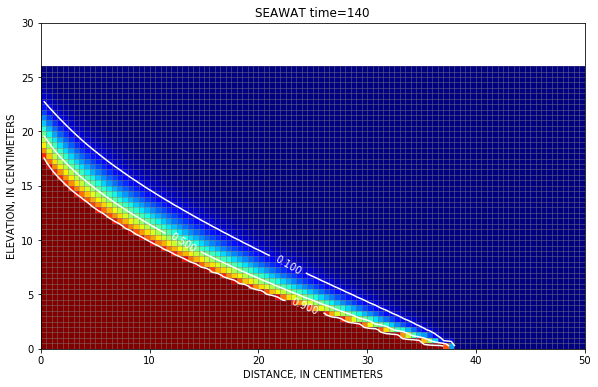

In [148]:
itime = 4
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
xs.plot_grid(linewidths=0.5, alpha=0.5)
xs.plot_array(conc[itime], cmap='jet', vmin=0, vmax=0.0371)
#xs.plot_specific_discharge(splist[0], color='white')
cs = xs.contour_array(conc[itime] / 0.0371, levels=[0.1, .5, .9], colors='white')
ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)
if plot_title:
    ax.set_title('SEAWAT time={}'.format(printtimes[itime]))

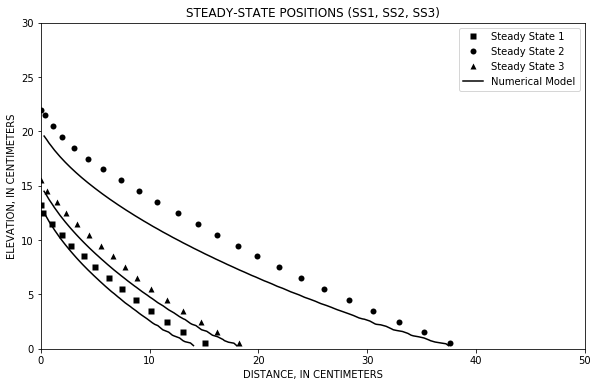

In [149]:
# Figure 5 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[0] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[4] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[8] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ss1x, ss1z, marker='s', mfc='k', mec='none', linestyle='none', label='Steady State 1')[0]
h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
h3 = plt.plot(ss3x, ss3z, marker='^', mfc='k', mec='none', linestyle='none', label='Steady State 3')[0]

black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('STEADY-STATE POSITIONS (SS1, SS2, SS3)')

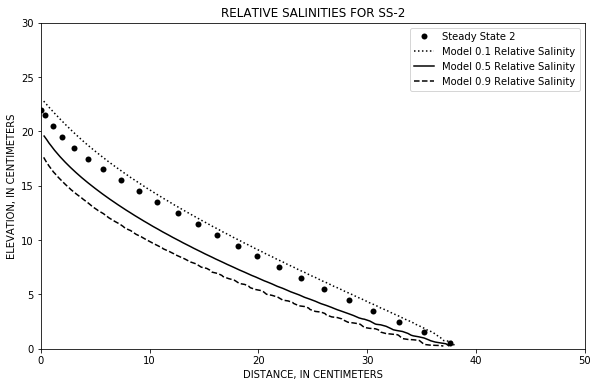

In [150]:
# Figure 6 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[4] / 0.0371, levels=[0.1, .5, .9], linestyles = [':', '-', '--'], colors='k')

h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
dot_line = mlines.Line2D([], [], linestyle=':', color='black', label='Model 0.1 Relative Salinity')
black_line = mlines.Line2D([], [], color='black', label='Model 0.5 Relative Salinity')
dash_line = mlines.Line2D([], [], linestyle='--', color='black', label='Model 0.9 Relative Salinity')

handles = [h2, dot_line, black_line, dash_line]
labels = [h2.get_label(), dot_line.get_label(), black_line.get_label(), dash_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('RELATIVE SALINITIES FOR SS-2')

fname = '../Figures/pxx_goswami6.pdf'
plt.savefig(fname)

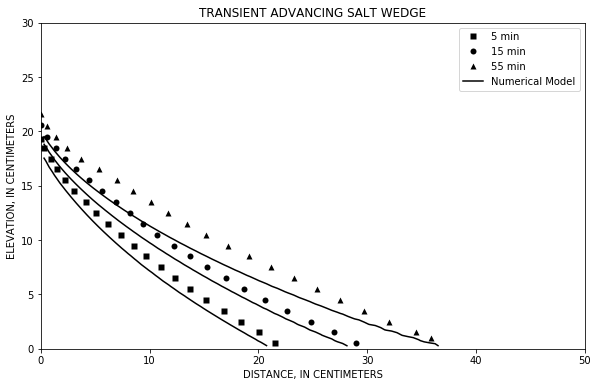

In [151]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[1] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[2] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[3] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ta5x, ta5z, marker='s', mfc='k', mec='none', linestyle='none', label='5 min')[0]
h2 = plt.plot(ta15x, ta15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(ta55x, ta55z, marker='^', mfc='k', mec='none', linestyle='none', label='55 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT ADVANCING SALT WEDGE')

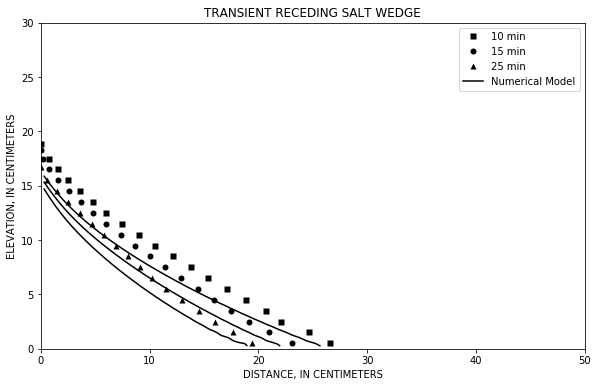

In [152]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[5] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[6] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[7] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(tr10x, tr10z, marker='s', mfc='k', mec='none', linestyle='none', label='10 min')[0]
h2 = plt.plot(tr15x, tr15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(tr25x, tr25z, marker='^', mfc='k', mec='none', linestyle='none', label='25 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT RECEDING SALT WEDGE')

# SEAWAT TVD CHD

In [153]:
ws = 'temp/pxx_goswami_seawat_chd_tvd'
name = 'gswt'
gfact = 1
swt = get_model(ws, name, nlay=gfact*52, ncol=gfact*106,
                general_head_boundary=False, mixelm=-1)
swt.write_input()
fname = os.path.join(ws, 'MT3D001.UCN')
if os.path.isfile(fname):
    os.remove(fname)
swt.run_model()

FloPy is using the following  executable to run the model: /Users/langevin/langevin/bin/mac/swt_v4

                                  SEAWAT Version 4
    U.S. GEOLOGICAL SURVEY MODULAR FINITE-DIFFERENCE GROUND-WATER FLOW MODEL
                             Version 4.00.05 10/19/2012                      

Incorporated MODFLOW Version: 1.18.01 06/20/2008                      
Incorporated MT3DMS  Version: 5.20    10/30/2006                      


 This program is public domain and is released on the
 condition that neither the U.S. Geological Survey nor
 the United States Government may be held liable for any
 damages resulting from their authorized or unauthorized
 use.


 Using NAME file: gswt.nam                                                                                                                                                                                                
 Run start date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:15:33


 STRESS PERIOD NO.    1

  ST

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1185      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   36 FROM TIME =  0.58333     TO   0.60000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.60000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1170      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   37 FROM TIME =  0.60000     TO   0.61667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.61667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1155      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   38 FROM TIME =  0.61667     TO   0.63333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.63333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   73 FROM TIME =   1.2000     TO    1.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8074E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   74 FROM TIME =   1.2167     TO    1.2333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.8010E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   75 FROM TIME =   1.2333     TO    1.2500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7947E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6248E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  110 FROM TIME =   1.8167     TO    1.8333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6209E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  111 FROM TIME =   1.8333     TO    1.8500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6170E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  112 FROM TIME =   1.8500     TO    1.8667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5014E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  148 FROM TIME =   2.4500     TO    2.4667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.4667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4987E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  149 FROM TIME =   2.4667     TO    2.4833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.4833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4961E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  150 FROM TIME =   2.4833     TO    2.5000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.5000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4148E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  186 FROM TIME =   3.0833     TO    3.1000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.1000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4129E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  187 FROM TIME =   3.1000     TO    3.1167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.1167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4110E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  188 FROM TIME =   3.1167     TO    3.1333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.1333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3489E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  225 FROM TIME =   3.7333     TO    3.7500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3474E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  226 FROM TIME =   3.7500     TO    3.7667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3460E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  227 FROM TIME =   3.7667     TO    3.7833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  265 FROM TIME =   4.4000     TO    4.4167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.4167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2958E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  266 FROM TIME =   4.4167     TO    4.4333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.4333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2946E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  267 FROM TIME =   4.4333     TO    4.4500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.4500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2935E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2568E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  304 FROM TIME =   5.0500     TO    5.0667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2559E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  305 FROM TIME =   5.0667     TO    5.0833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2550E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  306 FROM TIME =   5.0833     TO    5.1000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.1000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2228E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  345 FROM TIME =   5.7333     TO    5.7500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2221E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  346 FROM TIME =   5.7500     TO    5.7667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2213E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  347 FROM TIME =   5.7667     TO    5.7833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7833    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP  387 FROM TIME =   6.4333     TO    6.4500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1938E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  388 FROM TIME =   6.4500     TO    6.4667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1932E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  389 FROM TIME =   6.4667     TO    6.4833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1926E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  390 FRO


  STRESS PERIOD    1 TIME STEP  429 FROM TIME =   7.1333     TO    7.1500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  430 FROM TIME =   7.1500     TO    7.1667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1700E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  431 FROM TIME =   7.1667     TO    7.1833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  432 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1547E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  472 FROM TIME =   7.8500     TO    7.8667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1548E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  473 FROM TIME =   7.8667     TO    7.8833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1549E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  474 FROM TIME =   7.8833     TO    7.9000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.9000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  515 FROM TIME =   8.5667     TO    8.5833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.5833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  516 FROM TIME =   8.5833     TO    8.6000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.6000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  517 FROM TIME =   8.6000     TO    8.6167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.6167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1627E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  559 FROM TIME =   9.3000     TO    9.3167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1627E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  560 FROM TIME =   9.3167     TO    9.3333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1627E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  561 FROM TIME =   9.3333     TO    9.3500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3500    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  604 FROM TIME =   10.050     TO    10.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1586E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  605 FROM TIME =   10.067     TO    10.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  606 FROM TIME =   10.083     TO    10.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.100    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1569E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  649 FROM TIME =   10.800     TO    10.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  650 FROM TIME =   10.817     TO    10.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1572E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  651 FROM TIME =   10.833     TO    10.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1613E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  694 FROM TIME =   11.550     TO    11.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1614E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  695 FROM TIME =   11.567     TO    11.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  696 FROM TIME =   11.583     TO    11.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  739 FROM TIME =   12.300     TO    12.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  740 FROM TIME =   12.317     TO    12.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1659E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  741 FROM TIME =   12.333     TO    12.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  786 FROM TIME =   13.083     TO    13.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  787 FROM TIME =   13.100     TO    13.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  788 FROM TIME =   13.117     TO    13.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  834 FROM TIME =   13.883     TO    13.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  835 FROM TIME =   13.900     TO    13.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  836 FROM TIME =   13.917     TO    13.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  882 FROM TIME =   14.683     TO    14.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1738E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  883 FROM TIME =   14.700     TO    14.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1739E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  884 FROM TIME =   14.717     TO    14.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1739E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1754E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  930 FROM TIME =   15.483     TO    15.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1754E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  931 FROM TIME =   15.500     TO    15.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1754E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  932 FROM TIME =   15.517     TO    15.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.533    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1760E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  977 FROM TIME =   16.267     TO    16.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1760E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  978 FROM TIME =   16.283     TO    16.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1760E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  979 FROM TIME =   16.300     TO    16.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.317    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1759E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1025 FROM TIME =   17.067     TO    17.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1759E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1026 FROM TIME =   17.083     TO    17.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1759E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1027 FROM TIME =   17.100     TO    17.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.117    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1753E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1073 FROM TIME =   17.867     TO    17.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1753E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1074 FROM TIME =   17.883     TO    17.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1753E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1075 FROM TIME =   17.900     TO    17.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.917    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1122 FROM TIME =   18.683     TO    18.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1123 FROM TIME =   18.700     TO    18.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1124 FROM TIME =   18.717     TO    18.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.733    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1744E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1171 FROM TIME =   19.500     TO    19.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1744E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1172 FROM TIME =   19.517     TO    19.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1744E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1173 FROM TIME =   19.533     TO    19.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1219 FROM TIME =   20.300     TO    20.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1741E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1220 FROM TIME =   20.317     TO    20.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1741E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1221 FROM TIME =   20.333     TO    20.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1740E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1222 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1737E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1269 FROM TIME =   21.133     TO    21.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1737E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1270 FROM TIME =   21.150     TO    21.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1737E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1271 FROM TIME =   21.167     TO    21.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.183    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1734E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1319 FROM TIME =   21.967     TO    21.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1734E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1320 FROM TIME =   21.983     TO    22.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1734E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1321 FROM TIME =   22.000     TO    22.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.017    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1369 FROM TIME =   22.800     TO    22.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1370 FROM TIME =   22.817     TO    22.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1371 FROM TIME =   22.833     TO    22.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1372 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1419 FROM TIME =   23.633     TO    23.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1420 FROM TIME =   23.650     TO    23.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1421 FROM TIME =   23.667     TO    23.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.683    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1470 FROM TIME =   24.483     TO    24.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1471 FROM TIME =   24.500     TO    24.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1472 FROM TIME =   24.517     TO    24.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.533    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1496 FROM TIME =   24.917     TO    24.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1497 FROM TIME =   24.933     TO    24.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1498 FROM TIME =   24.950     TO    24.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1522 FROM TIME =   25.350     TO    25.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1523 FROM TIME =   25.367     TO    25.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1524 FROM TIME =   25.383     TO    25.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.400    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1548 FROM TIME =   25.783     TO    25.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1549 FROM TIME =   25.800     TO    25.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1550 FROM TIME =   25.817     TO    25.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.833    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1599 FROM TIME =   26.633     TO    26.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1600 FROM TIME =   26.650     TO    26.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1601 FROM TIME =   26.667     TO    26.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1602 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1626 FROM TIME =   27.083     TO    27.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1627 FROM TIME =   27.100     TO    27.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1628 FROM TIME =   27.117     TO    27.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1653 FROM TIME =   27.533     TO    27.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1654 FROM TIME =   27.550     TO    27.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1655 FROM TIME =   27.567     TO    27.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.583    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1680 FROM TIME =   27.983     TO    28.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1681 FROM TIME =   28.000     TO    28.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1682 FROM TIME =   28.017     TO    28.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1707 FROM TIME =   28.433     TO    28.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1708 FROM TIME =   28.450     TO    28.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1709 FROM TIME =   28.467     TO    28.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1735 FROM TIME =   28.900     TO    28.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1736 FROM TIME =   28.917     TO    28.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1737 FROM TIME =   28.933     TO    28.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.950    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1762 FROM TIME =   29.350     TO    29.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1763 FROM TIME =   29.367     TO    29.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1764 FROM TIME =   29.383     TO    29.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1765 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1789 FROM TIME =   29.800     TO    29.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1790 FROM TIME =   29.817     TO    29.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1791 FROM TIME =   29.833     TO    29.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1816 FROM TIME =   30.250     TO    30.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1817 FROM TIME =   30.267     TO    30.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1818 FROM TIME =   30.283     TO    30.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.300    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1843 FROM TIME =   30.700     TO    30.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1844 FROM TIME =   30.717     TO    30.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1845 FROM TIME =   30.733     TO    30.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.750    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1870 FROM TIME =   31.150     TO    31.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1871 FROM TIME =   31.167     TO    31.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1872 FROM TIME =   31.183     TO    31.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.200    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1897 FROM TIME =   31.600     TO    31.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1898 FROM TIME =   31.617     TO    31.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1899 FROM TIME =   31.633     TO    31.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.650    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1924 FROM TIME =   32.050     TO    32.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1925 FROM TIME =   32.067     TO    32.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1926 FROM TIME =   32.083     TO    32.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.100    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1951 FROM TIME =   32.500     TO    32.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1952 FROM TIME =   32.517     TO    32.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1953 FROM TIME =   32.533     TO    32.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1978 FROM TIME =   32.950     TO    32.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1979 FROM TIME =   32.967     TO    32.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1980 FROM TIME =   32.983     TO    33.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2005 FROM TIME =   33.400     TO    33.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2006 FROM TIME =   33.417     TO    33.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2007 FROM TIME =   33.433     TO    33.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.450    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2032 FROM TIME =   33.850     TO    33.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2033 FROM TIME =   33.867     TO    33.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2034 FROM TIME =   33.883     TO    33.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.900    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2059 FROM TIME =   34.300     TO    34.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2060 FROM TIME =   34.317     TO    34.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2061 FROM TIME =   34.333     TO    34.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2087 FROM TIME =   34.767     TO    34.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2088 FROM TIME =   34.783     TO    34.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2089 FROM TIME =   34.800     TO    34.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2115 FROM TIME =   35.233     TO    35.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2116 FROM TIME =   35.250     TO    35.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2117 FROM TIME =   35.267     TO    35.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2143 FROM TIME =   35.700     TO    35.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2144 FROM TIME =   35.717     TO    35.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2145 FROM TIME =   35.733     TO    35.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2146 FRO


  STRESS PERIOD    1 TIME STEP 2171 FROM TIME =   36.167     TO    36.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2172 FROM TIME =   36.183     TO    36.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2173 FROM TIME =   36.200     TO    36.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2174 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2200 FROM TIME =   36.650     TO    36.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2201 FROM TIME =   36.667     TO    36.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2202 FROM TIME =   36.683     TO    36.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.700    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2229 FROM TIME =   37.133     TO    37.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2230 FROM TIME =   37.150     TO    37.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2231 FROM TIME =   37.167     TO    37.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.183    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2258 FROM TIME =   37.617     TO    37.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2259 FROM TIME =   37.633     TO    37.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2260 FROM TIME =   37.650     TO    37.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2287 FROM TIME =   38.100     TO    38.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2288 FROM TIME =   38.117     TO    38.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2289 FROM TIME =   38.133     TO    38.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2316 FROM TIME =   38.583     TO    38.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2317 FROM TIME =   38.600     TO    38.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2318 FROM TIME =   38.617     TO    38.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.633    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2345 FROM TIME =   39.067     TO    39.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2346 FROM TIME =   39.083     TO    39.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2347 FROM TIME =   39.100     TO    39.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2374 FROM TIME =   39.550     TO    39.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2375 FROM TIME =   39.567     TO    39.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2376 FROM TIME =   39.583     TO    39.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2403 FROM TIME =   40.033     TO    40.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2404 FROM TIME =   40.050     TO    40.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2405 FROM TIME =   40.067     TO    40.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2432 FROM TIME =   40.517     TO    40.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2433 FROM TIME =   40.533     TO    40.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2434 FROM TIME =   40.550     TO    40.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2461 FROM TIME =   41.000     TO    41.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2462 FROM TIME =   41.017     TO    41.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2463 FROM TIME =   41.033     TO    41.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2464 FRO


  STRESS PERIOD    1 TIME STEP 2488 FROM TIME =   41.450     TO    41.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2489 FROM TIME =   41.467     TO    41.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2490 FROM TIME =   41.483     TO    41.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2491 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2517 FROM TIME =   41.933     TO    41.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2518 FROM TIME =   41.950     TO    41.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2519 FROM TIME =   41.967     TO    41.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2546 FROM TIME =   42.417     TO    42.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2547 FROM TIME =   42.433     TO    42.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2548 FROM TIME =   42.450     TO    42.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2549 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2576 FROM TIME =   42.917     TO    42.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2577 FROM TIME =   42.933     TO    42.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2578 FROM TIME =   42.950     TO    42.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2606 FROM TIME =   43.417     TO    43.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2607 FROM TIME =   43.433     TO    43.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2608 FROM TIME =   43.450     TO    43.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2609 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2637 FROM TIME =   43.933     TO    43.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2638 FROM TIME =   43.950     TO    43.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2639 FROM TIME =   43.967     TO    43.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2668 FROM TIME =   44.450     TO    44.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2669 FROM TIME =   44.467     TO    44.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2670 FROM TIME =   44.483     TO    44.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.500    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2698 FROM TIME =   44.950     TO    44.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2699 FROM TIME =   44.967     TO    44.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2700 FROM TIME =   44.983     TO    45.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2701 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2729 FROM TIME =   45.467     TO    45.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2730 FROM TIME =   45.483     TO    45.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2731 FROM TIME =   45.500     TO    45.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.517    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2760 FROM TIME =   45.983     TO    46.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2761 FROM TIME =   46.000     TO    46.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2762 FROM TIME =   46.017     TO    46.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2763 FRO


  STRESS PERIOD    1 TIME STEP 2792 FROM TIME =   46.517     TO    46.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2793 FROM TIME =   46.533     TO    46.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2794 FROM TIME =   46.550     TO    46.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2795 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2824 FROM TIME =   47.050     TO    47.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2825 FROM TIME =   47.067     TO    47.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2826 FROM TIME =   47.083     TO    47.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.100    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2854 FROM TIME =   47.550     TO    47.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2855 FROM TIME =   47.567     TO    47.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2856 FROM TIME =   47.583     TO    47.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2882 FROM TIME =   48.017     TO    48.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2883 FROM TIME =   48.033     TO    48.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2884 FROM TIME =   48.050     TO    48.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2885 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2915 FROM TIME =   48.567     TO    48.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2916 FROM TIME =   48.583     TO    48.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2917 FROM TIME =   48.600     TO    48.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.617    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2948 FROM TIME =   49.117     TO    49.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2949 FROM TIME =   49.133     TO    49.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2950 FROM TIME =   49.150     TO    49.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2981 FROM TIME =   49.667     TO    49.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2982 FROM TIME =   49.683     TO    49.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2983 FROM TIME =   49.700     TO    49.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.717    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3015 FROM TIME =   50.233     TO    50.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3016 FROM TIME =   50.250     TO    50.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3017 FROM TIME =   50.267     TO    50.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3049 FROM TIME =   50.800     TO    50.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3050 FROM TIME =   50.817     TO    50.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3051 FROM TIME =   50.833     TO    50.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3052 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3084 FROM TIME =   51.383     TO    51.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3085 FROM TIME =   51.400     TO    51.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3086 FROM TIME =   51.417     TO    51.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.433    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3119 FROM TIME =   51.967     TO    51.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3120 FROM TIME =   51.983     TO    52.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3121 FROM TIME =   52.000     TO    52.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.017    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3154 FROM TIME =   52.550     TO    52.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3155 FROM TIME =   52.567     TO    52.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3156 FROM TIME =   52.583     TO    52.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3157 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3190 FROM TIME =   53.150     TO    53.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3191 FROM TIME =   53.167     TO    53.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3192 FROM TIME =   53.183     TO    53.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3226 FROM TIME =   53.750     TO    53.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3227 FROM TIME =   53.767     TO    53.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3228 FROM TIME =   53.783     TO    53.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.800    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3262 FROM TIME =   54.350     TO    54.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3263 FROM TIME =   54.367     TO    54.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3264 FROM TIME =   54.383     TO    54.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3265 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3299 FROM TIME =   54.967     TO    54.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3300 FROM TIME =   54.983     TO    55.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3301 FROM TIME =   55.000     TO    55.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.017    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3336 FROM TIME =   55.583     TO    55.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3337 FROM TIME =   55.600     TO    55.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3338 FROM TIME =   55.617     TO    55.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.633    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3373 FROM TIME =   56.200     TO    56.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3374 FROM TIME =   56.217     TO    56.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3375 FROM TIME =   56.233     TO    56.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3411 FROM TIME =   56.833     TO    56.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3412 FROM TIME =   56.850     TO    56.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3413 FROM TIME =   56.867     TO    56.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.883    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3449 FROM TIME =   57.467     TO    57.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3450 FROM TIME =   57.483     TO    57.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3451 FROM TIME =   57.500     TO    57.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3452 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3488 FROM TIME =   58.117     TO    58.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3489 FROM TIME =   58.133     TO    58.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3490 FROM TIME =   58.150     TO    58.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3528 FROM TIME =   58.783     TO    58.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3529 FROM TIME =   58.800     TO    58.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3530 FROM TIME =   58.817     TO    58.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.833    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3567 FROM TIME =   59.433     TO    59.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3568 FROM TIME =   59.450     TO    59.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3569 FROM TIME =   59.467     TO    59.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3570 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6255E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    4 FROM TIME =   60.050     TO    60.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6233E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    5 FROM TIME =   60.067     TO    60.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6211E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    6 FROM TIME =   60.083     TO    60.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.100    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   41 FROM TIME =   60.667     TO    60.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5503E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   42 FROM TIME =   60.683     TO    60.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5481E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   43 FROM TIME =   60.700     TO    60.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5464E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4948E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   77 FROM TIME =   61.267     TO    61.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4934E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   78 FROM TIME =   61.283     TO    61.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4920E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   79 FROM TIME =   61.300     TO    61.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.317    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4467E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  114 FROM TIME =   61.883     TO    61.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4456E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  115 FROM TIME =   61.900     TO    61.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4444E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  116 FROM TIME =   61.917     TO    61.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4062E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  152 FROM TIME =   62.517     TO    62.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4053E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  153 FROM TIME =   62.533     TO    62.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4043E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  154 FROM TIME =   62.550     TO    62.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3721E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  190 FROM TIME =   63.150     TO    63.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3712E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  191 FROM TIME =   63.167     TO    63.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3703E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  192 FROM TIME =   63.183     TO    63.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.200    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  228 FROM TIME =   63.783     TO    63.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3423E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  229 FROM TIME =   63.800     TO    63.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3416E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  230 FROM TIME =   63.817     TO    63.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3410E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  231 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3169E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  267 FROM TIME =   64.433     TO    64.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3163E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  268 FROM TIME =   64.450     TO    64.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3157E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  269 FROM TIME =   64.467     TO    64.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  304 FROM TIME =   65.050     TO    65.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2951E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  305 FROM TIME =   65.067     TO    65.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2946E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  306 FROM TIME =   65.083     TO    65.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2941E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  307 FRO


  STRESS PERIOD    2 TIME STEP  341 FROM TIME =   65.667     TO    65.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2763E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  342 FROM TIME =   65.683     TO    65.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2758E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  343 FROM TIME =   65.700     TO    65.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2753E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  344 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2590E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  380 FROM TIME =   66.317     TO    66.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2585E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  381 FROM TIME =   66.333     TO    66.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2581E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  382 FROM TIME =   66.350     TO    66.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.367    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  419 FROM TIME =   66.967     TO    66.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2428E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  420 FROM TIME =   66.983     TO    67.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2424E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  421 FROM TIME =   67.000     TO    67.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2420E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  422 FRO


  STRESS PERIOD    2 TIME STEP  458 FROM TIME =   67.617     TO    67.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2286E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  459 FROM TIME =   67.633     TO    67.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2283E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  460 FROM TIME =   67.650     TO    67.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2280E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  461 FRO


  STRESS PERIOD    2 TIME STEP  497 FROM TIME =   68.267     TO    68.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2158E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  498 FROM TIME =   68.283     TO    68.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2155E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  499 FROM TIME =   68.300     TO    68.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2152E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  500 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2042E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  537 FROM TIME =   68.933     TO    68.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2039E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  538 FROM TIME =   68.950     TO    68.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2037E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  539 FROM TIME =   68.967     TO    68.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1930E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  578 FROM TIME =   69.617     TO    69.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1928E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  579 FROM TIME =   69.633     TO    69.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1925E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  580 FROM TIME =   69.650     TO    69.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  620 FROM TIME =   70.317     TO    70.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  621 FROM TIME =   70.333     TO    70.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1822E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  622 FROM TIME =   70.350     TO    70.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.367    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  663 FROM TIME =   71.033     TO    71.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  664 FROM TIME =   71.050     TO    71.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  665 FROM TIME =   71.067     TO    71.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  707 FROM TIME =   71.767     TO    71.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  708 FROM TIME =   71.783     TO    71.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1751E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  709 FROM TIME =   71.800     TO    71.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  751 FROM TIME =   72.500     TO    72.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  752 FROM TIME =   72.517     TO    72.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  753 FROM TIME =   72.533     TO    72.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1745E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  794 FROM TIME =   73.217     TO    73.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1745E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  795 FROM TIME =   73.233     TO    73.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1745E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  796 FROM TIME =   73.250     TO    73.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.267    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  836 FROM TIME =   73.917     TO    73.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  837 FROM TIME =   73.933     TO    73.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  838 FROM TIME =   73.950     TO    73.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  879 FROM TIME =   74.633     TO    74.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  880 FROM TIME =   74.650     TO    74.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  881 FROM TIME =   74.667     TO    74.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.683    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  920 FROM TIME =   75.317     TO    75.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1669E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  921 FROM TIME =   75.333     TO    75.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1670E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  922 FROM TIME =   75.350     TO    75.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1671E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  923 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1705E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  962 FROM TIME =   76.017     TO    76.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  963 FROM TIME =   76.033     TO    76.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  964 FROM TIME =   76.050     TO    76.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.067    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1002 FROM TIME =   76.683     TO    76.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1003 FROM TIME =   76.700     TO    76.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1004 FROM TIME =   76.717     TO    76.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1005 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1755E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1045 FROM TIME =   77.400     TO    77.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1755E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1046 FROM TIME =   77.417     TO    77.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1756E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1047 FROM TIME =   77.433     TO    77.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.450    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1779E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1089 FROM TIME =   78.133     TO    78.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1780E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1090 FROM TIME =   78.150     TO    78.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1780E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1091 FROM TIME =   78.167     TO    78.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.183    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1133 FROM TIME =   78.867     TO    78.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1134 FROM TIME =   78.883     TO    78.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1801E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1135 FROM TIME =   78.900     TO    78.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.917    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1812E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1177 FROM TIME =   79.600     TO    79.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1812E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1178 FROM TIME =   79.617     TO    79.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1812E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1179 FROM TIME =   79.633     TO    79.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.650    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1221 FROM TIME =   80.333     TO    80.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1222 FROM TIME =   80.350     TO    80.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1223 FROM TIME =   80.367     TO    80.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.383    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1826E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1266 FROM TIME =   81.083     TO    81.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1826E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1267 FROM TIME =   81.100     TO    81.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1826E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1268 FROM TIME =   81.117     TO    81.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1310 FROM TIME =   81.817     TO    81.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1311 FROM TIME =   81.833     TO    81.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1312 FROM TIME =   81.850     TO    81.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1354 FROM TIME =   82.550     TO    82.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1355 FROM TIME =   82.567     TO    82.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1356 FROM TIME =   82.583     TO    82.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1398 FROM TIME =   83.283     TO    83.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1399 FROM TIME =   83.300     TO    83.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1400 FROM TIME =   83.317     TO    83.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1816E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1443 FROM TIME =   84.033     TO    84.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1816E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1444 FROM TIME =   84.050     TO    84.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1816E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1445 FROM TIME =   84.067     TO    84.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1810E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1488 FROM TIME =   84.783     TO    84.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1810E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1489 FROM TIME =   84.800     TO    84.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1809E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1490 FROM TIME =   84.817     TO    84.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.833    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1532 FROM TIME =   85.517     TO    85.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1802E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1533 FROM TIME =   85.533     TO    85.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1801E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1534 FROM TIME =   85.550     TO    85.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1801E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1535 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1788E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1578 FROM TIME =   86.283     TO    86.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1787E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1579 FROM TIME =   86.300     TO    86.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1787E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1580 FROM TIME =   86.317     TO    86.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1775E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1624 FROM TIME =   87.050     TO    87.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1775E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1625 FROM TIME =   87.067     TO    87.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1774E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1626 FROM TIME =   87.083     TO    87.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.100    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1764E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1668 FROM TIME =   87.783     TO    87.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1764E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1669 FROM TIME =   87.800     TO    87.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1764E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1670 FROM TIME =   87.817     TO    87.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.833    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1712 FROM TIME =   88.517     TO    88.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1751E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1713 FROM TIME =   88.533     TO    88.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1714 FROM TIME =   88.550     TO    88.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1715 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1756 FROM TIME =   89.250     TO    89.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1757 FROM TIME =   89.267     TO    89.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1758 FROM TIME =   89.283     TO    89.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.300    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1798 FROM TIME =   89.950     TO    89.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1799 FROM TIME =   89.967     TO    89.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1800 FROM TIME =   89.983     TO    90.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1740E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1842 FROM TIME =   90.683     TO    90.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1741E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1843 FROM TIME =   90.700     TO    90.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1741E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1844 FROM TIME =   90.717     TO    90.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.733    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1884 FROM TIME =   91.383     TO    91.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1753E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1885 FROM TIME =   91.400     TO    91.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1754E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1886 FROM TIME =   91.417     TO    91.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1754E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1887 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1762E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1923 FROM TIME =   92.033     TO    92.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1762E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1924 FROM TIME =   92.050     TO    92.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1763E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1925 FROM TIME =   92.067     TO    92.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1964 FROM TIME =   92.717     TO    92.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1965 FROM TIME =   92.733     TO    92.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1966 FROM TIME =   92.750     TO    92.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.767    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2007 FROM TIME =   93.433     TO    93.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2008 FROM TIME =   93.450     TO    93.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2009 FROM TIME =   93.467     TO    93.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2051 FROM TIME =   94.167     TO    94.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1791E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2052 FROM TIME =   94.183     TO    94.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1791E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2053 FROM TIME =   94.200     TO    94.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1792E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2054 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2096 FROM TIME =   94.917     TO    94.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2097 FROM TIME =   94.933     TO    94.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2098 FROM TIME =   94.950     TO    94.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1808E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2141 FROM TIME =   95.667     TO    95.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1808E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2142 FROM TIME =   95.683     TO    95.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1808E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2143 FROM TIME =   95.700     TO    95.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.717    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1815E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2186 FROM TIME =   96.417     TO    96.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1815E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2187 FROM TIME =   96.433     TO    96.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1815E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2188 FROM TIME =   96.450     TO    96.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.467    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2231 FROM TIME =   97.167     TO    97.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2232 FROM TIME =   97.183     TO    97.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1821E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2233 FROM TIME =   97.200     TO    97.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1822E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2234 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2277 FROM TIME =   97.933     TO    97.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2278 FROM TIME =   97.950     TO    97.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2279 FROM TIME =   97.967     TO    97.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1832E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2318 FROM TIME =   98.617     TO    98.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1832E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2319 FROM TIME =   98.633     TO    98.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1832E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2320 FROM TIME =   98.650     TO    98.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1836E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2363 FROM TIME =   99.367     TO    99.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1836E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2364 FROM TIME =   99.383     TO    99.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1836E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2365 FROM TIME =   99.400     TO    99.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.417    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1842E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2409 FROM TIME =   100.13     TO    100.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1842E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2410 FROM TIME =   100.15     TO    100.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1842E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2411 FROM TIME =   100.17     TO    100.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1846E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2455 FROM TIME =   100.90     TO    100.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1846E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2456 FROM TIME =   100.92     TO    100.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1846E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2457 FROM TIME =   100.93     TO    100.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1850E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2501 FROM TIME =   101.67     TO    101.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1850E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2502 FROM TIME =   101.68     TO    101.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1850E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2503 FROM TIME =   101.70     TO    101.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1854E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2547 FROM TIME =   102.43     TO    102.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1854E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2548 FROM TIME =   102.45     TO    102.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1854E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2549 FROM TIME =   102.47     TO    102.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.48    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1858E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2594 FROM TIME =   103.22     TO    103.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1858E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2595 FROM TIME =   103.23     TO    103.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1858E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2596 FROM TIME =   103.25     TO    103.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1861E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2641 FROM TIME =   104.00     TO    104.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1861E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2642 FROM TIME =   104.02     TO    104.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1861E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2643 FROM TIME =   104.03     TO    104.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1864E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2687 FROM TIME =   104.77     TO    104.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1864E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2688 FROM TIME =   104.78     TO    104.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1864E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2689 FROM TIME =   104.80     TO    104.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.82    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1866E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2728 FROM TIME =   105.45     TO    105.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1866E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2729 FROM TIME =   105.47     TO    105.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1866E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2730 FROM TIME =   105.48     TO    105.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1868E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2776 FROM TIME =   106.25     TO    106.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1869E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2777 FROM TIME =   106.27     TO    106.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1869E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2778 FROM TIME =   106.28     TO    106.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.30    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1871E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2824 FROM TIME =   107.05     TO    107.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1871E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2825 FROM TIME =   107.07     TO    107.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1871E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2826 FROM TIME =   107.08     TO    107.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1873E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2872 FROM TIME =   107.85     TO    107.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1873E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2873 FROM TIME =   107.87     TO    107.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1873E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2874 FROM TIME =   107.88     TO    107.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1874E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2920 FROM TIME =   108.65     TO    108.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1874E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2921 FROM TIME =   108.67     TO    108.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1874E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2922 FROM TIME =   108.68     TO    108.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1876E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2969 FROM TIME =   109.47     TO    109.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1876E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2970 FROM TIME =   109.48     TO    109.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1876E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2971 FROM TIME =   109.50     TO    109.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.52    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1878E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3019 FROM TIME =   110.30     TO    110.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1878E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3020 FROM TIME =   110.32     TO    110.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1878E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3021 FROM TIME =   110.33     TO    110.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.35    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3068 FROM TIME =   111.12     TO    111.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1880E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3069 FROM TIME =   111.13     TO    111.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1880E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3070 FROM TIME =   111.15     TO    111.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1880E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3071 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1881E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3117 FROM TIME =   111.93     TO    111.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1881E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3118 FROM TIME =   111.95     TO    111.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1881E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3119 FROM TIME =   111.97     TO    111.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1883E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3166 FROM TIME =   112.75     TO    112.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1883E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3167 FROM TIME =   112.77     TO    112.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1883E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3168 FROM TIME =   112.78     TO    112.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3214 FROM TIME =   113.55     TO    113.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3215 FROM TIME =   113.57     TO    113.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3216 FROM TIME =   113.58     TO    113.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3262 FROM TIME =   114.35     TO    114.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3263 FROM TIME =   114.37     TO    114.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1884E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3264 FROM TIME =   114.38     TO    114.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1885E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3310 FROM TIME =   115.15     TO    115.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1885E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3311 FROM TIME =   115.17     TO    115.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1885E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3312 FROM TIME =   115.18     TO    115.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3358 FROM TIME =   115.95     TO    115.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3359 FROM TIME =   115.97     TO    115.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3360 FROM TIME =   115.98     TO    116.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3361 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3407 FROM TIME =   116.77     TO    116.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3408 FROM TIME =   116.78     TO    116.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1886E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3409 FROM TIME =   116.80     TO    116.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.82    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3456 FROM TIME =   117.58     TO    117.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3457 FROM TIME =   117.60     TO    117.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3458 FROM TIME =   117.62     TO    117.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3505 FROM TIME =   118.40     TO    118.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3506 FROM TIME =   118.42     TO    118.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3507 FROM TIME =   118.43     TO    118.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.45    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3554 FROM TIME =   119.22     TO    119.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3555 FROM TIME =   119.23     TO    119.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3556 FROM TIME =   119.25     TO    119.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3603 FROM TIME =   120.03     TO    120.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3604 FROM TIME =   120.05     TO    120.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3605 FROM TIME =   120.07     TO    120.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3653 FROM TIME =   120.87     TO    120.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3654 FROM TIME =   120.88     TO    120.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3655 FROM TIME =   120.90     TO    120.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.92    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3703 FROM TIME =   121.70     TO    121.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3704 FROM TIME =   121.72     TO    121.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3705 FROM TIME =   121.73     TO    121.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3751 FROM TIME =   122.50     TO    122.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3752 FROM TIME =   122.52     TO    122.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3753 FROM TIME =   122.53     TO    122.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.55    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3799 FROM TIME =   123.30     TO    123.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3800 FROM TIME =   123.32     TO    123.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3801 FROM TIME =   123.33     TO    123.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3802 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3848 FROM TIME =   124.12     TO    124.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3849 FROM TIME =   124.13     TO    124.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3850 FROM TIME =   124.15     TO    124.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.17    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3898 FROM TIME =   124.95     TO    124.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3899 FROM TIME =   124.97     TO    124.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3900 FROM TIME =   124.98     TO    125.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.00    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3947 FROM TIME =   125.77     TO    125.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3948 FROM TIME =   125.78     TO    125.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3949 FROM TIME =   125.80     TO    125.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.82    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3996 FROM TIME =   126.58     TO    126.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3997 FROM TIME =   126.60     TO    126.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3998 FROM TIME =   126.62     TO    126.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3999 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4046 FROM TIME =   127.42     TO    127.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4047 FROM TIME =   127.43     TO    127.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4048 FROM TIME =   127.45     TO    127.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4072 FROM TIME =   127.85     TO    127.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4073 FROM TIME =   127.87     TO    127.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4074 FROM TIME =   127.88     TO    127.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4098 FROM TIME =   128.28     TO    128.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4099 FROM TIME =   128.30     TO    128.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4100 FROM TIME =   128.32     TO    128.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4124 FROM TIME =   128.72     TO    128.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4125 FROM TIME =   128.73     TO    128.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4126 FROM TIME =   128.75     TO    128.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4150 FROM TIME =   129.15     TO    129.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4151 FROM TIME =   129.17     TO    129.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4152 FROM TIME =   129.18     TO    129.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4176 FROM TIME =   129.58     TO    129.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4177 FROM TIME =   129.60     TO    129.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4178 FROM TIME =   129.62     TO    129.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4202 FROM TIME =   130.02     TO    130.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4203 FROM TIME =   130.03     TO    130.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4204 FROM TIME =   130.05     TO    130.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4228 FROM TIME =   130.45     TO    130.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4229 FROM TIME =   130.47     TO    130.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4230 FROM TIME =   130.48     TO    130.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4254 FROM TIME =   130.88     TO    130.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4255 FROM TIME =   130.90     TO    130.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4256 FROM TIME =   130.92     TO    130.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4280 FROM TIME =   131.32     TO    131.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4281 FROM TIME =   131.33     TO    131.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4282 FROM TIME =   131.35     TO    131.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.37    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4306 FROM TIME =   131.75     TO    131.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4307 FROM TIME =   131.77     TO    131.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4308 FROM TIME =   131.78     TO    131.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4357 FROM TIME =   132.60     TO    132.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4358 FROM TIME =   132.62     TO    132.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4359 FROM TIME =   132.63     TO    132.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4407 FROM TIME =   133.43     TO    133.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4408 FROM TIME =   133.45     TO    133.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4409 FROM TIME =   133.47     TO    133.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4410 FRO


  STRESS PERIOD    2 TIME STEP 4458 FROM TIME =   134.28     TO    134.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4459 FROM TIME =   134.30     TO    134.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4460 FROM TIME =   134.32     TO    134.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1889E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4461 FRO


  STRESS PERIOD    2 TIME STEP 4509 FROM TIME =   135.13     TO    135.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4510 FROM TIME =   135.15     TO    135.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4511 FROM TIME =   135.17     TO    135.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4512 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4560 FROM TIME =   135.98     TO    136.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4561 FROM TIME =   136.00     TO    136.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4562 FROM TIME =   136.02     TO    136.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4586 FROM TIME =   136.42     TO    136.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4587 FROM TIME =   136.43     TO    136.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4588 FROM TIME =   136.45     TO    136.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4612 FROM TIME =   136.85     TO    136.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4613 FROM TIME =   136.87     TO    136.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4614 FROM TIME =   136.88     TO    136.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4638 FROM TIME =   137.28     TO    137.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4639 FROM TIME =   137.30     TO    137.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4640 FROM TIME =   137.32     TO    137.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4664 FROM TIME =   137.72     TO    137.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4665 FROM TIME =   137.73     TO    137.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4666 FROM TIME =   137.75     TO    137.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4690 FROM TIME =   138.15     TO    138.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4691 FROM TIME =   138.17     TO    138.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4692 FROM TIME =   138.18     TO    138.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4741 FROM TIME =   139.00     TO    139.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4742 FROM TIME =   139.02     TO    139.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1888E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4743 FROM TIME =   139.03     TO    139.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4792 FROM TIME =   139.85     TO    139.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4793 FROM TIME =   139.87     TO    139.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1887E-01  [K,I,J]   11    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4794 FROM TIME =   139.88     TO    139.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3712E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   32 FROM TIME =   140.52     TO    140.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3707E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   33 FROM TIME =   140.53     TO    140.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3702E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   34 FROM TIME =   140.55     TO    140.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3514E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   72 FROM TIME =   141.18     TO    141.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3509E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   73 FROM TIME =   141.20     TO    141.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3504E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   74 FROM TIME =   141.22     TO    141.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3332E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  112 FROM TIME =   141.85     TO    141.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3327E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  113 FROM TIME =   141.87     TO    141.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3323E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  114 FROM TIME =   141.88     TO    141.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3158E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  153 FROM TIME =   142.53     TO    142.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3154E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  154 FROM TIME =   142.55     TO    142.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3150E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  155 FROM TIME =   142.57     TO    142.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2995E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  194 FROM TIME =   143.22     TO    143.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2992E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  195 FROM TIME =   143.23     TO    143.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2988E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  196 FROM TIME =   143.25     TO    143.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.27    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  233 FROM TIME =   143.87     TO    143.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2847E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  234 FROM TIME =   143.88     TO    143.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2843E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  235 FROM TIME =   143.90     TO    143.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2839E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  236 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2716E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  271 FROM TIME =   144.50     TO    144.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2712E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  272 FROM TIME =   144.52     TO    144.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2709E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  273 FROM TIME =   144.53     TO    144.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.55    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2581E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  311 FROM TIME =   145.17     TO    145.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2578E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  312 FROM TIME =   145.18     TO    145.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2574E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  313 FROM TIME =   145.20     TO    145.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2455E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  350 FROM TIME =   145.82     TO    145.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2452E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  351 FROM TIME =   145.83     TO    145.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2449E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  352 FROM TIME =   145.85     TO    145.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.87    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  390 FROM TIME =   146.48     TO    146.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2329E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  391 FROM TIME =   146.50     TO    146.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2326E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  392 FROM TIME =   146.52     TO    146.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2323E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2208E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  432 FROM TIME =   147.18     TO    147.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2205E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  433 FROM TIME =   147.20     TO    147.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2202E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  434 FROM TIME =   147.22     TO    147.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2089E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  474 FROM TIME =   147.88     TO    147.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2086E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  475 FROM TIME =   147.90     TO    147.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2084E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  476 FROM TIME =   147.92     TO    147.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1975E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  516 FROM TIME =   148.58     TO    148.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1972E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  517 FROM TIME =   148.60     TO    148.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1970E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  518 FROM TIME =   148.62     TO    148.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  558 FROM TIME =   149.28     TO    149.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1916E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  559 FROM TIME =   149.30     TO    149.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1918E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  560 FROM TIME =   149.32     TO    149.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1920E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1974E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  600 FROM TIME =   149.98     TO    150.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1975E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1
 Transport Step:    2   Step Size:  1.1511E-11 Total Elapsed Time:   150.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  601 FROM TIME =   150.00     TO    150.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1978E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  602 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2014E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  641 FROM TIME =   150.67     TO    150.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2014E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  642 FROM TIME =   150.68     TO    150.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2015E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  643 FROM TIME =   150.70     TO    150.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1998E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  683 FROM TIME =   151.37     TO    151.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1996E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  684 FROM TIME =   151.38     TO    151.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1994E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  685 FROM TIME =   151.40     TO    151.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  725 FROM TIME =   152.07     TO    152.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1957E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  726 FROM TIME =   152.08     TO    152.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1956E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  727 FROM TIME =   152.10     TO    152.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1955E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  728 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1909E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  768 FROM TIME =   152.78     TO    152.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1908E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  769 FROM TIME =   152.80     TO    152.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1907E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  770 FROM TIME =   152.82     TO    152.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1846E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  811 FROM TIME =   153.50     TO    153.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1845E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  812 FROM TIME =   153.52     TO    153.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1843E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  813 FROM TIME =   153.53     TO    153.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.55    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1864E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  852 FROM TIME =   154.18     TO    154.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1865E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  853 FROM TIME =   154.20     TO    154.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1866E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  854 FROM TIME =   154.22     TO    154.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.23    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1913E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  895 FROM TIME =   154.90     TO    154.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1914E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  896 FROM TIME =   154.92     TO    154.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1915E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  897 FROM TIME =   154.93     TO    154.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  937 FROM TIME =   155.60     TO    155.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1939E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  938 FROM TIME =   155.62     TO    155.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1939E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  939 FROM TIME =   155.63     TO    155.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1940E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  940 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1960E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  979 FROM TIME =   156.30     TO    156.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1961E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  980 FROM TIME =   156.32     TO    156.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1961E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  981 FROM TIME =   156.33     TO    156.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.35    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1943E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1022 FROM TIME =   157.02     TO    157.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1942E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1023 FROM TIME =   157.03     TO    157.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1942E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1024 FROM TIME =   157.05     TO    157.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1063 FROM TIME =   157.70     TO    157.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1918E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1064 FROM TIME =   157.72     TO    157.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1917E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1065 FROM TIME =   157.73     TO    157.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1916E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1066 FRO


  STRESS PERIOD    3 TIME STEP 1105 FROM TIME =   158.40     TO    158.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1882E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1106 FROM TIME =   158.42     TO    158.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1881E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1107 FROM TIME =   158.43     TO    158.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1880E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1108 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1848E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1149 FROM TIME =   159.13     TO    159.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1847E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1150 FROM TIME =   159.15     TO    159.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1846E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1151 FROM TIME =   159.17     TO    159.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.18    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1810E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1192 FROM TIME =   159.85     TO    159.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1809E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1193 FROM TIME =   159.87     TO    159.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1808E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1194 FROM TIME =   159.88     TO    159.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1236 FROM TIME =   160.58     TO    160.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1237 FROM TIME =   160.60     TO    160.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1771E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1238 FROM TIME =   160.62     TO    160.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1770E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1239 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1799E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1280 FROM TIME =   161.32     TO    161.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1281 FROM TIME =   161.33     TO    161.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1801E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1282 FROM TIME =   161.35     TO    161.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.37    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1828E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1323 FROM TIME =   162.03     TO    162.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1829E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1324 FROM TIME =   162.05     TO    162.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1829E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1325 FROM TIME =   162.07     TO    162.08    

 Transport Step:    1   Step Size:  1.66

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1852E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1366 FROM TIME =   162.75     TO    162.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1853E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1367 FROM TIME =   162.77     TO    162.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1853E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1368 FROM TIME =   162.78     TO    162.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1409 FROM TIME =   163.47     TO    163.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1869E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1410 FROM TIME =   163.48     TO    163.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1869E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1411 FROM TIME =   163.50     TO    163.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1869E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1412 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1882E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1453 FROM TIME =   164.20     TO    164.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1882E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1454 FROM TIME =   164.22     TO    164.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1882E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1455 FROM TIME =   164.23     TO    164.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.25    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1891E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1497 FROM TIME =   164.93     TO    164.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1891E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1498 FROM TIME =   164.95     TO    164.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1891E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1499 FROM TIME =   164.97     TO    164.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1891E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1542 FROM TIME =   165.68     TO    165.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1543 FROM TIME =   165.70     TO    165.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1890E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1544 FROM TIME =   165.72     TO    165.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1588 FROM TIME =   166.45     TO    166.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1873E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1589 FROM TIME =   166.47     TO    166.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1873E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1590 FROM TIME =   166.48     TO    166.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1872E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 1634 FROM TIME =   167.22     TO    167.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1635 FROM TIME =   167.23     TO    167.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1636 FROM TIME =   167.25     TO    167.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1637 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1850E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1682 FROM TIME =   168.02     TO    168.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1850E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1683 FROM TIME =   168.03     TO    168.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1849E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1684 FROM TIME =   168.05     TO    168.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1837E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1728 FROM TIME =   168.78     TO    168.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1837E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1729 FROM TIME =   168.80     TO    168.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1837E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1730 FROM TIME =   168.82     TO    168.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.83    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1825E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1776 FROM TIME =   169.58     TO    169.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1777 FROM TIME =   169.60     TO    169.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1824E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1778 FROM TIME =   169.62     TO    169.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1822 FROM TIME =   170.35     TO    170.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1812E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1823 FROM TIME =   170.37     TO    170.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1811E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1824 FROM TIME =   170.38     TO    170.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1811E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1825 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1870 FROM TIME =   171.15     TO    171.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1871 FROM TIME =   171.17     TO    171.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1800E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1872 FROM TIME =   171.18     TO    171.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1790E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1917 FROM TIME =   171.93     TO    171.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1790E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1918 FROM TIME =   171.95     TO    171.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1790E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1919 FROM TIME =   171.97     TO    171.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1963 FROM TIME =   172.70     TO    172.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1964 FROM TIME =   172.72     TO    172.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1965 FROM TIME =   172.73     TO    172.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1781E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1966 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2011 FROM TIME =   173.50     TO    173.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2012 FROM TIME =   173.52     TO    173.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1771E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2013 FROM TIME =   173.53     TO    173.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1771E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1761E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2059 FROM TIME =   174.30     TO    174.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1761E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2060 FROM TIME =   174.32     TO    174.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1761E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2061 FROM TIME =   174.33     TO    174.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.35    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2106 FROM TIME =   175.08     TO    175.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1751E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2107 FROM TIME =   175.10     TO    175.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1751E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2108 FROM TIME =   175.12     TO    175.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2109 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1742E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2154 FROM TIME =   175.88     TO    175.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1742E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2155 FROM TIME =   175.90     TO    175.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1741E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2156 FROM TIME =   175.92     TO    175.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2203 FROM TIME =   176.70     TO    176.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2204 FROM TIME =   176.72     TO    176.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2205 FROM TIME =   176.73     TO    176.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2253 FROM TIME =   177.53     TO    177.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2254 FROM TIME =   177.55     TO    177.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2255 FROM TIME =   177.57     TO    177.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2303 FROM TIME =   178.37     TO    178.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2304 FROM TIME =   178.38     TO    178.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2305 FROM TIME =   178.40     TO    178.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2353 FROM TIME =   179.20     TO    179.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2354 FROM TIME =   179.22     TO    179.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2355 FROM TIME =   179.23     TO    179.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1702E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2403 FROM TIME =   180.03     TO    180.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1702E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2404 FROM TIME =   180.05     TO    180.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1702E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2405 FROM TIME =   180.07     TO    180.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2453 FROM TIME =   180.87     TO    180.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2454 FROM TIME =   180.88     TO    180.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2455 FROM TIME =   180.90     TO    180.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2503 FROM TIME =   181.70     TO    181.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2504 FROM TIME =   181.72     TO    181.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2505 FROM TIME =   181.73     TO    181.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.75    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1701E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2553 FROM TIME =   182.53     TO    182.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1701E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2554 FROM TIME =   182.55     TO    182.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1701E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2555 FROM TIME =   182.57     TO    182.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1704E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2604 FROM TIME =   183.38     TO    183.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1704E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2605 FROM TIME =   183.40     TO    183.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1704E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2606 FROM TIME =   183.42     TO    183.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1705E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2630 FROM TIME =   183.82     TO    183.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1705E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2631 FROM TIME =   183.83     TO    183.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1705E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2632 FROM TIME =   183.85     TO    183.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.87    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2681 FROM TIME =   184.67     TO    184.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2682 FROM TIME =   184.68     TO    184.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2683 FROM TIME =   184.70     TO    184.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2707 FROM TIME =   185.10     TO    185.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2708 FROM TIME =   185.12     TO    185.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2709 FROM TIME =   185.13     TO    185.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2733 FROM TIME =   185.53     TO    185.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2734 FROM TIME =   185.55     TO    185.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2735 FROM TIME =   185.57     TO    185.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1711E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2760 FROM TIME =   185.98     TO    186.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2761 FROM TIME =   186.00     TO    186.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1712E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2762 FROM TIME =   186.02     TO    186.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2786 FROM TIME =   186.42     TO    186.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2787 FROM TIME =   186.43     TO    186.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1713E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2788 FROM TIME =   186.45     TO    186.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2812 FROM TIME =   186.85     TO    186.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2813 FROM TIME =   186.87     TO    186.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1715E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2814 FROM TIME =   186.88     TO    186.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2838 FROM TIME =   187.28     TO    187.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2839 FROM TIME =   187.30     TO    187.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1716E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2840 FROM TIME =   187.32     TO    187.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2864 FROM TIME =   187.72     TO    187.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2865 FROM TIME =   187.73     TO    187.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2866 FROM TIME =   187.75     TO    187.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2867 FRO


  STRESS PERIOD    3 TIME STEP 2890 FROM TIME =   188.15     TO    188.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2891 FROM TIME =   188.17     TO    188.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2892 FROM TIME =   188.18     TO    188.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1718E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2893 FRO


  STRESS PERIOD    3 TIME STEP 2916 FROM TIME =   188.58     TO    188.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2917 FROM TIME =   188.60     TO    188.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2918 FROM TIME =   188.62     TO    188.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2919 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2942 FROM TIME =   189.02     TO    189.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2943 FROM TIME =   189.03     TO    189.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2944 FROM TIME =   189.05     TO    189.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2968 FROM TIME =   189.45     TO    189.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2969 FROM TIME =   189.47     TO    189.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2970 FROM TIME =   189.48     TO    189.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 2994 FROM TIME =   189.88     TO    189.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2995 FROM TIME =   189.90     TO    189.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2996 FROM TIME =   189.92     TO    189.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2997 FRO


  STRESS PERIOD    3 TIME STEP 3020 FROM TIME =   190.32     TO    190.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3021 FROM TIME =   190.33     TO    190.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3022 FROM TIME =   190.35     TO    190.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3023 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3073 FROM TIME =   191.20     TO    191.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3074 FROM TIME =   191.22     TO    191.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1723E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3075 FROM TIME =   191.23     TO    191.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.25    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3100 FROM TIME =   191.65     TO    191.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3101 FROM TIME =   191.67     TO    191.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1724E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3102 FROM TIME =   191.68     TO    191.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3126 FROM TIME =   192.08     TO    192.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3127 FROM TIME =   192.10     TO    192.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1725E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3128 FROM TIME =   192.12     TO    192.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.13    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3153 FROM TIME =   192.53     TO    192.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3154 FROM TIME =   192.55     TO    192.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3155 FROM TIME =   192.57     TO    192.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3180 FROM TIME =   192.98     TO    193.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3181 FROM TIME =   193.00     TO    193.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1726E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3182 FROM TIME =   193.02     TO    193.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3208 FROM TIME =   193.45     TO    193.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3209 FROM TIME =   193.47     TO    193.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3210 FROM TIME =   193.48     TO    193.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1727E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3236 FROM TIME =   193.92     TO    193.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3237 FROM TIME =   193.93     TO    193.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3238 FROM TIME =   193.95     TO    193.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.97    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3264 FROM TIME =   194.38     TO    194.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3265 FROM TIME =   194.40     TO    194.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1728E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3266 FROM TIME =   194.42     TO    194.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3292 FROM TIME =   194.85     TO    194.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3293 FROM TIME =   194.87     TO    194.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3294 FROM TIME =   194.88     TO    194.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3319 FROM TIME =   195.30     TO    195.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3320 FROM TIME =   195.32     TO    195.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3321 FROM TIME =   195.33     TO    195.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3346 FROM TIME =   195.75     TO    195.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3347 FROM TIME =   195.77     TO    195.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3348 FROM TIME =   195.78     TO    195.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1729E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 3373 FROM TIME =   196.20     TO    196.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3374 FROM TIME =   196.22     TO    196.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3375 FROM TIME =   196.23     TO    196.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3376 FRO


  STRESS PERIOD    3 TIME STEP 3400 FROM TIME =   196.65     TO    196.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3401 FROM TIME =   196.67     TO    196.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3402 FROM TIME =   196.68     TO    196.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1730E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3403 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3427 FROM TIME =   197.10     TO    197.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3428 FROM TIME =   197.12     TO    197.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3429 FROM TIME =   197.13     TO    197.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3454 FROM TIME =   197.55     TO    197.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3455 FROM TIME =   197.57     TO    197.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1731E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3456 FROM TIME =   197.58     TO    197.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3481 FROM TIME =   198.00     TO    198.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3482 FROM TIME =   198.02     TO    198.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3483 FROM TIME =   198.03     TO    198.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    3 TIME STEP 3508 FROM TIME =   198.45     TO    198.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3509 FROM TIME =   198.47     TO    198.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3510 FROM TIME =   198.48     TO    198.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3511 FRO


  STRESS PERIOD    3 TIME STEP 3535 FROM TIME =   198.90     TO    198.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3536 FROM TIME =   198.92     TO    198.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3537 FROM TIME =   198.93     TO    198.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1732E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3538 FRO


  STRESS PERIOD    3 TIME STEP 3562 FROM TIME =   199.35     TO    199.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3563 FROM TIME =   199.37     TO    199.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3564 FROM TIME =   199.38     TO    199.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3565 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3589 FROM TIME =   199.80     TO    199.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3590 FROM TIME =   199.82     TO    199.83    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.83    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1733E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3591 FROM TIME =   199.83     TO    199.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.85    
 Outer Iter.  1  Inner Iter.  1:  Max. D

(True, [])

In [154]:
fname = os.path.join(ws, 'MT3D001.UCN')
concobj = flopy.utils.UcnFile(fname)
conc = concobj.get_alldata()
concobj.get_times()
conc.shape

(9, 52, 1, 106)

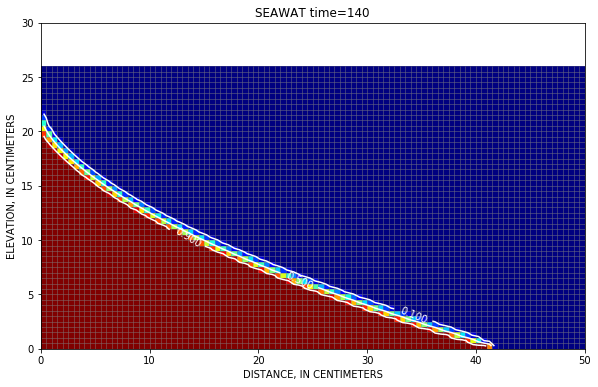

In [155]:
itime = 4
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
xs.plot_grid(linewidths=0.5, alpha=0.5)
xs.plot_array(conc[itime], cmap='jet', vmin=0, vmax=0.0371)
#xs.plot_specific_discharge(splist[0], color='white')
cs = xs.contour_array(conc[itime] / 0.0371, levels=[0.1, .5, .9], colors='white')
ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)
if plot_title:
    ax.set_title('SEAWAT time={}'.format(printtimes[itime]))

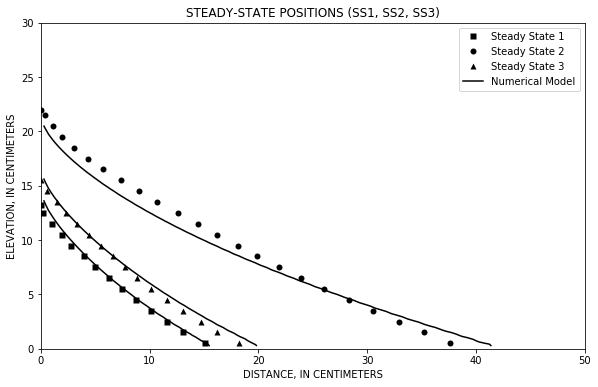

In [156]:
# Figure 5 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[0] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[4] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[8] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ss1x, ss1z, marker='s', mfc='k', mec='none', linestyle='none', label='Steady State 1')[0]
h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
h3 = plt.plot(ss3x, ss3z, marker='^', mfc='k', mec='none', linestyle='none', label='Steady State 3')[0]

black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('STEADY-STATE POSITIONS (SS1, SS2, SS3)')

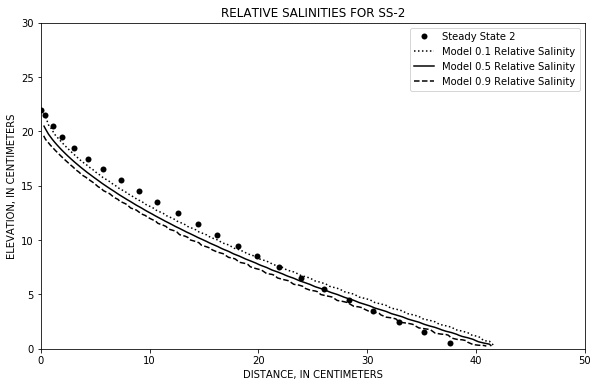

In [157]:
# Figure 6 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[4] / 0.0371, levels=[0.1, .5, .9], linestyles = [':', '-', '--'], colors='k')

h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
dot_line = mlines.Line2D([], [], linestyle=':', color='black', label='Model 0.1 Relative Salinity')
black_line = mlines.Line2D([], [], color='black', label='Model 0.5 Relative Salinity')
dash_line = mlines.Line2D([], [], linestyle='--', color='black', label='Model 0.9 Relative Salinity')

handles = [h2, dot_line, black_line, dash_line]
labels = [h2.get_label(), dot_line.get_label(), black_line.get_label(), dash_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('RELATIVE SALINITIES FOR SS-2')

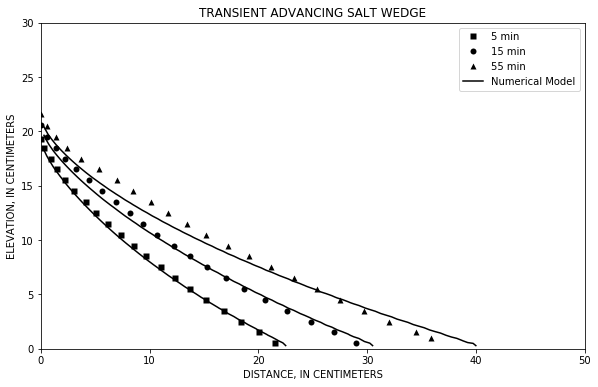

In [158]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[1] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[2] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[3] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ta5x, ta5z, marker='s', mfc='k', mec='none', linestyle='none', label='5 min')[0]
h2 = plt.plot(ta15x, ta15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(ta55x, ta55z, marker='^', mfc='k', mec='none', linestyle='none', label='55 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT ADVANCING SALT WEDGE')

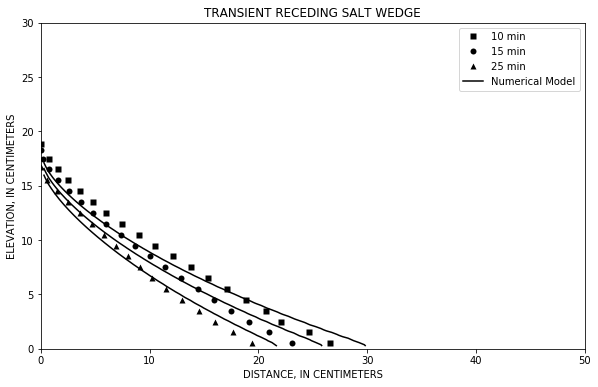

In [159]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[5] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[6] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[7] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(tr10x, tr10z, marker='s', mfc='k', mec='none', linestyle='none', label='10 min')[0]
h2 = plt.plot(tr15x, tr15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(tr25x, tr25z, marker='^', mfc='k', mec='none', linestyle='none', label='25 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT RECEDING SALT WEDGE')

# SEAWAT TVD GHB

In [160]:
ws = 'temp/pxx_goswami_seawat_ghb_tvd'
name = 'gswt'
gfact = 1
swt = get_model(ws, name, nlay=gfact*52, ncol=gfact*106,
                general_head_boundary=True, mixelm=-1)
swt.write_input()
fname = os.path.join(ws, 'MT3D001.UCN')
if os.path.isfile(fname):
    os.remove(fname)
swt.run_model()

FloPy is using the following  executable to run the model: /Users/langevin/langevin/bin/mac/swt_v4

                                  SEAWAT Version 4
    U.S. GEOLOGICAL SURVEY MODULAR FINITE-DIFFERENCE GROUND-WATER FLOW MODEL
                             Version 4.00.05 10/19/2012                      

Incorporated MODFLOW Version: 1.18.01 06/20/2008                      
Incorporated MT3DMS  Version: 5.20    10/30/2006                      


 This program is public domain and is released on the
 condition that neither the U.S. Geological Survey nor
 the United States Government may be held liable for any
 damages resulting from their authorized or unauthorized
 use.


 Using NAME file: gswt.nam                                                                                                                                                                                                
 Run start date and time (yyyy/mm/dd hh:mm:ss): 2019/09/06 13:17:21


 STRESS PERIOD NO.    1

  ST

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1138      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   36 FROM TIME =  0.58333     TO   0.60000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.60000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1124      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   37 FROM TIME =  0.60000     TO   0.61667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.61667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1110      [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   38 FROM TIME =  0.61667     TO   0.63333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:  0.63333    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP   73 FROM TIME =   1.2000     TO    1.2167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7888E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   74 FROM TIME =   1.2167     TO    1.2333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7828E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   75 FROM TIME =   1.2333     TO    1.2500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.2500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.7769E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP   76 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6154E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  110 FROM TIME =   1.8167     TO    1.8333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6116E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  111 FROM TIME =   1.8333     TO    1.8500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6079E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  112 FROM TIME =   1.8500     TO    1.8667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   1.8667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5018E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  146 FROM TIME =   2.4167     TO    2.4333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.4333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4992E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  147 FROM TIME =   2.4333     TO    2.4500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.4500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4963E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  148 FROM TIME =   2.4500     TO    2.4667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   2.4667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4162E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  184 FROM TIME =   3.0500     TO    3.0667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.0667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4142E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  185 FROM TIME =   3.0667     TO    3.0833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.0833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4124E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  186 FROM TIME =   3.0833     TO    3.1000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.1000    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3519E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  222 FROM TIME =   3.6833     TO    3.7000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3505E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  223 FROM TIME =   3.7000     TO    3.7167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3490E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  224 FROM TIME =   3.7167     TO    3.7333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   3.7333    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2989E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  263 FROM TIME =   4.3667     TO    4.3833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.3833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2977E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  264 FROM TIME =   4.3833     TO    4.4000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.4000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2966E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  265 FROM TIME =   4.4000     TO    4.4167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   4.4167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2576E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  303 FROM TIME =   5.0333     TO    5.0500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2567E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  304 FROM TIME =   5.0500     TO    5.0667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2558E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  305 FROM TIME =   5.0667     TO    5.0833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.0833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2231E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  345 FROM TIME =   5.7333     TO    5.7500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2224E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  346 FROM TIME =   5.7500     TO    5.7667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2216E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  347 FROM TIME =   5.7667     TO    5.7833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   5.7833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1951E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  387 FROM TIME =   6.4333     TO    6.4500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1945E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  388 FROM TIME =   6.4500     TO    6.4667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1939E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  389 FROM TIME =   6.4667     TO    6.4833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   6.4833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  429 FROM TIME =   7.1333     TO    7.1500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  430 FROM TIME =   7.1500     TO    7.1667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  431 FROM TIME =   7.1667     TO    7.1833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.1833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1525E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  471 FROM TIME =   7.8333     TO    7.8500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1521E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  472 FROM TIME =   7.8500     TO    7.8667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1517E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  473 FROM TIME =   7.8667     TO    7.8833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   7.8833    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  514 FROM TIME =   8.5500     TO    8.5667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.5667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1434E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  515 FROM TIME =   8.5667     TO    8.5833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.5833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1433E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  516 FROM TIME =   8.5833     TO    8.6000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   8.6000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1432E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1406E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  557 FROM TIME =   9.2667     TO    9.2833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.2833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1406E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  558 FROM TIME =   9.2833     TO    9.3000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1405E-01  [K,I,J]   27    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  559 FROM TIME =   9.3000     TO    9.3167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.3167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1415E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  596 FROM TIME =   9.9167     TO    9.9333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.9333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1416E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  597 FROM TIME =   9.9333     TO    9.9500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.9500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1418E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  598 FROM TIME =   9.9500     TO    9.9667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   9.9667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1483E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  640 FROM TIME =   10.650     TO    10.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1484E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  641 FROM TIME =   10.667     TO    10.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1485E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  642 FROM TIME =   10.683     TO    10.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   10.700    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1526E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  686 FROM TIME =   11.417     TO    11.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1527E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  687 FROM TIME =   11.433     TO    11.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1528E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  688 FROM TIME =   11.450     TO    11.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   11.467    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP  731 FROM TIME =   12.167     TO    12.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  732 FROM TIME =   12.183     TO    12.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  733 FROM TIME =   12.200     TO    12.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  734 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1572E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  777 FROM TIME =   12.933     TO    12.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1572E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  778 FROM TIME =   12.950     TO    12.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1573E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  779 FROM TIME =   12.967     TO    12.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   12.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  823 FROM TIME =   13.700     TO    13.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  824 FROM TIME =   13.717     TO    13.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  825 FROM TIME =   13.733     TO    13.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   13.750    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1571E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  869 FROM TIME =   14.467     TO    14.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  870 FROM TIME =   14.483     TO    14.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  871 FROM TIME =   14.500     TO    14.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   14.517    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1562E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  915 FROM TIME =   15.233     TO    15.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1562E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  916 FROM TIME =   15.250     TO    15.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1562E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  917 FROM TIME =   15.267     TO    15.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   15.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1554E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  962 FROM TIME =   16.017     TO    16.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1554E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  963 FROM TIME =   16.033     TO    16.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1554E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP  964 FROM TIME =   16.050     TO    16.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.067    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1551E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1009 FROM TIME =   16.800     TO    16.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1551E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1010 FROM TIME =   16.817     TO    16.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1551E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1011 FROM TIME =   16.833     TO    16.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   16.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1546E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1056 FROM TIME =   17.583     TO    17.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1546E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1057 FROM TIME =   17.600     TO    17.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1546E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1058 FROM TIME =   17.617     TO    17.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   17.633    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1103 FROM TIME =   18.367     TO    18.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1539E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1104 FROM TIME =   18.383     TO    18.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1539E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1105 FROM TIME =   18.400     TO    18.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   18.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1538E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1106 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1151 FROM TIME =   19.167     TO    19.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1531E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1152 FROM TIME =   19.183     TO    19.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1531E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1153 FROM TIME =   19.200     TO    19.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   19.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1531E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1200 FROM TIME =   19.983     TO    20.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1201 FROM TIME =   20.000     TO    20.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1523E-01  [K,I,J]   26    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1202 FROM TIME =   20.017     TO    20.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1248 FROM TIME =   20.783     TO    20.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1520E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1249 FROM TIME =   20.800     TO    20.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1520E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1250 FROM TIME =   20.817     TO    20.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   20.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1520E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1528E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1297 FROM TIME =   21.600     TO    21.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1528E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1298 FROM TIME =   21.617     TO    21.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1529E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1299 FROM TIME =   21.633     TO    21.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   21.650    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1346 FROM TIME =   22.417     TO    22.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1537E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1347 FROM TIME =   22.433     TO    22.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1538E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1348 FROM TIME =   22.450     TO    22.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   22.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1538E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1349 FRO


  STRESS PERIOD    1 TIME STEP 1395 FROM TIME =   23.233     TO    23.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1396 FROM TIME =   23.250     TO    23.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1397 FROM TIME =   23.267     TO    23.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   23.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1398 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1445 FROM TIME =   24.067     TO    24.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1552E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1446 FROM TIME =   24.083     TO    24.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1552E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1447 FROM TIME =   24.100     TO    24.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1552E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1555E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1471 FROM TIME =   24.500     TO    24.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1555E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1472 FROM TIME =   24.517     TO    24.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1555E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1473 FROM TIME =   24.533     TO    24.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1497 FROM TIME =   24.933     TO    24.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1498 FROM TIME =   24.950     TO    24.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1499 FROM TIME =   24.967     TO    24.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   24.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1561E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1523 FROM TIME =   25.367     TO    25.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1561E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1524 FROM TIME =   25.383     TO    25.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1561E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1525 FROM TIME =   25.400     TO    25.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.417    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1563E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1549 FROM TIME =   25.800     TO    25.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1563E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1550 FROM TIME =   25.817     TO    25.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1563E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1551 FROM TIME =   25.833     TO    25.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   25.850    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1565E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1575 FROM TIME =   26.233     TO    26.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1565E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1576 FROM TIME =   26.250     TO    26.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1566E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1577 FROM TIME =   26.267     TO    26.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1601 FROM TIME =   26.667     TO    26.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1602 FROM TIME =   26.683     TO    26.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1568E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1603 FROM TIME =   26.700     TO    26.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   26.717    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1627 FROM TIME =   27.100     TO    27.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1628 FROM TIME =   27.117     TO    27.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1629 FROM TIME =   27.133     TO    27.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1571E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1653 FROM TIME =   27.533     TO    27.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1571E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1654 FROM TIME =   27.550     TO    27.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1572E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1655 FROM TIME =   27.567     TO    27.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.583    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1679 FROM TIME =   27.967     TO    27.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   27.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1573E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1680 FROM TIME =   27.983     TO    28.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1573E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1681 FROM TIME =   28.000     TO    28.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1573E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1575E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1706 FROM TIME =   28.417     TO    28.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1575E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1707 FROM TIME =   28.433     TO    28.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1575E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1708 FROM TIME =   28.450     TO    28.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.467    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1733 FROM TIME =   28.867     TO    28.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1734 FROM TIME =   28.883     TO    28.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1735 FROM TIME =   28.900     TO    28.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   28.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1576E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1578E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1760 FROM TIME =   29.317     TO    29.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1578E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1761 FROM TIME =   29.333     TO    29.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1578E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1762 FROM TIME =   29.350     TO    29.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.367    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1787 FROM TIME =   29.767     TO    29.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1788 FROM TIME =   29.783     TO    29.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1789 FROM TIME =   29.800     TO    29.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   29.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1580E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1815 FROM TIME =   30.233     TO    30.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1580E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1816 FROM TIME =   30.250     TO    30.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1580E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1817 FROM TIME =   30.267     TO    30.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1842 FROM TIME =   30.683     TO    30.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1843 FROM TIME =   30.700     TO    30.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1844 FROM TIME =   30.717     TO    30.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   30.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1845 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1582E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1870 FROM TIME =   31.150     TO    31.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1583E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1871 FROM TIME =   31.167     TO    31.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1583E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1872 FROM TIME =   31.183     TO    31.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.200    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1897 FROM TIME =   31.600     TO    31.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1898 FROM TIME =   31.617     TO    31.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1899 FROM TIME =   31.633     TO    31.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   31.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1900 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1925 FROM TIME =   32.067     TO    32.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1926 FROM TIME =   32.083     TO    32.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1584E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1927 FROM TIME =   32.100     TO    32.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.117    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 1952 FROM TIME =   32.517     TO    32.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1953 FROM TIME =   32.533     TO    32.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1954 FROM TIME =   32.550     TO    32.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   32.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1955 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1586E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1980 FROM TIME =   32.983     TO    33.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1586E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1981 FROM TIME =   33.000     TO    33.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1586E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 1982 FROM TIME =   33.017     TO    33.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2008 FROM TIME =   33.450     TO    33.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2009 FROM TIME =   33.467     TO    33.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2010 FROM TIME =   33.483     TO    33.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.500    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2036 FROM TIME =   33.917     TO    33.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2037 FROM TIME =   33.933     TO    33.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1587E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2038 FROM TIME =   33.950     TO    33.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   33.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2064 FROM TIME =   34.383     TO    34.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2065 FROM TIME =   34.400     TO    34.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2066 FROM TIME =   34.417     TO    34.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D


  STRESS PERIOD    1 TIME STEP 2092 FROM TIME =   34.850     TO    34.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2093 FROM TIME =   34.867     TO    34.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2094 FROM TIME =   34.883     TO    34.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   34.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1588E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2095 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2121 FROM TIME =   35.333     TO    35.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.350    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2122 FROM TIME =   35.350     TO    35.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2123 FROM TIME =   35.367     TO    35.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.383    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2149 FROM TIME =   35.800     TO    35.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2150 FROM TIME =   35.817     TO    35.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2151 FROM TIME =   35.833     TO    35.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   35.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1589E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2177 FROM TIME =   36.267     TO    36.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2178 FROM TIME =   36.283     TO    36.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2179 FROM TIME =   36.300     TO    36.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.317    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2205 FROM TIME =   36.733     TO    36.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2206 FROM TIME =   36.750     TO    36.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2207 FROM TIME =   36.767     TO    36.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   36.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2233 FROM TIME =   37.200     TO    37.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2234 FROM TIME =   37.217     TO    37.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2235 FROM TIME =   37.233     TO    37.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2261 FROM TIME =   37.667     TO    37.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2262 FROM TIME =   37.683     TO    37.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2263 FROM TIME =   37.700     TO    37.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   37.717    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2288 FROM TIME =   38.117     TO    38.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2289 FROM TIME =   38.133     TO    38.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2290 FROM TIME =   38.150     TO    38.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2291 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2315 FROM TIME =   38.567     TO    38.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2316 FROM TIME =   38.583     TO    38.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2317 FROM TIME =   38.600     TO    38.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   38.617    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2342 FROM TIME =   39.017     TO    39.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2343 FROM TIME =   39.033     TO    39.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2344 FROM TIME =   39.050     TO    39.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1591E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2345 FRO


  STRESS PERIOD    1 TIME STEP 2369 FROM TIME =   39.467     TO    39.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2370 FROM TIME =   39.483     TO    39.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2371 FROM TIME =   39.500     TO    39.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2372 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2397 FROM TIME =   39.933     TO    39.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2398 FROM TIME =   39.950     TO    39.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2399 FROM TIME =   39.967     TO    39.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   39.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2424 FROM TIME =   40.383     TO    40.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2425 FROM TIME =   40.400     TO    40.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2426 FROM TIME =   40.417     TO    40.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.433    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2451 FROM TIME =   40.833     TO    40.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2452 FROM TIME =   40.850     TO    40.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2453 FROM TIME =   40.867     TO    40.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   40.883    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2478 FROM TIME =   41.283     TO    41.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2479 FROM TIME =   41.300     TO    41.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2480 FROM TIME =   41.317     TO    41.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2481 FRO


  STRESS PERIOD    1 TIME STEP 2505 FROM TIME =   41.733     TO    41.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2506 FROM TIME =   41.750     TO    41.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2507 FROM TIME =   41.767     TO    41.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   41.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2508 FRO


  STRESS PERIOD    1 TIME STEP 2532 FROM TIME =   42.183     TO    42.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2533 FROM TIME =   42.200     TO    42.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2534 FROM TIME =   42.217     TO    42.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1592E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2535 FRO


  STRESS PERIOD    1 TIME STEP 2559 FROM TIME =   42.633     TO    42.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2560 FROM TIME =   42.650     TO    42.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2561 FROM TIME =   42.667     TO    42.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   42.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2562 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2586 FROM TIME =   43.083     TO    43.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2587 FROM TIME =   43.100     TO    43.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2588 FROM TIME =   43.117     TO    43.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2613 FROM TIME =   43.533     TO    43.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2614 FROM TIME =   43.550     TO    43.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2615 FROM TIME =   43.567     TO    43.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   43.583    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2641 FROM TIME =   44.000     TO    44.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2642 FROM TIME =   44.017     TO    44.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2643 FROM TIME =   44.033     TO    44.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.050    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2669 FROM TIME =   44.467     TO    44.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2670 FROM TIME =   44.483     TO    44.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2671 FROM TIME =   44.500     TO    44.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.517    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2697 FROM TIME =   44.933     TO    44.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2698 FROM TIME =   44.950     TO    44.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2699 FROM TIME =   44.967     TO    44.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   44.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2724 FROM TIME =   45.383     TO    45.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2725 FROM TIME =   45.400     TO    45.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2726 FROM TIME =   45.417     TO    45.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.433    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2751 FROM TIME =   45.833     TO    45.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2752 FROM TIME =   45.850     TO    45.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2753 FROM TIME =   45.867     TO    45.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   45.883    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2754 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2779 FROM TIME =   46.300     TO    46.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2780 FROM TIME =   46.317     TO    46.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2781 FROM TIME =   46.333     TO    46.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2807 FROM TIME =   46.767     TO    46.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2808 FROM TIME =   46.783     TO    46.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2809 FROM TIME =   46.800     TO    46.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   46.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2835 FROM TIME =   47.233     TO    47.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2836 FROM TIME =   47.250     TO    47.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2837 FROM TIME =   47.267     TO    47.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2863 FROM TIME =   47.700     TO    47.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2864 FROM TIME =   47.717     TO    47.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2865 FROM TIME =   47.733     TO    47.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   47.750    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 2891 FROM TIME =   48.167     TO    48.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2892 FROM TIME =   48.183     TO    48.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2893 FROM TIME =   48.200     TO    48.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2894 FRO


  STRESS PERIOD    1 TIME STEP 2919 FROM TIME =   48.633     TO    48.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2920 FROM TIME =   48.650     TO    48.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2921 FROM TIME =   48.667     TO    48.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   48.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2922 FRO

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2948 FROM TIME =   49.117     TO    49.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2949 FROM TIME =   49.133     TO    49.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2950 FROM TIME =   49.150     TO    49.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.167    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2977 FROM TIME =   49.600     TO    49.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2978 FROM TIME =   49.617     TO    49.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 2979 FROM TIME =   49.633     TO    49.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   49.650    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3005 FROM TIME =   50.067     TO    50.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3006 FROM TIME =   50.083     TO    50.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3007 FROM TIME =   50.100     TO    50.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3008 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3034 FROM TIME =   50.550     TO    50.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3035 FROM TIME =   50.567     TO    50.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3036 FROM TIME =   50.583     TO    50.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   50.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3063 FROM TIME =   51.033     TO    51.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3064 FROM TIME =   51.050     TO    51.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3065 FROM TIME =   51.067     TO    51.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.083    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3092 FROM TIME =   51.517     TO    51.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3093 FROM TIME =   51.533     TO    51.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3094 FROM TIME =   51.550     TO    51.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   51.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1593E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3095 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3122 FROM TIME =   52.017     TO    52.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3123 FROM TIME =   52.033     TO    52.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3124 FROM TIME =   52.050     TO    52.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.067    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3151 FROM TIME =   52.500     TO    52.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3152 FROM TIME =   52.517     TO    52.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3153 FROM TIME =   52.533     TO    52.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   52.550    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3181 FROM TIME =   53.000     TO    53.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3182 FROM TIME =   53.017     TO    53.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3183 FROM TIME =   53.033     TO    53.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.050    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3211 FROM TIME =   53.500     TO    53.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3212 FROM TIME =   53.517     TO    53.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3213 FROM TIME =   53.533     TO    53.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   53.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3214 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3241 FROM TIME =   54.000     TO    54.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3242 FROM TIME =   54.017     TO    54.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3243 FROM TIME =   54.033     TO    54.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.050    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3270 FROM TIME =   54.483     TO    54.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3271 FROM TIME =   54.500     TO    54.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3272 FROM TIME =   54.517     TO    54.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   54.533    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3300 FROM TIME =   54.983     TO    55.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3301 FROM TIME =   55.000     TO    55.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3302 FROM TIME =   55.017     TO    55.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3329 FROM TIME =   55.467     TO    55.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3330 FROM TIME =   55.483     TO    55.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3331 FROM TIME =   55.500     TO    55.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3332 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3359 FROM TIME =   55.967     TO    55.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   55.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3360 FROM TIME =   55.983     TO    56.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3361 FROM TIME =   56.000     TO    56.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.017    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3389 FROM TIME =   56.467     TO    56.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3390 FROM TIME =   56.483     TO    56.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3391 FROM TIME =   56.500     TO    56.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.517    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3419 FROM TIME =   56.967     TO    56.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   56.983    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3420 FROM TIME =   56.983     TO    57.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3421 FROM TIME =   57.000     TO    57.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3422 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3450 FROM TIME =   57.483     TO    57.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3451 FROM TIME =   57.500     TO    57.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3452 FROM TIME =   57.517     TO    57.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   57.533    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3480 FROM TIME =   57.983     TO    58.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3481 FROM TIME =   58.000     TO    58.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3482 FROM TIME =   58.017     TO    58.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3510 FROM TIME =   58.483     TO    58.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.500    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3511 FROM TIME =   58.500     TO    58.517    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.517    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3512 FROM TIME =   58.517     TO    58.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   58.533    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    1 TIME STEP 3540 FROM TIME =   58.983     TO    59.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3541 FROM TIME =   59.000     TO    59.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3542 FROM TIME =   59.017     TO    59.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3543 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3572 FROM TIME =   59.517     TO    59.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3573 FROM TIME =   59.533     TO    59.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1594E-01  [K,I,J]   25    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    1 TIME STEP 3574 FROM TIME =   59.550     TO    59.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   59.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =   0.000      [K,I,J]    1    1    1
 Transport Step:    2   Step Size:  1.6667E-02 Total Elapsed Time:   60.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6103E-01  [K,I,J]   29    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    2 FROM TIME =   60.017     TO    60.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6235E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    3 FROM TIME =   60.033     TO    60.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.050    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.6217E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP    4 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5604E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   34 FROM TIME =   60.550     TO    60.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5586E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   35 FROM TIME =   60.567     TO    60.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5569E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   36 FROM TIME =   60.583     TO    60.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   60.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5060E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   67 FROM TIME =   61.100     TO    61.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5046E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   68 FROM TIME =   61.117     TO    61.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.5030E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP   69 FROM TIME =   61.133     TO    61.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4614E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  100 FROM TIME =   61.650     TO    61.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4602E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  101 FROM TIME =   61.667     TO    61.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.683    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4589E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  102 FROM TIME =   61.683     TO    61.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   61.700    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4234E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  133 FROM TIME =   62.200     TO    62.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4224E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  134 FROM TIME =   62.217     TO    62.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.4214E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  135 FROM TIME =   62.233     TO    62.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.250    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3904E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  167 FROM TIME =   62.767     TO    62.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.783    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3895E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  168 FROM TIME =   62.783     TO    62.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3886E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  169 FROM TIME =   62.800     TO    62.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   62.817    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3609E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  202 FROM TIME =   63.350     TO    63.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3602E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  203 FROM TIME =   63.367     TO    63.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3594E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  204 FROM TIME =   63.383     TO    63.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.400    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3357E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  237 FROM TIME =   63.933     TO    63.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3351E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  238 FROM TIME =   63.950     TO    63.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.967    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3344E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  239 FROM TIME =   63.967     TO    63.983    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   63.983    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  273 FROM TIME =   64.533     TO    64.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3121E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  274 FROM TIME =   64.550     TO    64.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3115E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  275 FROM TIME =   64.567     TO    64.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   64.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3110E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2938E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  308 FROM TIME =   65.117     TO    65.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2932E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  309 FROM TIME =   65.133     TO    65.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.150    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2927E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  310 FROM TIME =   65.150     TO    65.167    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.167    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2750E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  345 FROM TIME =   65.733     TO    65.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2745E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  346 FROM TIME =   65.750     TO    65.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2741E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  347 FROM TIME =   65.767     TO    65.783    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   65.783    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2583E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  382 FROM TIME =   66.350     TO    66.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2579E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  383 FROM TIME =   66.367     TO    66.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2575E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  384 FROM TIME =   66.383     TO    66.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   66.400    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2430E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  420 FROM TIME =   66.983     TO    67.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2425E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  421 FROM TIME =   67.000     TO    67.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2421E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  422 FROM TIME =   67.017     TO    67.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2295E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  457 FROM TIME =   67.600     TO    67.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2291E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  458 FROM TIME =   67.617     TO    67.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2288E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  459 FROM TIME =   67.633     TO    67.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   67.650    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2171E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  495 FROM TIME =   68.233     TO    68.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2168E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  496 FROM TIME =   68.250     TO    68.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2165E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  497 FROM TIME =   68.267     TO    68.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2054E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  534 FROM TIME =   68.883     TO    68.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2052E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  535 FROM TIME =   68.900     TO    68.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2048E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  536 FROM TIME =   68.917     TO    68.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   68.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  574 FROM TIME =   69.550     TO    69.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1942E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  575 FROM TIME =   69.567     TO    69.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1939E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  576 FROM TIME =   69.583     TO    69.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   69.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1937E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  577 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1843E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  615 FROM TIME =   70.233     TO    70.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1840E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  616 FROM TIME =   70.250     TO    70.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1838E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  617 FROM TIME =   70.267     TO    70.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  655 FROM TIME =   70.900     TO    70.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  656 FROM TIME =   70.917     TO    70.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  657 FROM TIME =   70.933     TO    70.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   70.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1746E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  658 FRO


  STRESS PERIOD    2 TIME STEP  696 FROM TIME =   71.583     TO    71.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1664E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  697 FROM TIME =   71.600     TO    71.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.617    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1662E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  698 FROM TIME =   71.617     TO    71.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   71.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1660E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  699 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1585E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  738 FROM TIME =   72.283     TO    72.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1583E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  739 FROM TIME =   72.300     TO    72.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  740 FROM TIME =   72.317     TO    72.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   72.333    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP  780 FROM TIME =   72.983     TO    73.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1508E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  781 FROM TIME =   73.000     TO    73.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1506E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  782 FROM TIME =   73.017     TO    73.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1504E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  783 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1452E-01  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  822 FROM TIME =   73.683     TO    73.700    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.700    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1450E-01  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  823 FROM TIME =   73.700     TO    73.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1449E-01  [K,I,J]   14    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  824 FROM TIME =   73.717     TO    73.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   73.733    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  864 FROM TIME =   74.383     TO    74.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1489E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  865 FROM TIME =   74.400     TO    74.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.417    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1490E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  866 FROM TIME =   74.417     TO    74.433    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   74.433    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1491E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1530E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  907 FROM TIME =   75.100     TO    75.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1531E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  908 FROM TIME =   75.117     TO    75.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1531E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  909 FROM TIME =   75.133     TO    75.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  950 FROM TIME =   75.817     TO    75.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1559E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  951 FROM TIME =   75.833     TO    75.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1559E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  952 FROM TIME =   75.850     TO    75.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   75.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  994 FROM TIME =   76.550     TO    76.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.567    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1582E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  995 FROM TIME =   76.567     TO    76.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1582E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP  996 FROM TIME =   76.583     TO    76.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   76.600    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1596E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1037 FROM TIME =   77.267     TO    77.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1596E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1038 FROM TIME =   77.283     TO    77.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.300    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1596E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1039 FROM TIME =   77.300     TO    77.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   77.317    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1081 FROM TIME =   78.000     TO    78.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1082 FROM TIME =   78.017     TO    78.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.033    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1083 FROM TIME =   78.033     TO    78.050    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.050    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 1124 FROM TIME =   78.717     TO    78.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1125 FROM TIME =   78.733     TO    78.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1126 FROM TIME =   78.750     TO    78.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   78.767    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1127 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1168 FROM TIME =   79.450     TO    79.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1169 FROM TIME =   79.467     TO    79.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.483    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1170 FROM TIME =   79.483     TO    79.500    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   79.500    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1212 FROM TIME =   80.183     TO    80.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1213 FROM TIME =   80.200     TO    80.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.217    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1214 FROM TIME =   80.217     TO    80.233    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.233    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1256 FROM TIME =   80.917     TO    80.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1257 FROM TIME =   80.933     TO    80.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.950    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1258 FROM TIME =   80.950     TO    80.967    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   80.967    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1299 FROM TIME =   81.633     TO    81.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1300 FROM TIME =   81.650     TO    81.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.667    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1301 FROM TIME =   81.667     TO    81.683    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   81.683    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1602E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1343 FROM TIME =   82.367     TO    82.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1601E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1344 FROM TIME =   82.383     TO    82.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.400    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1601E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1345 FROM TIME =   82.400     TO    82.417    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   82.417    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1387 FROM TIME =   83.100     TO    83.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1579E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1388 FROM TIME =   83.117     TO    83.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.133    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1578E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1389 FROM TIME =   83.133     TO    83.150    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.150    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1559E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1431 FROM TIME =   83.833     TO    83.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1432 FROM TIME =   83.850     TO    83.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.867    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1433 FROM TIME =   83.867     TO    83.883    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   83.883    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1539E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1475 FROM TIME =   84.567     TO    84.583    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.583    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1538E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1476 FROM TIME =   84.583     TO    84.600    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.600    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1538E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1477 FROM TIME =   84.600     TO    84.617    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   84.617    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1517E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1519 FROM TIME =   85.300     TO    85.317    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.317    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1517E-01  [K,I,J]   13    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1520 FROM TIME =   85.317     TO    85.333    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.333    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1516E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1521 FROM TIME =   85.333     TO    85.350    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   85.350    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1564 FROM TIME =   86.050     TO    86.067    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.067    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1532E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1565 FROM TIME =   86.067     TO    86.083    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.083    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1532E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1566 FROM TIME =   86.083     TO    86.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1532E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1608 FROM TIME =   86.783     TO    86.800    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.800    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1609 FROM TIME =   86.800     TO    86.817    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.817    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1610 FROM TIME =   86.817     TO    86.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   86.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1545E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1652 FROM TIME =   87.517     TO    87.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1558E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1653 FROM TIME =   87.533     TO    87.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1559E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1654 FROM TIME =   87.550     TO    87.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   87.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1696 FROM TIME =   88.250     TO    88.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1570E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1697 FROM TIME =   88.267     TO    88.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.283    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1571E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1698 FROM TIME =   88.283     TO    88.300    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   88.300    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1740 FROM TIME =   88.983     TO    89.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1741 FROM TIME =   89.000     TO    89.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1581E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1742 FROM TIME =   89.017     TO    89.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1783 FROM TIME =   89.700     TO    89.717    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.717    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1784 FROM TIME =   89.717     TO    89.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1590E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1785 FROM TIME =   89.733     TO    89.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   89.750    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1599E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1827 FROM TIME =   90.433     TO    90.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1599E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1828 FROM TIME =   90.450     TO    90.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1599E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1829 FROM TIME =   90.467     TO    90.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   90.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1871 FROM TIME =   91.167     TO    91.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1872 FROM TIME =   91.183     TO    91.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1873 FROM TIME =   91.200     TO    91.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.217    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1914 FROM TIME =   91.883     TO    91.900    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.900    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1915 FROM TIME =   91.900     TO    91.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1916 FROM TIME =   91.917     TO    91.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   91.933    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1622E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1958 FROM TIME =   92.617     TO    92.633    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.633    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1959 FROM TIME =   92.633     TO    92.650    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.650    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 1960 FROM TIME =   92.650     TO    92.667    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   92.667    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1629E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2002 FROM TIME =   93.350     TO    93.367    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.367    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1629E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2003 FROM TIME =   93.367     TO    93.383    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.383    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1630E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2004 FROM TIME =   93.383     TO    93.400    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   93.400    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1636E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2046 FROM TIME =   94.083     TO    94.100    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.100    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2047 FROM TIME =   94.100     TO    94.117    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.117    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2048 FROM TIME =   94.117     TO    94.133    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.133    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1642E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2090 FROM TIME =   94.817     TO    94.833    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.833    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1642E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2091 FROM TIME =   94.833     TO    94.850    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.850    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1642E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2092 FROM TIME =   94.850     TO    94.867    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   94.867    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1647E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2132 FROM TIME =   95.517     TO    95.533    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.533    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1647E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2133 FROM TIME =   95.533     TO    95.550    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.550    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1647E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2134 FROM TIME =   95.550     TO    95.567    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   95.567    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1651E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2175 FROM TIME =   96.233     TO    96.250    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.250    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1652E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2176 FROM TIME =   96.250     TO    96.267    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.267    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1652E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2177 FROM TIME =   96.267     TO    96.283    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   96.283    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2220 FROM TIME =   96.983     TO    97.000    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.000    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2221 FROM TIME =   97.000     TO    97.017    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.017    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2222 FROM TIME =   97.017     TO    97.033    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.033    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2264 FROM TIME =   97.717     TO    97.733    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.733    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2265 FROM TIME =   97.733     TO    97.750    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.750    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2266 FROM TIME =   97.750     TO    97.767    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   97.767    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2307 FROM TIME =   98.433     TO    98.450    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.450    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2308 FROM TIME =   98.450     TO    98.467    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.467    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1668E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2309 FROM TIME =   98.467     TO    98.483    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   98.483    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1671E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2351 FROM TIME =   99.167     TO    99.183    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.183    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1671E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2352 FROM TIME =   99.183     TO    99.200    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.200    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1671E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2353 FROM TIME =   99.200     TO    99.217    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.217    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1674E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2395 FROM TIME =   99.900     TO    99.917    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.917    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1674E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2396 FROM TIME =   99.917     TO    99.933    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.933    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1674E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2397 FROM TIME =   99.933     TO    99.950    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   99.950    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1676E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2437 FROM TIME =   100.60     TO    100.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1676E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2438 FROM TIME =   100.62     TO    100.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1676E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2439 FROM TIME =   100.63     TO    100.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   100.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1678E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2477 FROM TIME =   101.27     TO    101.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1678E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2478 FROM TIME =   101.28     TO    101.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1679E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2479 FROM TIME =   101.30     TO    101.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   101.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2522 FROM TIME =   102.02     TO    102.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2523 FROM TIME =   102.03     TO    102.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2524 FROM TIME =   102.05     TO    102.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 2567 FROM TIME =   102.77     TO    102.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2568 FROM TIME =   102.78     TO    102.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2569 FROM TIME =   102.80     TO    102.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   102.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2570 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2612 FROM TIME =   103.52     TO    103.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2613 FROM TIME =   103.53     TO    103.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2614 FROM TIME =   103.55     TO    103.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   103.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2655 FROM TIME =   104.23     TO    104.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2656 FROM TIME =   104.25     TO    104.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2657 FROM TIME =   104.27     TO    104.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   104.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2700 FROM TIME =   104.98     TO    105.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2701 FROM TIME =   105.00     TO    105.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2702 FROM TIME =   105.02     TO    105.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2745 FROM TIME =   105.73     TO    105.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2746 FROM TIME =   105.75     TO    105.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2747 FROM TIME =   105.77     TO    105.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   105.78    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2792 FROM TIME =   106.52     TO    106.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2793 FROM TIME =   106.53     TO    106.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2794 FROM TIME =   106.55     TO    106.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   106.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2838 FROM TIME =   107.28     TO    107.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2839 FROM TIME =   107.30     TO    107.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2840 FROM TIME =   107.32     TO    107.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   107.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2885 FROM TIME =   108.07     TO    108.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2886 FROM TIME =   108.08     TO    108.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2887 FROM TIME =   108.10     TO    108.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2931 FROM TIME =   108.83     TO    108.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2932 FROM TIME =   108.85     TO    108.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2933 FROM TIME =   108.87     TO    108.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   108.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2978 FROM TIME =   109.62     TO    109.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2979 FROM TIME =   109.63     TO    109.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 2980 FROM TIME =   109.65     TO    109.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   109.67    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3025 FROM TIME =   110.40     TO    110.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3026 FROM TIME =   110.42     TO    110.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3027 FROM TIME =   110.43     TO    110.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   110.45    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3071 FROM TIME =   111.17     TO    111.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3072 FROM TIME =   111.18     TO    111.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1697E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3073 FROM TIME =   111.20     TO    111.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3119 FROM TIME =   111.97     TO    111.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   111.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3120 FROM TIME =   111.98     TO    112.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1696E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3121 FROM TIME =   112.00     TO    112.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3166 FROM TIME =   112.75     TO    112.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3167 FROM TIME =   112.77     TO    112.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3168 FROM TIME =   112.78     TO    112.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   112.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3214 FROM TIME =   113.55     TO    113.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3215 FROM TIME =   113.57     TO    113.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1695E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3216 FROM TIME =   113.58     TO    113.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   113.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3262 FROM TIME =   114.35     TO    114.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3263 FROM TIME =   114.37     TO    114.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1694E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3264 FROM TIME =   114.38     TO    114.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   114.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3306 FROM TIME =   115.08     TO    115.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3307 FROM TIME =   115.10     TO    115.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3308 FROM TIME =   115.12     TO    115.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.13    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3352 FROM TIME =   115.85     TO    115.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3353 FROM TIME =   115.87     TO    115.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3354 FROM TIME =   115.88     TO    115.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   115.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3355 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3397 FROM TIME =   116.60     TO    116.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3398 FROM TIME =   116.62     TO    116.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3399 FROM TIME =   116.63     TO    116.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   116.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3443 FROM TIME =   117.37     TO    117.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3444 FROM TIME =   117.38     TO    117.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3445 FROM TIME =   117.40     TO    117.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   117.42    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3488 FROM TIME =   118.12     TO    118.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3489 FROM TIME =   118.13     TO    118.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3490 FROM TIME =   118.15     TO    118.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.17    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3534 FROM TIME =   118.88     TO    118.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3535 FROM TIME =   118.90     TO    118.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3536 FROM TIME =   118.92     TO    118.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   118.93    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3580 FROM TIME =   119.65     TO    119.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3581 FROM TIME =   119.67     TO    119.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3582 FROM TIME =   119.68     TO    119.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   119.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3626 FROM TIME =   120.42     TO    120.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3627 FROM TIME =   120.43     TO    120.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1688E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3628 FROM TIME =   120.45     TO    120.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   120.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3670 FROM TIME =   121.15     TO    121.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3671 FROM TIME =   121.17     TO    121.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3672 FROM TIME =   121.18     TO    121.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1687E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3673 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1686E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3716 FROM TIME =   121.92     TO    121.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1686E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3717 FROM TIME =   121.93     TO    121.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1686E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3718 FROM TIME =   121.95     TO    121.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   121.97    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3762 FROM TIME =   122.68     TO    122.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3763 FROM TIME =   122.70     TO    122.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3764 FROM TIME =   122.72     TO    122.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   122.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1685E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3765 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1684E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3809 FROM TIME =   123.47     TO    123.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1684E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3810 FROM TIME =   123.48     TO    123.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1684E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3811 FROM TIME =   123.50     TO    123.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   123.52    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 3856 FROM TIME =   124.25     TO    124.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3857 FROM TIME =   124.27     TO    124.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3858 FROM TIME =   124.28     TO    124.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1683E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3859 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1682E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3899 FROM TIME =   124.97     TO    124.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   124.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1682E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3900 FROM TIME =   124.98     TO    125.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1682E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3901 FROM TIME =   125.00     TO    125.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3944 FROM TIME =   125.72     TO    125.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1680E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3945 FROM TIME =   125.73     TO    125.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1680E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3946 FROM TIME =   125.75     TO    125.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   125.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1679E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3991 FROM TIME =   126.50     TO    126.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1679E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3992 FROM TIME =   126.52     TO    126.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1679E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 3993 FROM TIME =   126.53     TO    126.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   126.55    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1677E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4038 FROM TIME =   127.28     TO    127.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1677E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4039 FROM TIME =   127.30     TO    127.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1677E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4040 FROM TIME =   127.32     TO    127.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   127.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1675E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4085 FROM TIME =   128.07     TO    128.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1675E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4086 FROM TIME =   128.08     TO    128.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1675E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4087 FROM TIME =   128.10     TO    128.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.12    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1674E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4135 FROM TIME =   128.90     TO    128.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1673E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4136 FROM TIME =   128.92     TO    128.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1673E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4137 FROM TIME =   128.93     TO    128.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   128.95    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4184 FROM TIME =   129.72     TO    129.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1672E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4185 FROM TIME =   129.73     TO    129.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1672E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4186 FROM TIME =   129.75     TO    129.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   129.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1672E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4187 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1670E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4233 FROM TIME =   130.53     TO    130.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1670E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4234 FROM TIME =   130.55     TO    130.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1670E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4235 FROM TIME =   130.57     TO    130.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   130.58    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1668E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4282 FROM TIME =   131.35     TO    131.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1668E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4283 FROM TIME =   131.37     TO    131.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1668E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4284 FROM TIME =   131.38     TO    131.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   131.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4332 FROM TIME =   132.18     TO    132.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4333 FROM TIME =   132.20     TO    132.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1666E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4334 FROM TIME =   132.22     TO    132.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1666E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4335 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1665E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4379 FROM TIME =   132.97     TO    132.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   132.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1665E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4380 FROM TIME =   132.98     TO    133.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1665E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4381 FROM TIME =   133.00     TO    133.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.02    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    2 TIME STEP 4427 FROM TIME =   133.77     TO    133.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4428 FROM TIME =   133.78     TO    133.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4429 FROM TIME =   133.80     TO    133.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   133.82    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4430 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1662E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4474 FROM TIME =   134.55     TO    134.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1662E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4475 FROM TIME =   134.57     TO    134.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1662E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4476 FROM TIME =   134.58     TO    134.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   134.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1660E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4522 FROM TIME =   135.35     TO    135.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1660E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4523 FROM TIME =   135.37     TO    135.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1660E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4524 FROM TIME =   135.38     TO    135.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   135.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1659E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4570 FROM TIME =   136.15     TO    136.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1659E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4571 FROM TIME =   136.17     TO    136.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1659E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4572 FROM TIME =   136.18     TO    136.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4617 FROM TIME =   136.93     TO    136.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4618 FROM TIME =   136.95     TO    136.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4619 FROM TIME =   136.97     TO    136.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   136.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1656E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4662 FROM TIME =   137.68     TO    137.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1656E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4663 FROM TIME =   137.70     TO    137.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1656E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4664 FROM TIME =   137.72     TO    137.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   137.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1654E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4711 FROM TIME =   138.50     TO    138.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1654E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4712 FROM TIME =   138.52     TO    138.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1654E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4713 FROM TIME =   138.53     TO    138.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   138.55    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4761 FROM TIME =   139.33     TO    139.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4762 FROM TIME =   139.35     TO    139.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   12    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    2 TIME STEP 4763 FROM TIME =   139.37     TO    139.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   139.38    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3809E-01  [K,I,J]   45    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP    7 FROM TIME =   140.10     TO    140.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3803E-01  [K,I,J]   48    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP    8 FROM TIME =   140.12     TO    140.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3798E-01  [K,I,J]   49    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP    9 FROM TIME =   140.13     TO    140.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3611E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   45 FROM TIME =   140.73     TO    140.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3606E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   46 FROM TIME =   140.75     TO    140.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3602E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   47 FROM TIME =   140.77     TO    140.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   140.78    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3427E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   84 FROM TIME =   141.38     TO    141.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3422E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   85 FROM TIME =   141.40     TO    141.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3418E-01  [K,I,J]   51    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP   86 FROM TIME =   141.42     TO    141.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   141.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  124 FROM TIME =   142.05     TO    142.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3247E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  125 FROM TIME =   142.07     TO    142.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3243E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  126 FROM TIME =   142.08     TO    142.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3239E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  127 FRO


  STRESS PERIOD    3 TIME STEP  161 FROM TIME =   142.67     TO    142.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3096E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  162 FROM TIME =   142.68     TO    142.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3093E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  163 FROM TIME =   142.70     TO    142.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   142.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.3089E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  164 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2947E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  201 FROM TIME =   143.33     TO    143.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2943E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  202 FROM TIME =   143.35     TO    143.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2939E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  203 FROM TIME =   143.37     TO    143.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   143.38    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2805E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  240 FROM TIME =   143.98     TO    144.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2802E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  241 FROM TIME =   144.00     TO    144.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2798E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  242 FROM TIME =   144.02     TO    144.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2664E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  281 FROM TIME =   144.67     TO    144.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2661E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  282 FROM TIME =   144.68     TO    144.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2658E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  283 FROM TIME =   144.70     TO    144.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   144.72    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2530E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  322 FROM TIME =   145.35     TO    145.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2527E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  323 FROM TIME =   145.37     TO    145.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2524E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  324 FROM TIME =   145.38     TO    145.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   145.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2405E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  362 FROM TIME =   146.02     TO    146.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2402E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  363 FROM TIME =   146.03     TO    146.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2399E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  364 FROM TIME =   146.05     TO    146.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.07    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2292E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  400 FROM TIME =   146.65     TO    146.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2289E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  401 FROM TIME =   146.67     TO    146.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.68    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2286E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  402 FROM TIME =   146.68     TO    146.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   146.70    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2182E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  438 FROM TIME =   147.28     TO    147.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2179E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  439 FROM TIME =   147.30     TO    147.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2177E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  440 FROM TIME =   147.32     TO    147.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2074E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  477 FROM TIME =   147.93     TO    147.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2071E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  478 FROM TIME =   147.95     TO    147.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.2069E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  479 FROM TIME =   147.97     TO    147.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   147.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  516 FROM TIME =   148.58     TO    148.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1967E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  517 FROM TIME =   148.60     TO    148.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1965E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  518 FROM TIME =   148.62     TO    148.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   148.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1962E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  519 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1865E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  557 FROM TIME =   149.27     TO    149.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1862E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  558 FROM TIME =   149.28     TO    149.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1859E-01  [K,I,J]   52    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  559 FROM TIME =   149.30     TO    149.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1776E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  596 FROM TIME =   149.92     TO    149.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1774E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  597 FROM TIME =   149.93     TO    149.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1772E-01  [K,I,J]   18    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  598 FROM TIME =   149.95     TO    149.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   149.97    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1776E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  635 FROM TIME =   150.57     TO    150.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1778E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  636 FROM TIME =   150.58     TO    150.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1779E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  637 FROM TIME =   150.60     TO    150.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   150.62    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1826E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  673 FROM TIME =   151.20     TO    151.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1827E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  674 FROM TIME =   151.22     TO    151.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1828E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  675 FROM TIME =   151.23     TO    151.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.25    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1853E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  711 FROM TIME =   151.83     TO    151.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1853E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  712 FROM TIME =   151.85     TO    151.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1854E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  713 FROM TIME =   151.87     TO    151.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   151.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP  749 FROM TIME =   152.47     TO    152.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  750 FROM TIME =   152.48     TO    152.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  751 FROM TIME =   152.50     TO    152.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   152.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1860E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  752 FRO


  STRESS PERIOD    3 TIME STEP  787 FROM TIME =   153.10     TO    153.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1854E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  788 FROM TIME =   153.12     TO    153.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1853E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  789 FROM TIME =   153.13     TO    153.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1852E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  790 FRO


  STRESS PERIOD    3 TIME STEP  826 FROM TIME =   153.75     TO    153.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1799E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  827 FROM TIME =   153.77     TO    153.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1798E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  828 FROM TIME =   153.78     TO    153.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   153.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1797E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  829 FRO


  STRESS PERIOD    3 TIME STEP  864 FROM TIME =   154.38     TO    154.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1751E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  865 FROM TIME =   154.40     TO    154.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  866 FROM TIME =   154.42     TO    154.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   154.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1748E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  867 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  904 FROM TIME =   155.05     TO    155.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  905 FROM TIME =   155.07     TO    155.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1706E-01  [K,I,J]   19    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  906 FROM TIME =   155.08     TO    155.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  946 FROM TIME =   155.75     TO    155.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  947 FROM TIME =   155.77     TO    155.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  948 FROM TIME =   155.78     TO    155.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   155.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1749E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  988 FROM TIME =   156.45     TO    156.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.47    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  989 FROM TIME =   156.47     TO    156.48    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.48    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1750E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP  990 FROM TIME =   156.48     TO    156.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   156.50    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1766E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1030 FROM TIME =   157.15     TO    157.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1766E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1031 FROM TIME =   157.17     TO    157.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1767E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1032 FROM TIME =   157.18     TO    157.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.20    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1784E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1072 FROM TIME =   157.85     TO    157.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1784E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1073 FROM TIME =   157.87     TO    157.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1784E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1074 FROM TIME =   157.88     TO    157.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   157.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1792E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1115 FROM TIME =   158.57     TO    158.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1792E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1116 FROM TIME =   158.58     TO    158.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1793E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1117 FROM TIME =   158.60     TO    158.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   158.62    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1793E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1155 FROM TIME =   159.23     TO    159.25    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.25    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1793E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1156 FROM TIME =   159.25     TO    159.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1793E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1157 FROM TIME =   159.27     TO    159.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.28    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1769E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1197 FROM TIME =   159.93     TO    159.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1768E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1198 FROM TIME =   159.95     TO    159.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1767E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1199 FROM TIME =   159.97     TO    159.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   159.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1746E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1237 FROM TIME =   160.60     TO    160.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1746E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1238 FROM TIME =   160.62     TO    160.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1745E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1239 FROM TIME =   160.63     TO    160.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   160.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1722E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1277 FROM TIME =   161.27     TO    161.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1721E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1278 FROM TIME =   161.28     TO    161.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1720E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1279 FROM TIME =   161.30     TO    161.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.32    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1315 FROM TIME =   161.90     TO    161.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.92    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1316 FROM TIME =   161.92     TO    161.93    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.93    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1691E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1317 FROM TIME =   161.93     TO    161.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   161.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1690E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1318 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1358 FROM TIME =   162.62     TO    162.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1657E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1359 FROM TIME =   162.63     TO    162.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1656E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1360 FROM TIME =   162.65     TO    162.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   162.67    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1625E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1401 FROM TIME =   163.33     TO    163.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1624E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1402 FROM TIME =   163.35     TO    163.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   20    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1403 FROM TIME =   163.37     TO    163.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   163.38    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1443 FROM TIME =   164.03     TO    164.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.05    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1444 FROM TIME =   164.05     TO    164.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1638E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1445 FROM TIME =   164.07     TO    164.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.08    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1484 FROM TIME =   164.72     TO    164.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1485 FROM TIME =   164.73     TO    164.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1654E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1486 FROM TIME =   164.75     TO    164.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   164.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1524 FROM TIME =   165.38     TO    165.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1525 FROM TIME =   165.40     TO    165.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1667E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1526 FROM TIME =   165.42     TO    165.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   165.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1680E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1567 FROM TIME =   166.10     TO    166.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1680E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1568 FROM TIME =   166.12     TO    166.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1680E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1569 FROM TIME =   166.13     TO    166.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1612 FROM TIME =   166.85     TO    166.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1613 FROM TIME =   166.87     TO    166.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1692E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1614 FROM TIME =   166.88     TO    166.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   166.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1693E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1615 FRO


  STRESS PERIOD    3 TIME STEP 1654 FROM TIME =   167.55     TO    167.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1699E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1655 FROM TIME =   167.57     TO    167.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1700E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1656 FROM TIME =   167.58     TO    167.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   167.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1700E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1657 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1696 FROM TIME =   168.25     TO    168.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1707E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1697 FROM TIME =   168.27     TO    168.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1708E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1698 FROM TIME =   168.28     TO    168.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   168.30    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1740 FROM TIME =   168.98     TO    169.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1741 FROM TIME =   169.00     TO    169.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1714E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1742 FROM TIME =   169.02     TO    169.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1786 FROM TIME =   169.75     TO    169.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1787 FROM TIME =   169.77     TO    169.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1788 FROM TIME =   169.78     TO    169.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   169.80    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1832 FROM TIME =   170.52     TO    170.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1833 FROM TIME =   170.53     TO    170.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1834 FROM TIME =   170.55     TO    170.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   170.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1876 FROM TIME =   171.25     TO    171.27    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.27    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1877 FROM TIME =   171.27     TO    171.28    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.28    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1719E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1878 FROM TIME =   171.28     TO    171.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   171.30    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1921 FROM TIME =   172.00     TO    172.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1922 FROM TIME =   172.02     TO    172.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1717E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1923 FROM TIME =   172.03     TO    172.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 1966 FROM TIME =   172.75     TO    172.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1967 FROM TIME =   172.77     TO    172.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1710E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1968 FROM TIME =   172.78     TO    172.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   172.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1709E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 1969 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1701E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2014 FROM TIME =   173.55     TO    173.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1701E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2015 FROM TIME =   173.57     TO    173.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1700E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2016 FROM TIME =   173.58     TO    173.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   173.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2062 FROM TIME =   174.35     TO    174.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2063 FROM TIME =   174.37     TO    174.38    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.38    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1689E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2064 FROM TIME =   174.38     TO    174.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   174.40    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2107 FROM TIME =   175.10     TO    175.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2108 FROM TIME =   175.12     TO    175.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1681E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2109 FROM TIME =   175.13     TO    175.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.15    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1676E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2152 FROM TIME =   175.85     TO    175.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1675E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2153 FROM TIME =   175.87     TO    175.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1675E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2154 FROM TIME =   175.88     TO    175.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   175.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1669E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2196 FROM TIME =   176.58     TO    176.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1669E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2197 FROM TIME =   176.60     TO    176.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1669E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2198 FROM TIME =   176.62     TO    176.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   176.63    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2240 FROM TIME =   177.32     TO    177.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.33    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2241 FROM TIME =   177.33     TO    177.35    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.35    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2242 FROM TIME =   177.35     TO    177.37    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   177.37    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1663E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2243 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2284 FROM TIME =   178.05     TO    178.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2285 FROM TIME =   178.07     TO    178.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1658E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2286 FROM TIME =   178.08     TO    178.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1653E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2332 FROM TIME =   178.85     TO    178.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1652E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2333 FROM TIME =   178.87     TO    178.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1652E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2334 FROM TIME =   178.88     TO    178.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   178.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2378 FROM TIME =   179.62     TO    179.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1648E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2379 FROM TIME =   179.63     TO    179.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1648E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2380 FROM TIME =   179.65     TO    179.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   179.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1648E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2381 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1644E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2425 FROM TIME =   180.40     TO    180.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1644E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2426 FROM TIME =   180.42     TO    180.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1644E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2427 FROM TIME =   180.43     TO    180.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   180.45    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1640E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2471 FROM TIME =   181.17     TO    181.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1640E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2472 FROM TIME =   181.18     TO    181.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1640E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2473 FROM TIME =   181.20     TO    181.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.22    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2519 FROM TIME =   181.97     TO    181.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   181.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2520 FROM TIME =   181.98     TO    182.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2521 FROM TIME =   182.00     TO    182.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1637E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2522 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1634E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2567 FROM TIME =   182.77     TO    182.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.78    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1634E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2568 FROM TIME =   182.78     TO    182.80    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.80    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1634E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2569 FROM TIME =   182.80     TO    182.82    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   182.82    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1631E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2615 FROM TIME =   183.57     TO    183.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1631E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2616 FROM TIME =   183.58     TO    183.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.60    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1631E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2617 FROM TIME =   183.60     TO    183.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   183.62    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1630E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2641 FROM TIME =   184.00     TO    184.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1630E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2642 FROM TIME =   184.02     TO    184.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.03    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1630E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2643 FROM TIME =   184.03     TO    184.05    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.05    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 2691 FROM TIME =   184.83     TO    184.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1628E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2692 FROM TIME =   184.85     TO    184.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1627E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2693 FROM TIME =   184.87     TO    184.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   184.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1627E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2694 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1625E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2742 FROM TIME =   185.68     TO    185.70    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.70    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1625E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2743 FROM TIME =   185.70     TO    185.72    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.72    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1625E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2744 FROM TIME =   185.72     TO    185.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   185.73    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1624E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2768 FROM TIME =   186.12     TO    186.13    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.13    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1624E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2769 FROM TIME =   186.13     TO    186.15    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.15    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1624E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2770 FROM TIME =   186.15     TO    186.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.17    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2794 FROM TIME =   186.55     TO    186.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.57    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2795 FROM TIME =   186.57     TO    186.58    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.58    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2796 FROM TIME =   186.58     TO    186.60    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   186.60    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2820 FROM TIME =   186.98     TO    187.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2821 FROM TIME =   187.00     TO    187.02    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.02    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1623E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2822 FROM TIME =   187.02     TO    187.03    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.03    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1622E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2846 FROM TIME =   187.42     TO    187.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1622E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2847 FROM TIME =   187.43     TO    187.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1622E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2848 FROM TIME =   187.45     TO    187.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1621E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2872 FROM TIME =   187.85     TO    187.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1621E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2873 FROM TIME =   187.87     TO    187.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1621E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2874 FROM TIME =   187.88     TO    187.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   187.90    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2898 FROM TIME =   188.28     TO    188.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2899 FROM TIME =   188.30     TO    188.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1620E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2900 FROM TIME =   188.32     TO    188.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1619E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2925 FROM TIME =   188.73     TO    188.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1619E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2926 FROM TIME =   188.75     TO    188.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1619E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2927 FROM TIME =   188.77     TO    188.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   188.78    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2977 FROM TIME =   189.60     TO    189.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2978 FROM TIME =   189.62     TO    189.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1617E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 2979 FROM TIME =   189.63     TO    189.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   189.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3004 FROM TIME =   190.05     TO    190.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3005 FROM TIME =   190.07     TO    190.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1616E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3006 FROM TIME =   190.08     TO    190.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3030 FROM TIME =   190.48     TO    190.50    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.50    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3031 FROM TIME =   190.50     TO    190.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3032 FROM TIME =   190.52     TO    190.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.53    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3057 FROM TIME =   190.93     TO    190.95    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.95    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3058 FROM TIME =   190.95     TO    190.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1615E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3059 FROM TIME =   190.97     TO    190.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   190.98    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1614E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3084 FROM TIME =   191.38     TO    191.40    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.40    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1614E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3085 FROM TIME =   191.40     TO    191.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1614E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3086 FROM TIME =   191.42     TO    191.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.43    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1613E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3111 FROM TIME =   191.83     TO    191.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1613E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3112 FROM TIME =   191.85     TO    191.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1613E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3113 FROM TIME =   191.87     TO    191.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   191.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1613E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3138 FROM TIME =   192.28     TO    192.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1612E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3139 FROM TIME =   192.30     TO    192.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1612E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3140 FROM TIME =   192.32     TO    192.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1612E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3165 FROM TIME =   192.73     TO    192.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1612E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3166 FROM TIME =   192.75     TO    192.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.77    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1612E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3167 FROM TIME =   192.77     TO    192.78    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   192.78    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3192 FROM TIME =   193.18     TO    193.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3193 FROM TIME =   193.20     TO    193.22    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.22    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3194 FROM TIME =   193.22     TO    193.23    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.23    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3195 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3219 FROM TIME =   193.63     TO    193.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.65    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3220 FROM TIME =   193.65     TO    193.67    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.67    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1611E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3221 FROM TIME =   193.67     TO    193.68    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   193.68    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3245 FROM TIME =   194.07     TO    194.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1610E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3246 FROM TIME =   194.08     TO    194.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.10    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1610E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3247 FROM TIME =   194.10     TO    194.12    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.12    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1610E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3248 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3272 FROM TIME =   194.52     TO    194.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3273 FROM TIME =   194.53     TO    194.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3274 FROM TIME =   194.55     TO    194.57    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.57    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3298 FROM TIME =   194.95     TO    194.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3299 FROM TIME =   194.97     TO    194.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   194.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1609E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3300 FROM TIME =   194.98     TO    195.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.00    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3325 FROM TIME =   195.40     TO    195.42    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.42    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3326 FROM TIME =   195.42     TO    195.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3327 FROM TIME =   195.43     TO    195.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.45    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3351 FROM TIME =   195.83     TO    195.85    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.85    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3352 FROM TIME =   195.85     TO    195.87    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.87    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1608E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3353 FROM TIME =   195.87     TO    195.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   195.88    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3378 FROM TIME =   196.28     TO    196.30    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.30    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3379 FROM TIME =   196.30     TO    196.32    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.32    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3380 FROM TIME =   196.32     TO    196.33    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.33    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3404 FROM TIME =   196.72     TO    196.73    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.73    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3405 FROM TIME =   196.73     TO    196.75    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.75    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3406 FROM TIME =   196.75     TO    196.77    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   196.77    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3430 FROM TIME =   197.15     TO    197.17    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.17    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3431 FROM TIME =   197.17     TO    197.18    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.18    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3432 FROM TIME =   197.18     TO    197.20    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.20    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1607E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3433 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3457 FROM TIME =   197.60     TO    197.62    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.62    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3458 FROM TIME =   197.62     TO    197.63    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.63    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3459 FROM TIME =   197.63     TO    197.65    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   197.65    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3484 FROM TIME =   198.05     TO    198.07    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.07    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3485 FROM TIME =   198.07     TO    198.08    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.08    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3486 FROM TIME =   198.08     TO    198.10    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.10    
 Outer Iter.  1  Inner Iter.  1:  Max. D


  STRESS PERIOD    3 TIME STEP 3511 FROM TIME =   198.50     TO    198.52    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.52    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3512 FROM TIME =   198.52     TO    198.53    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.53    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3513 FROM TIME =   198.53     TO    198.55    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.55    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1606E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3514 FRO


  STRESS PERIOD    3 TIME STEP 3538 FROM TIME =   198.95     TO    198.97    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.97    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3539 FROM TIME =   198.97     TO    198.98    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   198.98    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3540 FROM TIME =   198.98     TO    199.00    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.00    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3541 FRO

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3566 FROM TIME =   199.42     TO    199.43    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.43    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3567 FROM TIME =   199.43     TO    199.45    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.45    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3568 FROM TIME =   199.45     TO    199.47    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.47    
 Outer Iter.  1  Inner Iter.  1:  Max. D

 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3593 FROM TIME =   199.87     TO    199.88    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.88    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3594 FROM TIME =   199.88     TO    199.90    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.90    
 Outer Iter.  1  Inner Iter.  1:  Max. DC =  0.1605E-01  [K,I,J]   21    1    1
 Outer Iter.  1  Inner Iter.  2:  Max. DC =   0.000      [K,I,J]    1    1    1

  STRESS PERIOD    3 TIME STEP 3595 FROM TIME =   199.90     TO    199.92    

 Transport Step:    1   Step Size:  1.6667E-02 Total Elapsed Time:   199.92    
 Outer Iter.  1  Inner Iter.  1:  Max. D

(True, [])

In [161]:
fname = os.path.join(ws, 'MT3D001.UCN')
concobj = flopy.utils.UcnFile(fname)
conc = concobj.get_alldata()
concobj.get_times()

[60.0, 65.0, 75.0, 115.0, 140.0, 150.0, 155.0, 165.0, 200.0]

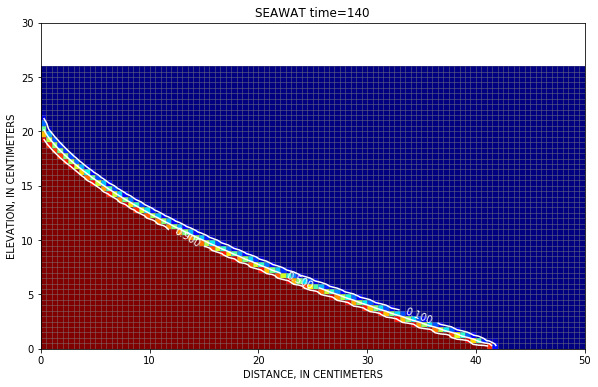

In [162]:
itime = 4
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
xs.plot_grid(linewidths=0.5, alpha=0.5)
xs.plot_array(conc[itime], cmap='jet', vmin=0, vmax=0.0371)
#xs.plot_specific_discharge(splist[0], color='white')
cs = xs.contour_array(conc[itime] / 0.0371, levels=[0.1, .5, .9], colors='white')
ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)
if plot_title:
    ax.set_title('SEAWAT time={}'.format(printtimes[itime]))

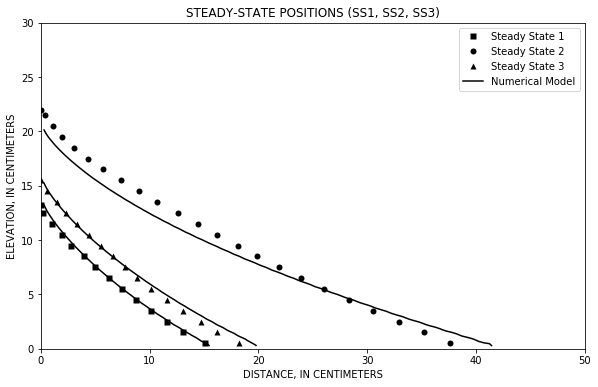

In [163]:
# Figure 5 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[0] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[4] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[8] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ss1x, ss1z, marker='s', mfc='k', mec='none', linestyle='none', label='Steady State 1')[0]
h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
h3 = plt.plot(ss3x, ss3z, marker='^', mfc='k', mec='none', linestyle='none', label='Steady State 3')[0]

black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('STEADY-STATE POSITIONS (SS1, SS2, SS3)')

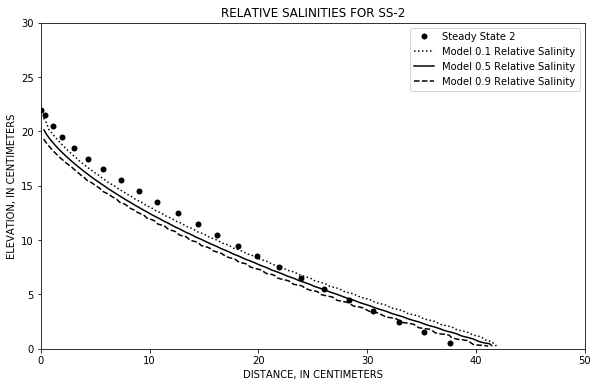

In [164]:
# Figure 6 from Goswami and Clement (2007)
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[4] / 0.0371, levels=[0.1, .5, .9], linestyles = [':', '-', '--'], colors='k')

h2 = plt.plot(ss2x, ss2z, marker='o', mfc='k', mec='none', linestyle='none', label='Steady State 2')[0]
dot_line = mlines.Line2D([], [], linestyle=':', color='black', label='Model 0.1 Relative Salinity')
black_line = mlines.Line2D([], [], color='black', label='Model 0.5 Relative Salinity')
dash_line = mlines.Line2D([], [], linestyle='--', color='black', label='Model 0.9 Relative Salinity')

handles = [h2, dot_line, black_line, dash_line]
labels = [h2.get_label(), dot_line.get_label(), black_line.get_label(), dash_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('RELATIVE SALINITIES FOR SS-2')

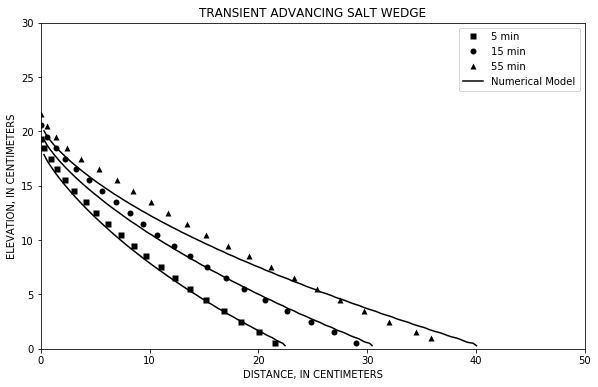

In [165]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[1] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[2] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[3] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(ta5x, ta5z, marker='s', mfc='k', mec='none', linestyle='none', label='5 min')[0]
h2 = plt.plot(ta15x, ta15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(ta55x, ta55z, marker='^', mfc='k', mec='none', linestyle='none', label='55 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT ADVANCING SALT WEDGE')

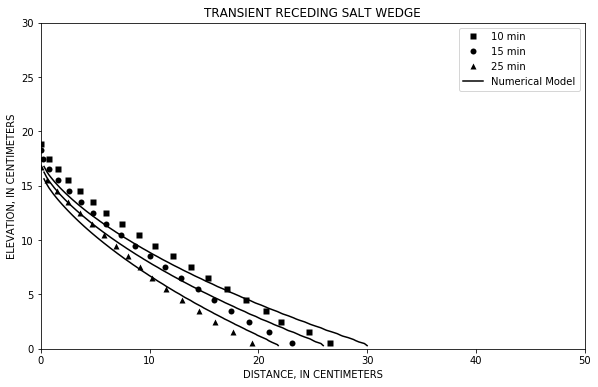

In [166]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(1, 1, 1, aspect='equal')
xs = flopy.plot.PlotCrossSection(swt, line={'row': 0})
if plot_grid:
    xs.plot_grid(linewidths=0.5, alpha=0.5)

cs = xs.contour_array(conc[5] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[6] / 0.0371, levels=levels, colors='k')
cs = xs.contour_array(conc[7] / 0.0371, levels=levels, colors='k')

h1 = plt.plot(tr10x, tr10z, marker='s', mfc='k', mec='none', linestyle='none', label='10 min')[0]
h2 = plt.plot(tr15x, tr15z, marker='o', mfc='k', mec='none', linestyle='none', label='15 min')[0]
h3 = plt.plot(tr25x, tr25z, marker='^', mfc='k', mec='none', linestyle='none', label='25 min')[0]
black_line = mlines.Line2D([], [], color='black', label='Numerical Model')
handles = [h1, h2, h3, black_line]
labels = [h1.get_label(), h2.get_label(), h3.get_label(), black_line.get_label()]
plt.legend(handles, labels)

ax.set_xlim(0, 50.)
ax.set_ylim(0, 30.)

#ax.clabel(cs)
ax.set_xlabel(xlabel)
ax.set_ylabel(ylabel)
if plot_title:
    ax.set_title('TRANSIENT RECEDING SALT WEDGE')